In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

pd.set_option('display.max_columns',None)

In [3]:
dataset=pd.read_csv('./black-friday-sales-prediction/train.csv')
dataset.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,NaN,NaN,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,6.0,14.0,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,NaN,NaN,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,14.0,NaN,1057
4,1000002,P00285442,M,55+,16,C,4+,0,8,NaN,NaN,7969


In [5]:
dataset.shape

(550068, 12)

## in EDA, Data analysis, we analyse the following:
1. missing values
2. numerical variables 
3. distribution of numerical variables
4. categorical variables 
5. outliers
6. relationship between independent variables and dependent variables
7. correlations

## 1. Missing Values

In [7]:
dataset.isnull()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
0,False,False,False,False,False,False,False,False,False,True,True,False
1,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,True,True,False
3,False,False,False,False,False,False,False,False,False,False,True,False
4,False,False,False,False,False,False,False,False,False,True,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...
550063,False,False,False,False,False,False,False,False,False,True,True,False
550064,False,False,False,False,False,False,False,False,False,True,True,False
550065,False,False,False,False,False,False,False,False,False,True,True,False
550066,False,False,False,False,False,False,False,False,False,True,True,False


In [13]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 550068 entries, 0 to 550067
Data columns (total 12 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   User_ID                     550068 non-null  int64  
 1   Product_ID                  550068 non-null  object 
 2   Gender                      550068 non-null  object 
 3   Age                         550068 non-null  object 
 4   Occupation                  550068 non-null  int64  
 5   City_Category               550068 non-null  object 
 6   Stay_In_Current_City_Years  550068 non-null  object 
 7   Marital_Status              550068 non-null  int64  
 8   Product_Category_1          550068 non-null  int64  
 9   Product_Category_2          376430 non-null  float64
 10  Product_Category_3          166821 non-null  float64
 11  Purchase                    550068 non-null  int64  
dtypes: float64(2), int64(5), object(5)
memory usage: 50.4+ MB


In [10]:
dataset.columns

Index(['User_ID', 'Product_ID', 'Gender', 'Age', 'Occupation', 'City_Category',
       'Stay_In_Current_City_Years', 'Marital_Status', 'Product_Category_1',
       'Product_Category_2', 'Product_Category_3', 'Purchase'],
      dtype='object')

In [19]:
dataset['User_ID'].isnull().sum()>1

False

In [20]:
features_with_na=[feature for feature in dataset.columns if dataset[feature].isnull().sum()>1]
features_with_na

['Product_Category_2', 'Product_Category_3']

In [21]:
dataset['Product_Category_2'].isnull().sum()

173638

In [22]:
dataset['Product_Category_3'].isnull().sum()

383247

### percentage of missing values in features_with_na

In [31]:
### percentage of missing values in features_with_na
for feature in features_with_na:
#     print(dataset[feature].isnull().mean())
    print(feature,np.round(dataset[feature].isnull().mean(),4)*100,"is the percentage of null values")

Product_Category_2 31.569999999999997 is the percentage of null values
Product_Category_3 69.67 is the percentage of null values


## find the relationship between the missing values and PurchasePrice

In [32]:
dataset['Product_Category_2']

0          NaN
1          6.0
2          NaN
3         14.0
4          NaN
          ... 
550063     NaN
550064     NaN
550065     NaN
550066     NaN
550067     NaN
Name: Product_Category_2, Length: 550068, dtype: float64

In [38]:
dataset.groupby('Product_Category_2').apply(print)

        User_ID Product_ID Gender    Age  Occupation City_Category  \
5       1000003  P00193542      M  26-35          15             A   
13      1000005  P00145042      M  26-35          20             A   
39      1000010  P00221342      F  36-45           1             B   
48      1000011  P00110842      F  26-35           1             C   
64      1000015  P00042142      M  26-35           7             A   
...         ...        ...    ...    ...         ...           ...   
545841  1006031  P00127842      F  18-25           0             C   
545887  1006036  P00127742      F  26-35          15             B   
545890  1006036  P00244142      F  26-35          15             B   
545908  1006040  P00127642      M  26-35           6             B   
545914  1006040  P00217442      M  26-35           6             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
5                               3               0                   1   
13           

""


In [40]:
dataset.groupby('Product_Category_2')['Purchase'].apply(print)

5         15227
13        15665
39        15705
48        19327
64        11458
          ...  
545841    19579
545887    11398
545890     7846
545908    15694
545914    11640
Name: 2.0, Length: 49217, dtype: int64
16        13055
77        15985
665        3688
895       12828
1349       3406
          ...  
545374    16236
545427    15973
545610    16494
545845    10016
545907     3425
Name: 3.0, Length: 2884, dtype: int64
29        16352
33        10946
36        12909
43        16406
71        10754
          ...  
545689     6521
545700     8400
545879     8431
545884    10140
545902     8047
Name: 4.0, Length: 25677, dtype: int64
15         2079
19        19614
54        12107
80          697
90        11023
          ...  
545752     2134
545755    11490
545854     8181
545889     7830
545898     2153
Name: 5.0, Length: 26235, dtype: int64
1         15200
46        11562
50        15246
67        15872
81         7030
          ...  
545803    19637
545804    12092
545806    117

Product_Category_2
2.0     None
3.0     None
4.0     None
5.0     None
6.0     None
7.0     None
8.0     None
9.0     None
10.0    None
11.0    None
12.0    None
13.0    None
14.0    None
15.0    None
16.0    None
17.0    None
18.0    None
Name: Purchase, dtype: object

C:\Users\HP\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='Purchase'>

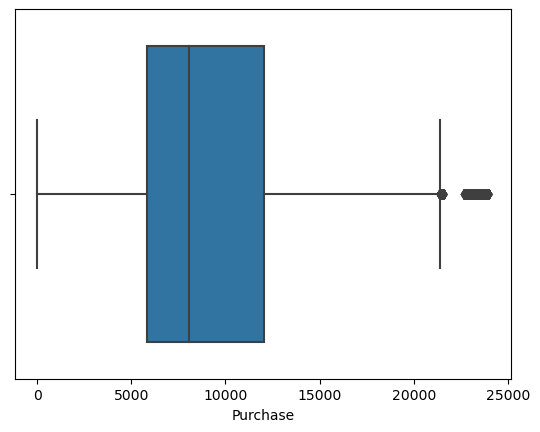

In [43]:
sns.boxplot(dataset['Purchase'])

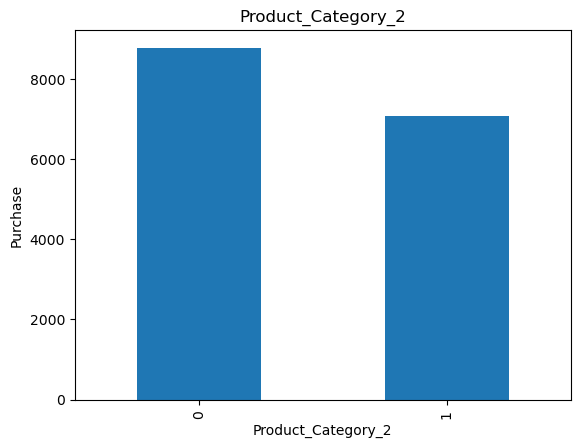

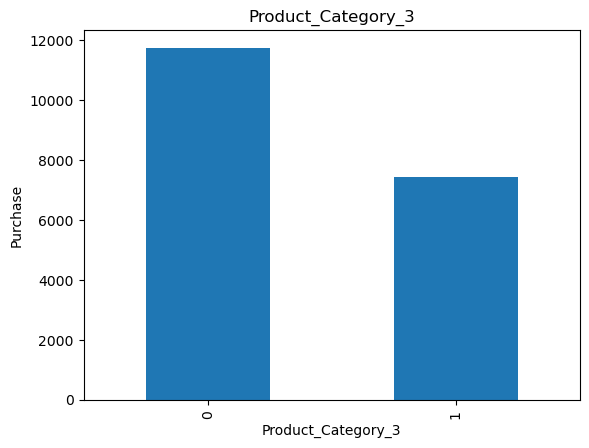

In [45]:
data=dataset.copy()
for feature in features_with_na:
    data[feature]=np.where(data[feature].isnull(),1,0)
    data.groupby(feature)['Purchase'].median().plot.bar()
    plt.xlabel(feature)
    plt.ylabel('Purchase')
    plt.title(feature)
    plt.show()

### observation
- there are significant missing values and there is a significat relationship between missing values and Purchase, so we cant ignore them, we have to replace them
- we will replace them in Feature Engineering

# 2. Numerical Variables

In [48]:
dataset.dtypes

User_ID                         int64
Product_ID                     object
Gender                         object
Age                            object
Occupation                      int64
City_Category                  object
Stay_In_Current_City_Years     object
Marital_Status                  int64
Product_Category_1              int64
Product_Category_2            float64
Product_Category_3            float64
Purchase                        int64
dtype: object

In [49]:
dataset.dtypes=='O'

User_ID                       False
Product_ID                     True
Gender                         True
Age                            True
Occupation                    False
City_Category                  True
Stay_In_Current_City_Years     True
Marital_Status                False
Product_Category_1            False
Product_Category_2            False
Product_Category_3            False
Purchase                      False
dtype: bool

In [50]:
data=dataset.copy()
numerical_variables=[feature for feature in data if data[feature].dtypes!='O']
numerical_variables

['User_ID',
 'Occupation',
 'Marital_Status',
 'Product_Category_1',
 'Product_Category_2',
 'Product_Category_3',
 'Purchase']

In [51]:
dataset[numerical_variables]

,User_ID,Occupation,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
0,1000001,10,0,3,NaN,NaN,8370
1,1000001,10,0,1,6.0,14.0,15200
2,1000001,10,0,12,NaN,NaN,1422
3,1000001,10,0,12,14.0,NaN,1057
4,1000002,16,0,8,NaN,NaN,7969
...,...,...,...,...,...,...,...
550063,1006033,13,1,20,NaN,NaN,368
550064,1006035,1,0,20,NaN,NaN,371
550065,1006036,15,1,20,NaN,NaN,137
550066,1006038,1,0,20,NaN,NaN,365


In [52]:
dataset.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
0,1000001,P00069042,F,0-17,10,A,2,0,3,NaN,NaN,8370
1,1000001,P00248942,F,0-17,10,A,2,0,1,6.0,14.0,15200
2,1000001,P00087842,F,0-17,10,A,2,0,12,NaN,NaN,1422
3,1000001,P00085442,F,0-17,10,A,2,0,12,14.0,NaN,1057
4,1000002,P00285442,M,55+,16,C,4+,0,8,NaN,NaN,7969


## Date Time Variables

In [53]:
## Date Time Variables
datetime_variables=[feature for feature in dataset if 'Year' in feature or 'Age' in feature ]
datetime_variables

['Age', 'Stay_In_Current_City_Years']

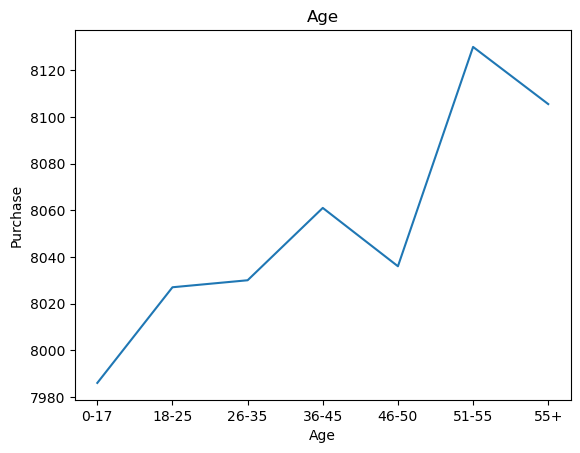

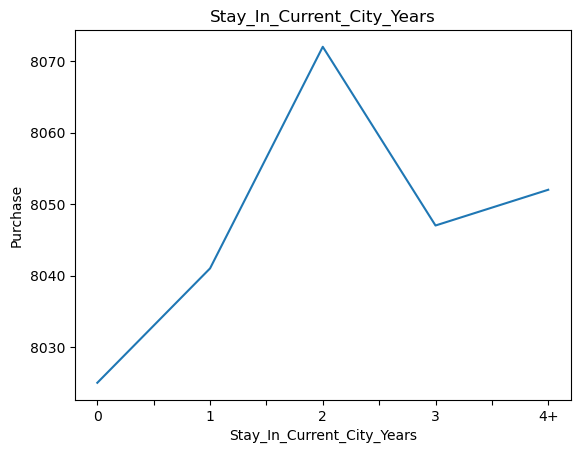

In [56]:
data=dataset.copy()
for feature in datetime_variables:
    data.groupby(feature)['Purchase'].median().plot()
    plt.xlabel(feature)
    plt.ylabel('Purchase')
    plt.title(feature)
    plt.show()

### observation
- the purchase price increased as the age grew till 36-45
- there is a decline in purchase in 46-50
- there is a sudden increase in purchase in 51-55
- there is a sudden decrease in purchase in 55+

- as the people stayed, till 2 years, the purchase is high,
- people who stayed till 3 years, purchase had a sudden decrease
- people who stayed 4 or more years, purchase has a sudden increase

## 3. Distribution of numerical variables
### 3.1 discrete
### 3.2 continuous 

In [57]:
## 3.1 Discrete Features
data=dataset.copy()
discrete_features = [feature for feature in data if len(data[feature].unique())<=25 ]
discrete_features

['Gender',
 'Age',
 'Occupation',
 'City_Category',
 'Stay_In_Current_City_Years',
 'Marital_Status',
 'Product_Category_1',
 'Product_Category_2',
 'Product_Category_3']

In [58]:
data[discrete_features]

,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3
0,F,0-17,10,A,2,0,3,NaN,NaN
1,F,0-17,10,A,2,0,1,6.0,14.0
2,F,0-17,10,A,2,0,12,NaN,NaN
3,F,0-17,10,A,2,0,12,14.0,NaN
4,M,55+,16,C,4+,0,8,NaN,NaN
...,...,...,...,...,...,...,...,...,...
550063,M,51-55,13,B,1,1,20,NaN,NaN
550064,F,26-35,1,C,3,0,20,NaN,NaN
550065,F,26-35,15,B,4+,1,20,NaN,NaN
550066,F,55+,1,C,2,0,20,NaN,NaN


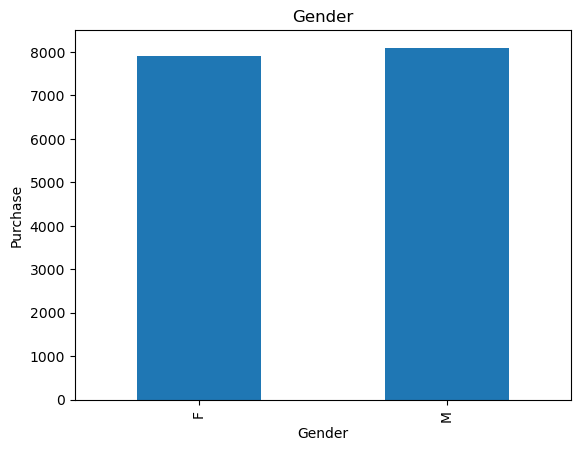

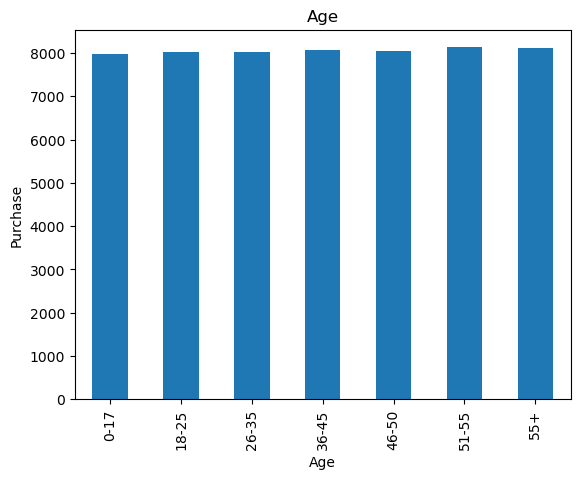

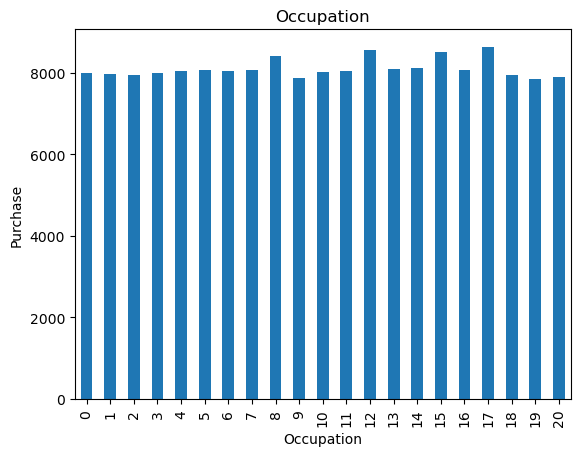

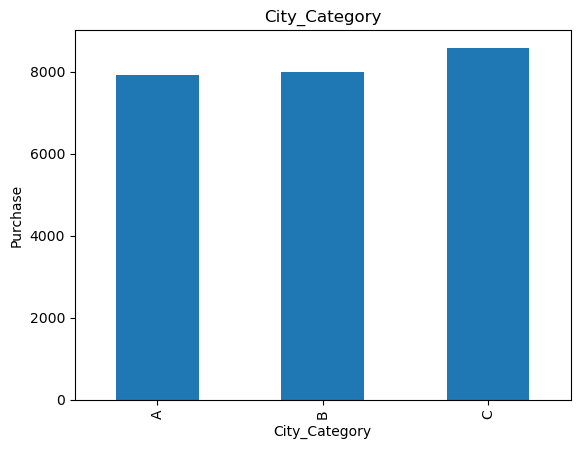

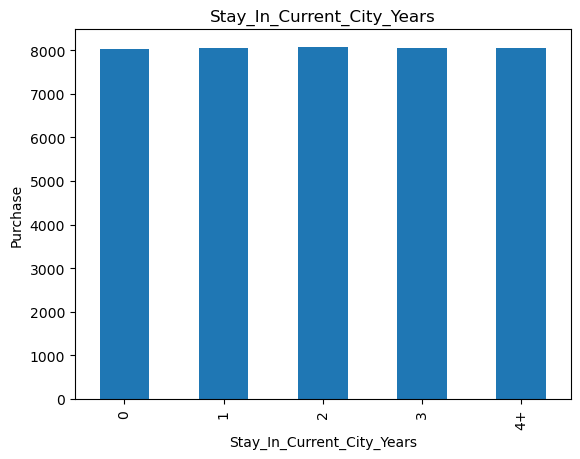

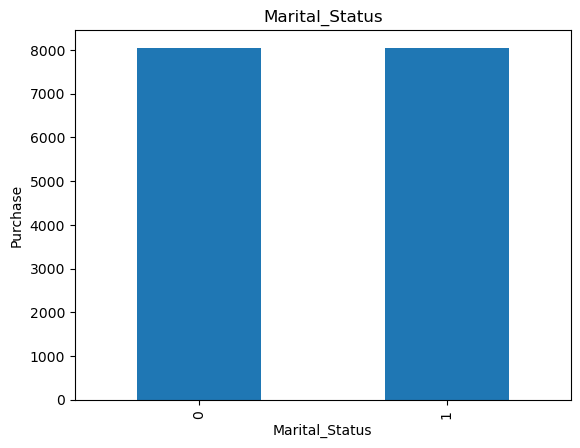

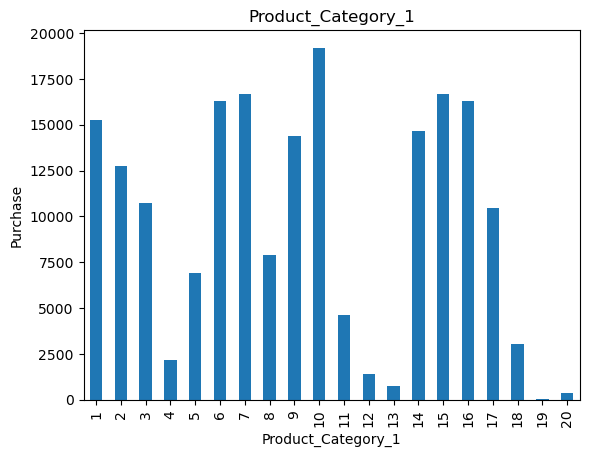

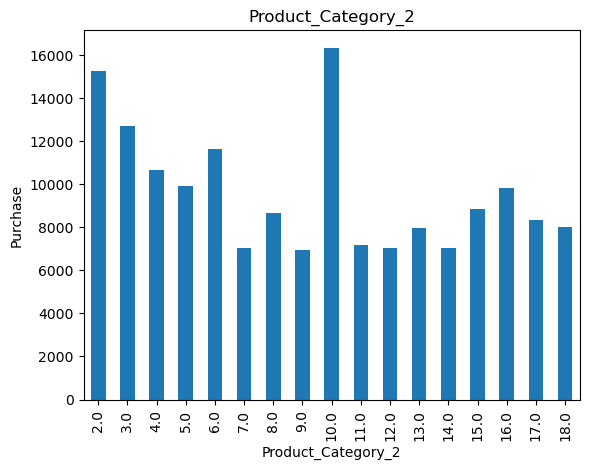

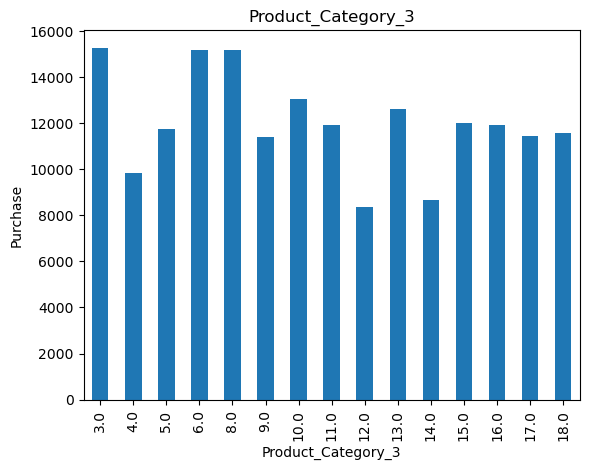

In [60]:
data=dataset.copy()
for feature in discrete_features:
    data.groupby(feature)['Purchase'].median().plot.bar()
    plt.xlabel(feature)
    plt.ylabel('Purchase')
    plt.title(feature)
    plt.show()

### observation
- both the genders have same purchase price
- all the age groups have same purchase price
- all the occupation have same purchase price
- C > B > A is the order of purchase price
- stay in current years, everyone has same purchase price
- people who are married and unmarried have same purcahse price
- product_category_1 -10 has the highest purchase price,19 ->lowest
- product_category_2 - 10 has the highest purchase price,18->lowest
- product_category_3 -3,6,8 has highest purchase price,12->lowest

### 3.2 continuous features

In [61]:
### 3.2 continuous features
data=dataset.copy()
continuous_variables = [feature for feature in data if feature not in discrete_features]
continuous_variables

['User_ID', 'Product_ID', 'Purchase']

In [69]:
data[continuous_variables].dtypes

User_ID       float64
Product_ID     object
Purchase        int64
dtype: object

In [65]:
data.groupby('User_ID').apply(print)

        User_ID Product_ID Gender   Age  Occupation City_Category  \
0       1000001  P00069042      F  0-17          10             A   
1       1000001  P00248942      F  0-17          10             A   
2       1000001  P00087842      F  0-17          10             A   
3       1000001  P00085442      F  0-17          10             A   
39180   1000001  P00085942      F  0-17          10             A   
78144   1000001  P00102642      F  0-17          10             A   
78145   1000001  P00110842      F  0-17          10             A   
78146   1000001  P00004842      F  0-17          10             A   
116848  1000001  P00117942      F  0-17          10             A   
116849  1000001  P00258742      F  0-17          10             A   
116850  1000001  P00142242      F  0-17          10             A   
116851  1000001  P00000142      F  0-17          10             A   
155570  1000001  P00297042      F  0-17          10             A   
155571  1000001  P00059442      F 

        User_ID Product_ID Gender    Age  Occupation City_Category  \
56      1000015  P00334242      M  26-35           7             A   
57      1000015  P00247542      M  26-35           7             A   
58      1000015  P00338442      M  26-35           7             A   
59      1000015  P00275142      M  26-35           7             A   
60      1000015  P00333042      M  26-35           7             A   
...         ...        ...    ...    ...         ...           ...   
506658  1000015  P00004742      M  26-35           7             A   
506659  1000015  P00026042      M  26-35           7             A   
506660  1000015  P00138542      M  26-35           7             A   
506661  1000015  P00025442      M  26-35           7             A   
545924  1000015  P00375436      M  26-35           7             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
56                              1               0                   1   
57           

        User_ID Product_ID Gender    Age  Occupation City_Category  \
163     1000032  P00332342      F  26-35           0             C   
78314   1000032  P00024142      F  26-35           0             C   
78315   1000032  P00154742      F  26-35           0             C   
78316   1000032  P00165742      F  26-35           0             C   
117012  1000032  P00177742      F  26-35           0             C   
117013  1000032  P00354442      F  26-35           0             C   
117014  1000032  P00046142      F  26-35           0             C   
155753  1000032  P00250342      F  26-35           0             C   
194721  1000032  P00148642      F  26-35           0             C   
272990  1000032  P00053842      F  26-35           0             C   
272991  1000032  P00059442      F  26-35           0             C   
272992  1000032  P00124642      F  26-35           0             C   
350981  1000032  P00319842      F  26-35           0             C   
350982  1000032  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
304     1000053  P00117542      M  26-35           0             B   
305     1000053  P00120342      M  26-35           0             B   
306     1000053  P00130742      M  26-35           0             B   
307     1000053  P00024142      M  26-35           0             B   
308     1000053  P00127242      M  26-35           0             B   
...         ...        ...    ...    ...         ...           ...   
506916  1000053  P00112242      M  26-35           0             B   
506917  1000053  P00029442      M  26-35           0             B   
506918  1000053  P00033242      M  26-35           0             B   
506919  1000053  P00136542      M  26-35           0             B   
506920  1000053  P00155642      M  26-35           0             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
304                             1               0                  18   
305          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
406     1000069  P00184942      F  26-35           1             A   
407     1000069  P00041542      F  26-35           1             A   
39580   1000069  P00151742      F  26-35           1             A   
78537   1000069  P00172542      F  26-35           1             A   
78538   1000069  P00001742      F  26-35           1             A   
78539   1000069  P00001442      F  26-35           1             A   
117231  1000069  P00110742      F  26-35           1             A   
117232  1000069  P00058042      F  26-35           1             A   
117233  1000069  P00028842      F  26-35           1             A   
117234  1000069  P00156442      F  26-35           1             A   
117235  1000069  P00031342      F  26-35           1             A   
155963  1000069  P00034742      F  26-35           1             A   
194956  1000069  P00153742      F  26-35           1             A   
194957  1000069  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
457     1000083  P00105142      F  26-35           2             C   
458     1000083  P00251242      F  26-35           2             C   
459     1000083  P00183442      F  26-35           2             C   
460     1000083  P00199442      F  26-35           2             C   
461     1000083  P00054542      F  26-35           2             C   
39627   1000083  P00232542      F  26-35           2             C   
39628   1000083  P00223242      F  26-35           2             C   
39629   1000083  P00255942      F  26-35           2             C   
78585   1000083  P00110742      F  26-35           2             C   
78586   1000083  P00117942      F  26-35           2             C   
78587   1000083  P00274142      F  26-35           2             C   
78588   1000083  P00276542      F  26-35           2             C   
78589   1000083  P00217742      F  26-35           2             C   
78590   1000083  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
39702   1000104  P00262242      M  26-35          12             C   
39703   1000104  P00217742      M  26-35          12             C   
39704   1000104  P00277642      M  26-35          12             C   
117373  1000104  P00307342      M  26-35          12             C   
156101  1000104  P00209442      M  26-35          12             C   
195091  1000104  P00185842      M  26-35          12             C   
234224  1000104  P00352142      M  26-35          12             C   
234225  1000104  P00256742      M  26-35          12             C   
273326  1000104  P00021742      M  26-35          12             C   
273327  1000104  P00274942      M  26-35          12             C   
273328  1000104  P00236042      M  26-35          12             C   
312251  1000104  P00110542      M  26-35          12             C   
312252  1000104  P00286842      M  26-35          12             C   
312253  1000104  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
623     1000121  P00102042      M  36-45           7             C   
624     1000121  P00059742      M  36-45           7             C   
39768   1000121  P00110942      M  36-45           7             C   
39769   1000121  P00269542      M  36-45           7             C   
39770   1000121  P00192542      M  36-45           7             C   
78752   1000121  P00270942      M  36-45           7             C   
78753   1000121  P00277442      M  36-45           7             C   
78754   1000121  P00217142      M  36-45           7             C   
117436  1000121  P00117442      M  36-45           7             C   
117437  1000121  P00326742      M  36-45           7             C   
117438  1000121  P00100642      M  36-45           7             C   
117439  1000121  P00125942      M  36-45           7             C   
117440  1000121  P00243942      M  36-45           7             C   
117441  1000121  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
39891   1000141  P00111042      M  36-45          13             C   
117567  1000141  P00350942      M  36-45          13             C   
117568  1000141  P00046742      M  36-45          13             C   
156277  1000141  P00355942      M  36-45          13             C   
234416  1000141  P00001742      M  36-45          13             C   
234417  1000141  P00258742      M  36-45          13             C   
273526  1000141  P00197042      M  36-45          13             C   
273527  1000141  P00062842      M  36-45          13             C   
273528  1000141  P00323742      M  36-45          13             C   
312435  1000141  P00089042      M  36-45          13             C   
351519  1000141  P00277442      M  36-45          13             C   
390874  1000141  P00202242      M  36-45          13             C   
429619  1000141  P00157542      M  36-45          13             C   

       Stay_In_Curr

        User_ID Product_ID Gender    Age  Occupation City_Category  \
879     1000156  P00304842      F  46-50           7             C   
880     1000156  P00002542      F  46-50           7             C   
881     1000156  P00240142      F  46-50           7             C   
40014   1000156  P00036842      F  46-50           7             C   
40015   1000156  P00037142      F  46-50           7             C   
...         ...        ...    ...    ...         ...           ...   
507458  1000156  P00047942      F  46-50           7             C   
507459  1000156  P00173342      F  46-50           7             C   
507460  1000156  P00130842      F  46-50           7             C   
507461  1000156  P00102142      F  46-50           7             C   
546017  1000156  P00370293      F  46-50           7             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
879                            4+               1                   8   
880          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
999     1000173  P00084642      M  26-35           0             B   
1000    1000173  P00279142      M  26-35           0             B   
1001    1000173  P00028842      M  26-35           0             B   
1002    1000173  P00256542      M  26-35           0             B   
1003    1000173  P00272042      M  26-35           0             B   
...         ...        ...    ...    ...         ...           ...   
507591  1000173  P00109742      M  26-35           0             B   
507592  1000173  P00118142      M  26-35           0             B   
507593  1000173  P00064742      M  26-35           0             B   
507594  1000173  P00184942      M  26-35           0             B   
546026  1000173  P00372445      M  26-35           0             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
999                             1               1                  13   
1000         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
1092    1000186  P00111142      M  18-25           5             C   
1093    1000186  P00172842      M  18-25           5             C   
1094    1000186  P00262242      M  18-25           5             C   
40197   1000186  P00102642      M  18-25           5             C   
40198   1000186  P00191642      M  18-25           5             C   
40199   1000186  P00289842      M  18-25           5             C   
79186   1000186  P00217242      M  18-25           5             C   
79187   1000186  P00355142      M  18-25           5             C   
79188   1000186  P00332942      M  18-25           5             C   
79189   1000186  P00110842      M  18-25           5             C   
79190   1000186  P00178942      M  18-25           5             C   
79191   1000186  P00139542      M  18-25           5             C   
117887  1000186  P00324842      M  18-25           5             C   
117888  1000186  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
1229    1000201  P00051442      F  36-45           2             A   
1230    1000201  P00126142      F  36-45           2             A   
1231    1000201  P00171542      F  36-45           2             A   
1232    1000201  P00059442      F  36-45           2             A   
1233    1000201  P00177942      F  36-45           2             A   
40343   1000201  P00148442      F  36-45           2             A   
40344   1000201  P00330442      F  36-45           2             A   
40345   1000201  P00036842      F  36-45           2             A   
40346   1000201  P00293242      F  36-45           2             A   
40347   1000201  P00370242      F  36-45           2             A   
79313   1000201  P00214842      F  36-45           2             A   
79314   1000201  P00303742      F  36-45           2             A   
79315   1000201  P00157542      F  36-45           2             A   
79316   1000201  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
1364    1000219  P00351342      F  26-35           4             A   
1365    1000219  P00361842      F  26-35           4             A   
79426   1000219  P00258842      F  26-35           4             A   
156878  1000219  P00324942      F  26-35           4             A   
156879  1000219  P00366542      F  26-35           4             A   
156880  1000219  P00255942      F  26-35           4             A   
195844  1000219  P00303042      F  26-35           4             A   
195845  1000219  P00224142      F  26-35           4             A   
234962  1000219  P00074342      F  26-35           4             A   
274076  1000219  P00251442      F  26-35           4             A   
274077  1000219  P00248542      F  26-35           4             A   
312977  1000219  P00317842      F  26-35           4             A   
312978  1000219  P00279442      F  26-35           4             A   
352121  1000219  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
1434    1000233  P00194542      F  46-50          20             C   
1435    1000233   P0096442      F  46-50          20             C   
40529   1000233  P00085442      F  46-50          20             C   
40530   1000233  P00176842      F  46-50          20             C   
40531   1000233  P00230842      F  46-50          20             C   
118211  1000233  P00112142      F  46-50          20             C   
118212  1000233  P00303642      F  46-50          20             C   
118213  1000233  P00014542      F  46-50          20             C   
118214  1000233  P00057742      F  46-50          20             C   
156936  1000233  P00090942      F  46-50          20             C   
195919  1000233  P00351142      F  46-50          20             C   
274141  1000233  P00157542      F  46-50          20             C   
274142  1000233   P0096842      F  46-50          20             C   
274143  1000233  P00

        User_ID Product_ID Gender  Age  Occupation City_Category  \
1559    1000251  P00117542      M  55+          17             A   
1560    1000251  P00128142      M  55+          17             A   
40651   1000251  P00117942      M  55+          17             A   
40652   1000251  P00368142      M  55+          17             A   
40653   1000251  P00159542      M  55+          17             A   
79593   1000251  P00036842      M  55+          17             A   
118318  1000251  P00046142      M  55+          17             A   
118319  1000251   P0098242      M  55+          17             A   
157042  1000251  P00121642      M  55+          17             A   
157043  1000251  P00271142      M  55+          17             A   
157044  1000251  P00152742      M  55+          17             A   
157045  1000251  P00002142      M  55+          17             A   
196013  1000251  P00251242      M  55+          17             A   
196014  1000251  P00073842      M  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
1652    1000265  P00135742      F  36-45           7             A   
1653    1000265  P00273442      F  36-45           7             A   
40734   1000265  P00110542      F  36-45           7             A   
79677   1000265  P00027142      F  36-45           7             A   
79678   1000265  P00284742      F  36-45           7             A   
79679   1000265  P00110842      F  36-45           7             A   
79680   1000265  P00102342      F  36-45           7             A   
118418  1000265  P00144042      F  36-45           7             A   
118419  1000265   P0097142      F  36-45           7             A   
118420  1000265  P00113142      F  36-45           7             A   
157125  1000265  P00137642      F  36-45           7             A   
157126  1000265  P00294442      F  36-45           7             A   
157127  1000265  P00003942      F  36-45           7             A   
196108  1000265  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
1744    1000284  P00195942      M  26-35          12             B   
1745    1000284  P00251242      M  26-35          12             B   
1746    1000284  P00115542      M  26-35          12             B   
1747    1000284  P00219242      M  26-35          12             B   
1748    1000284   P0095842      M  26-35          12             B   
...         ...        ...    ...    ...         ...           ...   
508285  1000284  P00180642      M  26-35          12             B   
508286  1000284  P00320842      M  26-35          12             B   
508287  1000284  P00142942      M  26-35          12             B   
508288  1000284  P00201542      M  26-35          12             B   
508289  1000284  P00251442      M  26-35          12             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
1744                            3               1                   3   
1745         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
1892    1000303  P00005742      M  26-35           7             C   
1893    1000303  P00032842      M  26-35           7             C   
1894    1000303  P00117742      M  26-35           7             C   
1895    1000303  P00044142      M  26-35           7             C   
1896    1000303  P00001142      M  26-35           7             C   
...         ...        ...    ...    ...         ...           ...   
508392  1000303  P00309142      M  26-35           7             C   
508393  1000303  P00205942      M  26-35           7             C   
508394  1000303  P00240442      M  26-35           7             C   
508395  1000303  P00108442      M  26-35           7             C   
546121  1000303  P00370293      M  26-35           7             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
1892                            1               1                   8   
1893         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
2008    1000321  P00003242      M  18-25           4             B   
2009    1000321  P00113342      M  18-25           4             B   
2010    1000321  P00149142      M  18-25           4             B   
2011    1000321  P00214642      M  18-25           4             B   
2012    1000321  P00100442      M  18-25           4             B   
...         ...        ...    ...    ...         ...           ...   
508506  1000321  P00150942      M  18-25           4             B   
508507  1000321  P00157142      M  18-25           4             B   
508508  1000321  P00213642      M  18-25           4             B   
508509  1000321  P00280442      M  18-25           4             B   
508510  1000321  P00151142      M  18-25           4             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
2008                            3               0                   8   
2009         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
2125    1000333  P00117842      M  36-45           2             A   
2126    1000333  P00058142      M  36-45           2             A   
2127    1000333  P00279942      M  36-45           2             A   
2128    1000333  P00331542      M  36-45           2             A   
2129    1000333  P00109842      M  36-45           2             A   
...         ...        ...    ...    ...         ...           ...   
508627  1000333  P00195042      M  36-45           2             A   
508628  1000333  P00223842      M  36-45           2             A   
508629  1000333  P00053842      M  36-45           2             A   
508630  1000333  P00193042      M  36-45           2             A   
546137  1000333  P00372445      M  36-45           2             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
2125                            0               1                   5   
2126         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
2208    1000345  P00080342      M  26-35          12             A   
2209    1000345  P00265242      M  26-35          12             A   
41263   1000345  P00112142      M  26-35          12             A   
41264   1000345  P00113242      M  26-35          12             A   
80212   1000345  P00009242      M  26-35          12             A   
235698  1000345  P00010842      M  26-35          12             A   
235699  1000345  P00112442      M  26-35          12             A   
313771  1000345  P00365242      M  26-35          12             A   
313772  1000345  P00156442      M  26-35          12             A   
352915  1000345  P00198542      M  26-35          12             A   
431062  1000345  P00115642      M  26-35          12             A   
431063  1000345  P00217042      M  26-35          12             A   
469684  1000345  P00270242      M  26-35          12             A   
469685  1000345  P00

        User_ID Product_ID Gender  Age  Occupation City_Category  \
2322    1000356  P00326742      M  55+          20             C   
41364   1000356  P00161142      M  55+          20             C   
80314   1000356  P00005942      M  55+          20             C   
196747  1000356  P00231242      M  55+          20             C   
235787  1000356  P00024742      M  55+          20             C   
313882  1000356  P00241642      M  55+          20             C   
353007  1000356  P00368142      M  55+          20             C   
353008  1000356  P00247542      M  55+          20             C   
392289  1000356  P00155442      M  55+          20             C   
392290  1000356  P00295942      M  55+          20             C   
431157  1000356  P00194142      M  55+          20             C   
469774  1000356  P00181842      M  55+          20             C   
546159  1000356  P00370293      M  55+          20             C   

       Stay_In_Current_City_Years  Marital_Stat

        User_ID Product_ID Gender    Age  Occupation City_Category  \
2365    1000372  P00148442      F  18-25           4             C   
2366    1000372  P00250242      F  18-25           4             C   
2367    1000372  P00157642      F  18-25           4             C   
2368    1000372  P00229742      F  18-25           4             C   
2369    1000372  P00222042      F  18-25           4             C   
...         ...        ...    ...    ...         ...           ...   
469839  1000372  P00284142      F  18-25           4             C   
508849  1000372  P00173842      F  18-25           4             C   
508850  1000372  P00142142      F  18-25           4             C   
508851  1000372  P00130742      F  18-25           4             C   
508852  1000372  P00214442      F  18-25           4             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
2365                            2               0                   2   
2366         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
2405    1000384  P00111242      M  26-35          11             B   
41440   1000384  P00274042      M  26-35          11             B   
41441   1000384  P00128342      M  26-35          11             B   
41442   1000384  P00325542      M  26-35          11             B   
80391   1000384  P00274442      M  26-35          11             B   
119123  1000384  P00065242      M  26-35          11             B   
235878  1000384  P00343042      M  26-35          11             B   
275014  1000384  P00269042      M  26-35          11             B   
353088  1000384  P00111842      M  26-35          11             B   
353089  1000384  P00058642      M  26-35          11             B   
392368  1000384  P00327642      M  26-35          11             B   
392369  1000384  P00326242      M  26-35          11             B   
431248  1000384  P00110842      M  26-35          11             B   
431249  1000384  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
2476    1000399  P00216342      F  36-45           6             B   
2477    1000399  P00255742      F  36-45           6             B   
2478    1000399  P00237842      F  36-45           6             B   
2479    1000399  P00300042      F  36-45           6             B   
80478   1000399  P00295942      F  36-45           6             B   
80479   1000399  P00289942      F  36-45           6             B   
119201  1000399  P00255842      F  36-45           6             B   
314030  1000399  P00294242      F  36-45           6             B   
353169  1000399  P00187942      F  36-45           6             B   
353170  1000399  P00265242      F  36-45           6             B   
431329  1000399  P00220342      F  36-45           6             B   
469940  1000399  P00285842      F  36-45           6             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
2476            

        User_ID Product_ID Gender    Age  Occupation City_Category  \
2587    1000413  P00001742      M  26-35          11             C   
2588    1000413   P0099342      M  26-35          11             C   
2589    1000413  P00260042      M  26-35          11             C   
2590    1000413  P00121142      M  26-35          11             C   
2591    1000413  P00338442      M  26-35          11             C   
2592    1000413  P00216342      M  26-35          11             C   
41647   1000413  P00004542      M  26-35          11             C   
41648   1000413  P00214442      M  26-35          11             C   
41649   1000413  P00212242      M  26-35          11             C   
41650   1000413  P00216042      M  26-35          11             C   
80578   1000413  P00103042      M  26-35          11             C   
80579   1000413  P00078142      M  26-35          11             C   
119315  1000413  P00184942      M  26-35          11             C   
119316  1000413  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
2619    1000424  P00246142      M  26-35          17             A   
2620    1000424  P00352842      M  26-35          17             A   
2621    1000424  P00177142      M  26-35          17             A   
2622    1000424  P00350142      M  26-35          17             A   
2623    1000424  P00126142      M  26-35          17             A   
...         ...        ...    ...    ...         ...           ...   
509114  1000424  P00278442      M  26-35          17             A   
509115  1000424  P00155642      M  26-35          17             A   
509116  1000424  P00004242      M  26-35          17             A   
509117  1000424  P00328942      M  26-35          17             A   
509118  1000424  P00109842      M  26-35          17             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
2619                            3               0                   1   
2620         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
41818   1000441  P00237542      M  36-45           1             B   
41819   1000441  P00346142      M  36-45           1             B   
41820   1000441  P00368142      M  36-45           1             B   
80750   1000441  P00025442      M  36-45           1             B   
80751   1000441  P00086442      M  36-45           1             B   
80752   1000441  P00102642      M  36-45           1             B   
80753   1000441  P00058042      M  36-45           1             B   
119483  1000441  P00046742      M  36-45           1             B   
119484  1000441  P00057642      M  36-45           1             B   
119485  1000441  P00187442      M  36-45           1             B   
119486  1000441   P0097242      M  36-45           1             B   
158171  1000441  P00144642      M  36-45           1             B   
158172  1000441  P00183042      M  36-45           1             B   
158173  1000441  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
2851    1000459  P00265242      F  18-25           4             A   
41921   1000459  P00370242      F  18-25           4             A   
158284  1000459  P00238542      F  18-25           4             A   
275475  1000459  P00250242      F  18-25           4             A   
275476  1000459  P00255942      F  18-25           4             A   
314402  1000459  P00220242      F  18-25           4             A   
353542  1000459  P00177342      F  18-25           4             A   
353543  1000459  P00205242      F  18-25           4             A   
431712  1000459  P00279342      F  18-25           4             A   
431713  1000459  P00306042      F  18-25           4             A   
470319  1000459  P00214442      F  18-25           4             A   
470320  1000459  P00255842      F  18-25           4             A   
470321  1000459  P00252042      F  18-25           4             A   
509309  1000459  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
2959    1000479  P00003442      M  26-35          12             C   
42021   1000479  P00117942      M  26-35          12             C   
42022   1000479  P00112142      M  26-35          12             C   
42023   1000479  P00193542      M  26-35          12             C   
42024   1000479  P00142942      M  26-35          12             C   
80945   1000479  P00000142      M  26-35          12             C   
80946   1000479  P00152742      M  26-35          12             C   
80947   1000479  P00199442      M  26-35          12             C   
119699  1000479  P00331942      M  26-35          12             C   
119700  1000479  P00051442      M  26-35          12             C   
119701  1000479  P00178342      M  26-35          12             C   
158386  1000479  P00178942      M  26-35          12             C   
158387  1000479  P00303042      M  26-35          12             C   
158388  1000479  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
42102   1000495  P00103042      M  18-25          10             A   
42103   1000495  P00321742      M  18-25          10             A   
81006   1000495  P00242742      M  18-25          10             A   
81007   1000495  P00145042      M  18-25          10             A   
81008   1000495  P00355142      M  18-25          10             A   
119769  1000495  P00187742      M  18-25          10             A   
158456  1000495  P00268442      M  18-25          10             A   
158457  1000495  P00216342      M  18-25          10             A   
158458  1000495   P0095742      M  18-25          10             A   
197475  1000495  P00147942      M  18-25          10             A   
236543  1000495  P00110742      M  18-25          10             A   
236544  1000495  P00051442      M  18-25          10             A   
275645  1000495  P00142142      M  18-25          10             A   
275646  1000495  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
3119    1000514  P00021742      M  26-35           2             A   
42225   1000514  P00256642      M  26-35           2             A   
81085   1000514  P00265242      M  26-35           2             A   
81086   1000514  P00238442      M  26-35           2             A   
81087   1000514  P00305042      M  26-35           2             A   
81088   1000514  P00031042      M  26-35           2             A   
81089   1000514  P00330642      M  26-35           2             A   
119846  1000514  P00263542      M  26-35           2             A   
119847  1000514  P00111742      M  26-35           2             A   
119848  1000514  P00102642      M  26-35           2             A   
119849  1000514  P00112642      M  26-35           2             A   
158550  1000514  P00278642      M  26-35           2             A   
158551  1000514  P00216342      M  26-35           2             A   
158552  1000514  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
3268    1000532  P00119142      M  26-35           7             C   
42390   1000532  P00102642      M  26-35           7             C   
81219   1000532  P00312742      M  26-35           7             C   
81220   1000532  P00346242      M  26-35           7             C   
119989  1000532  P00143642      M  26-35           7             C   
119990  1000532  P00025442      M  26-35           7             C   
119991  1000532  P00112542      M  26-35           7             C   
119992  1000532  P00111042      M  26-35           7             C   
158691  1000532  P00114942      M  26-35           7             C   
197740  1000532  P00367942      M  26-35           7             C   
236806  1000532  P00198142      M  26-35           7             C   
275881  1000532  P00110742      M  26-35           7             C   
275882  1000532  P00233542      M  26-35           7             C   
314813  1000532  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
3460    1000552  P00212042      M  51-55          18             C   
3461    1000552  P00264042      M  51-55          18             C   
3462    1000552  P00155442      M  51-55          18             C   
3463    1000552  P00349942      M  51-55          18             C   
3464    1000552  P00123742      M  51-55          18             C   
...         ...        ...    ...    ...         ...           ...   
470912  1000552  P00111042      M  51-55          18             C   
509904  1000552  P00057942      M  51-55          18             C   
509905  1000552  P00013742      M  51-55          18             C   
509906  1000552  P00316442      M  51-55          18             C   
509907  1000552  P00271042      M  51-55          18             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
3460                            3               1                  13   
3461         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
3521    1000567  P00127842      M  36-45          20             C   
3522    1000567  P00346342      M  36-45          20             C   
3523    1000567  P00110942      M  36-45          20             C   
3524    1000567  P00295342      M  36-45          20             C   
3525    1000567  P00044242      M  36-45          20             C   
42672   1000567  P00178242      M  36-45          20             C   
42673   1000567  P00020342      M  36-45          20             C   
81481   1000567  P00266642      M  36-45          20             C   
81482   1000567  P00217742      M  36-45          20             C   
120249  1000567  P00010742      M  36-45          20             C   
120250  1000567  P00345842      M  36-45          20             C   
120251  1000567  P00346142      M  36-45          20             C   
120252  1000567  P00119642      M  36-45          20             C   
120253  1000567  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
3574    1000582  P00265242      M  18-25           4             C   
3575    1000582  P00216342      M  18-25           4             C   
3576    1000582  P00173242      M  18-25           4             C   
3577    1000582  P00223642      M  18-25           4             C   
3578    1000582  P00240142      M  18-25           4             C   
3579    1000582  P00247142      M  18-25           4             C   
42730   1000582  P00323942      M  18-25           4             C   
42731   1000582  P00139542      M  18-25           4             C   
42732   1000582  P00337842      M  18-25           4             C   
81530   1000582  P00250342      M  18-25           4             C   
81531   1000582  P00256842      M  18-25           4             C   
120306  1000582  P00361242      M  18-25           4             C   
120307  1000582  P00289842      M  18-25           4             C   
120308  1000582  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
3676    1000600  P00217742      M  36-45          17             C   
3677    1000600  P00250842      M  36-45          17             C   
42818   1000600  P00250242      M  36-45          17             C   
42819   1000600  P00251242      M  36-45          17             C   
81624   1000600  P00288642      M  36-45          17             C   
120393  1000600  P00277642      M  36-45          17             C   
120394  1000600  P00296042      M  36-45          17             C   
159049  1000600  P00275142      M  36-45          17             C   
198161  1000600  P00265242      M  36-45          17             C   
237191  1000600  P00271042      M  36-45          17             C   
237192  1000600  P00337842      M  36-45          17             C   
471131  1000600  P00248142      M  36-45          17             C   
510084  1000600  P00010242      M  36-45          17             C   
510085  1000600  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
3751    1000619  P00110742      F  18-25           1             B   
3752    1000619  P00259342      F  18-25           1             B   
42903   1000619  P00115342      F  18-25           1             B   
159128  1000619  P00022642      F  18-25           1             B   
198242  1000619  P00265242      F  18-25           1             B   
237258  1000619  P00112142      F  18-25           1             B   
237259  1000619  P00338442      F  18-25           1             B   
276355  1000619  P00278642      F  18-25           1             B   
315300  1000619  P00350942      F  18-25           1             B   
354407  1000619  P00366542      F  18-25           1             B   
354408  1000619  P00106042      F  18-25           1             B   
354409  1000619  P00286842      F  18-25           1             B   
354410  1000619  P00120342      F  18-25           1             B   
393721  1000619  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
3848    1000637  P00014842      M  36-45          12             B   
3849    1000637  P00233742      M  36-45          12             B   
3850    1000637  P00259342      M  36-45          12             B   
3851    1000637  P00124342      M  36-45          12             B   
3852    1000637  P00102642      M  36-45          12             B   
...         ...        ...    ...    ...         ...           ...   
510283  1000637  P00113042      M  36-45          12             B   
510284  1000637  P00110942      M  36-45          12             B   
510285  1000637   P0095342      M  36-45          12             B   
510286  1000637  P00114942      M  36-45          12             B   
546353  1000637  P00370853      M  36-45          12             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
3848                            2               1                   1   
3849         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
3961    1000652  P00309342      M  18-25          20             C   
3962    1000652  P00061142      M  18-25          20             C   
3963    1000652  P00186642      M  18-25          20             C   
43091   1000652  P00019142      M  18-25          20             C   
43092   1000652  P00159542      M  18-25          20             C   
...         ...        ...    ...    ...         ...           ...   
510361  1000652  P00301542      M  18-25          20             C   
510362  1000652  P00293242      M  18-25          20             C   
510363  1000652  P00078142      M  18-25          20             C   
510364  1000652  P00345642      M  18-25          20             C   
510365  1000652  P00142142      M  18-25          20             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
3961                            3               0                  16   
3962         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
4029    1000668  P00042942      F  26-35           3             C   
4030    1000668  P00270942      F  26-35           3             C   
43172   1000668  P00046742      F  26-35           3             C   
43173   1000668  P00019142      F  26-35           3             C   
159392  1000668  P00173842      F  26-35           3             C   
159393  1000668  P00191442      F  26-35           3             C   
198497  1000668  P00044442      F  26-35           3             C   
198498  1000668  P00004742      F  26-35           3             C   
237526  1000668  P00058042      F  26-35           3             C   
276614  1000668  P00249542      F  26-35           3             C   
276615  1000668  P00136842      F  26-35           3             C   
315578  1000668  P00127242      F  26-35           3             C   
315579  1000668  P00147942      F  26-35           3             C   
354663  1000668  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
4211    1000694  P00242742      M  18-25           4             A   
43375   1000694  P00112142      M  18-25           4             A   
82128   1000694  P00274942      M  18-25           4             A   
82129   1000694  P00284042      M  18-25           4             A   
159587  1000694  P00240442      M  18-25           4             A   
237688  1000694  P00048942      M  18-25           4             A   
276806  1000694  P00286642      M  18-25           4             A   
315791  1000694  P00178642      M  18-25           4             A   
315792  1000694  P00250842      M  18-25           4             A   
315793  1000694  P00229342      M  18-25           4             A   
354858  1000694  P00158542      M  18-25           4             A   
354859  1000694  P00234742      M  18-25           4             A   
354860  1000694  P00230942      M  18-25           4             A   
394182  1000694  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
4277    1000710  P00350942      M  26-35          20             A   
4278    1000710  P00312742      M  26-35          20             A   
4279    1000710  P00274542      M  26-35          20             A   
4280    1000710  P00129542      M  26-35          20             A   
4281    1000710  P00216742      M  26-35          20             A   
...         ...        ...    ...    ...         ...           ...   
510741  1000710  P00327542      M  26-35          20             A   
510742  1000710  P00166042      M  26-35          20             A   
510743  1000710  P00234842      M  26-35          20             A   
510744  1000710  P00034442      M  26-35          20             A   
510745  1000710  P00268542      M  26-35          20             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
4277                           4+               0                   3   
4278         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
4448    1000729  P00159542      M  36-45          12             C   
4449    1000729  P00048042      M  36-45          12             C   
4450    1000729  P00242742      M  36-45          12             C   
4451    1000729  P00059642      M  36-45          12             C   
4452    1000729  P00299442      M  36-45          12             C   
...         ...        ...    ...    ...         ...           ...   
510869  1000729  P00129342      M  36-45          12             C   
510870  1000729  P00058242      M  36-45          12             C   
510871  1000729  P00233542      M  36-45          12             C   
510872  1000729  P00293842      M  36-45          12             C   
510873  1000729  P00070042      M  36-45          12             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
4448                            0               0                  10   
4449         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
4556    1000744  P00028842      M  26-35          17             B   
4557    1000744  P00111142      M  26-35          17             B   
4558    1000744  P00142142      M  26-35          17             B   
4559    1000744  P00046742      M  26-35          17             B   
4560    1000744  P00294142      M  26-35          17             B   
...         ...        ...    ...    ...         ...           ...   
510966  1000744  P00112642      M  26-35          17             B   
510967  1000744  P00059742      M  26-35          17             B   
510968  1000744  P00025442      M  26-35          17             B   
510969  1000744  P00251242      M  26-35          17             B   
510970  1000744  P00324542      M  26-35          17             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
4556                            2               0                   6   
4557         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
4697    1000761  P00270942      M  18-25           7             C   
82606   1000761  P00146042      M  18-25           7             C   
82607   1000761  P00057642      M  18-25           7             C   
82608   1000761  P00114942      M  18-25           7             C   
121384  1000761  P00173842      M  18-25           7             C   
160046  1000761  P00350442      M  18-25           7             C   
199154  1000761  P00213342      M  18-25           7             C   
316255  1000761  P00192542      M  18-25           7             C   
433511  1000761  P00293242      M  18-25           7             C   
472141  1000761  P00237542      M  18-25           7             C   
511110  1000761  P00250242      M  18-25           7             C   
546439  1000761  P00372445      M  18-25           7             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
4697            

        User_ID Product_ID Gender    Age  Occupation City_Category  \
4826    1000785  P00250242      M  18-25          19             C   
4827    1000785  P00015842      M  18-25          19             C   
4828    1000785  P00128742      M  18-25          19             C   
43959   1000785  P00173842      M  18-25          19             C   
43960   1000785  P00216142      M  18-25          19             C   
...         ...        ...    ...    ...         ...           ...   
511269  1000785  P00154542      M  18-25          19             C   
511270  1000785  P00028442      M  18-25          19             C   
511271  1000785  P00000942      M  18-25          19             C   
511272  1000785  P00019942      M  18-25          19             C   
546457  1000785  P00372445      M  18-25          19             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
4826                           4+               0                   5   
4827         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
4949    1000804  P00115442      M  26-35          20             C   
44076   1000804  P00220442      M  26-35          20             C   
82857   1000804  P00189642      M  26-35          20             C   
121653  1000804  P00255842      M  26-35          20             C   
121654  1000804  P00106742      M  26-35          20             C   
160341  1000804  P00319842      M  26-35          20             C   
160342  1000804  P00059442      M  26-35          20             C   
199425  1000804  P00178942      M  26-35          20             C   
199426  1000804  P00240142      M  26-35          20             C   
238467  1000804  P00043042      M  26-35          20             C   
238468  1000804  P00143642      M  26-35          20             C   
238469  1000804  P00052842      M  26-35          20             C   
277544  1000804  P00127942      M  26-35          20             C   
316509  1000804  P00

        User_ID Product_ID Gender   Age  Occupation City_Category  \
5059    1000829  P00085342      M  0-17          19             A   
5060    1000829  P00087042      M  0-17          19             A   
5061    1000829  P00114442      M  0-17          19             A   
5062    1000829  P00086842      M  0-17          19             A   
5063    1000829  P00101342      M  0-17          19             A   
...         ...        ...    ...   ...         ...           ...   
511523  1000829  P00251242      M  0-17          19             A   
511524  1000829  P00058142      M  0-17          19             A   
511525  1000829  P00100842      M  0-17          19             A   
511526  1000829  P00312142      M  0-17          19             A   
546489  1000829  P00372445      M  0-17          19             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
5059                            2               0                  10   
5060                     

        User_ID Product_ID Gender    Age  Occupation City_Category  \
5189    1000853  P00112142      M  26-35          17             B   
5190    1000853  P00220442      M  26-35          17             B   
5191    1000853  P00216742      M  26-35          17             B   
5192    1000853  P00346142      M  26-35          17             B   
5193    1000853  P00201342      M  26-35          17             B   
5194    1000853  P00195542      M  26-35          17             B   
5195    1000853  P00187042      M  26-35          17             B   
44343   1000853  P00289942      M  26-35          17             B   
44344   1000853  P00106042      M  26-35          17             B   
44345   1000853  P00120042      M  26-35          17             B   
44346   1000853  P00227842      M  26-35          17             B   
83096   1000853  P00044442      M  26-35          17             B   
83097   1000853  P00329542      M  26-35          17             B   
83098   1000853  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
5293    1000867  P00117442      M  46-50          12             C   
5294    1000867  P00119342      M  46-50          12             C   
44433   1000867  P00127342      M  46-50          12             C   
44434   1000867  P00053842      M  46-50          12             C   
83190   1000867  P00114042      M  46-50          12             C   
83191   1000867  P00350942      M  46-50          12             C   
122002  1000867  P00326442      M  46-50          12             C   
122003  1000867  P00059442      M  46-50          12             C   
122004  1000867  P00120742      M  46-50          12             C   
160662  1000867  P00191642      M  46-50          12             C   
160663  1000867  P00119142      M  46-50          12             C   
160664  1000867  P00350442      M  46-50          12             C   
199744  1000867  P00242742      M  46-50          12             C   
199745  1000867  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
5434    1000883  P00294542      F  36-45          14             C   
44569   1000883  P00338442      F  36-45          14             C   
83335   1000883  P00310042      F  36-45          14             C   
122144  1000883  P00364842      F  36-45          14             C   
160797  1000883  P00112142      F  36-45          14             C   
160798  1000883  P00057642      F  36-45          14             C   
199885  1000883  P00294042      F  36-45          14             C   
199886  1000883  P00062842      F  36-45          14             C   
278033  1000883  P00321942      F  36-45          14             C   
278034  1000883  P00332242      F  36-45          14             C   
278035  1000883  P00295742      F  36-45          14             C   
316967  1000883  P00110942      F  36-45          14             C   
316968  1000883  P00287342      F  36-45          14             C   
316969  1000883  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
5568    1000895  P00022942      M  51-55           1             C   
5569    1000895  P00321542      M  51-55           1             C   
5570    1000895  P00304042      M  51-55           1             C   
44658   1000895  P00219242      M  51-55           1             C   
44659   1000895  P00248742      M  51-55           1             C   
44660   1000895  P00294242      M  51-55           1             C   
44661   1000895  P00216742      M  51-55           1             C   
44662   1000895  P00170442      M  51-55           1             C   
44663   1000895  P00078742      M  51-55           1             C   
83412   1000895  P00256642      M  51-55           1             C   
83413   1000895  P00214442      M  51-55           1             C   
83414   1000895  P00249742      M  51-55           1             C   
122253  1000895  P00240142      M  51-55           1             C   
122254  1000895  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
83500   1000916  P00116842      F  26-35           1             B   
122369  1000916  P00046742      F  26-35           1             B   
160975  1000916  P00059442      F  26-35           1             B   
160976  1000916  P00052842      F  26-35           1             B   
160977  1000916  P00251242      F  26-35           1             B   
160978  1000916  P00111142      F  26-35           1             B   
160979  1000916  P00178242      F  26-35           1             B   
160980  1000916  P00331942      F  26-35           1             B   
200076  1000916  P00214442      F  26-35           1             B   
200077  1000916  P00285842      F  26-35           1             B   
200078  1000916  P00101942      F  26-35           1             B   
239171  1000916  P00031042      F  26-35           1             B   
239172  1000916  P00280742      F  26-35           1             B   
278214  1000916  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
5802    1000936  P00184742      M  18-25           4             C   
5803    1000936  P00015342      M  18-25           4             C   
5804    1000936  P00222842      M  18-25           4             C   
5805    1000936  P00014542      M  18-25           4             C   
5806    1000936  P00143342      M  18-25           4             C   
44880   1000936  P00363742      M  18-25           4             C   
44881   1000936  P00133542      M  18-25           4             C   
83636   1000936  P00334242      M  18-25           4             C   
83637   1000936  P00055642      M  18-25           4             C   
122500  1000936  P00274642      M  18-25           4             C   
122501  1000936  P00320942      M  18-25           4             C   
161111  1000936  P00367042      M  18-25           4             C   
161112  1000936  P00070342      M  18-25           4             C   
161113  1000936  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
5899    1000957  P00365242      M  36-45           1             C   
5900    1000957  P00332242      M  36-45           1             C   
5901    1000957  P00347642      M  36-45           1             C   
5902    1000957  P00051642      M  36-45           1             C   
5903    1000957  P00291442      M  36-45           1             C   
...         ...        ...    ...    ...         ...           ...   
512259  1000957  P00114142      M  36-45           1             C   
512260  1000957  P00084442      M  36-45           1             C   
512261  1000957   P0094842      M  36-45           1             C   
512262  1000957  P00116942      M  36-45           1             C   
546571  1000957  P00370853      M  36-45           1             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
5899                            2               1                   5   
5900         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
5987    1000973  P00196542      F  26-35           1             C   
5988    1000973  P00122542      F  26-35           1             C   
5989    1000973  P00154642      F  26-35           1             C   
5990    1000973  P00291042      F  26-35           1             C   
5991    1000973  P00035542      F  26-35           1             C   
...         ...        ...    ...    ...         ...           ...   
512347  1000973  P00050242      F  26-35           1             C   
512348  1000973  P00123242      F  26-35           1             C   
512349  1000973  P00005142      F  26-35           1             C   
512350  1000973  P00049542      F  26-35           1             C   
512351  1000973  P00296342      F  26-35           1             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
5987                            1               1                   5   
5988         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
6089    1000990  P00024642      M  18-25           6             C   
45229   1000990  P00184942      M  18-25           6             C   
45230   1000990  P00208742      M  18-25           6             C   
45231   1000990  P00042842      M  18-25           6             C   
45232   1000990  P00250642      M  18-25           6             C   
83940   1000990  P00008842      M  18-25           6             C   
83941   1000990  P00255942      M  18-25           6             C   
122781  1000990  P00006942      M  18-25           6             C   
122782  1000990  P00295942      M  18-25           6             C   
122783  1000990  P00001142      M  18-25           6             C   
161407  1000990  P00255242      M  18-25           6             C   
161408  1000990  P00000642      M  18-25           6             C   
161409  1000990  P00229742      M  18-25           6             C   
161410  1000990  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
6172    1001009  P00306042      M  51-55           7             C   
6173    1001009  P00194442      M  51-55           7             C   
45317   1001009  P00296942      M  51-55           7             C   
45318   1001009  P00358742      M  51-55           7             C   
84016   1001009  P00320542      M  51-55           7             C   
84017   1001009  P00334242      M  51-55           7             C   
84018   1001009  P00328142      M  51-55           7             C   
84019   1001009  P00307342      M  51-55           7             C   
84020   1001009  P00335542      M  51-55           7             C   
122857  1001009  P00329542      M  51-55           7             C   
122858  1001009  P00317842      M  51-55           7             C   
122859  1001009  P00328042      M  51-55           7             C   
161489  1001009  P00367042      M  51-55           7             C   
161490  1001009  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
6364    1001029  P00217742      M  26-35           0             B   
6365    1001029  P00251942      M  26-35           0             B   
6366    1001029  P00176842      M  26-35           0             B   
6367    1001029   P0097142      M  26-35           0             B   
6368    1001029  P00110742      M  26-35           0             B   
...         ...        ...    ...    ...         ...           ...   
512743  1001029  P00108542      M  26-35           0             B   
512744  1001029  P00249542      M  26-35           0             B   
512745  1001029  P00324942      M  26-35           0             B   
512746  1001029  P00112242      M  26-35           0             B   
512747  1001029  P00338842      M  26-35           0             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
6364                            0               0                   5   
6365         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
6433    1001048  P00112442      M  36-45           6             C   
45605   1001048  P00324942      M  36-45           6             C   
84298   1001048   P0097742      M  36-45           6             C   
123118  1001048  P00084242      M  36-45           6             C   
123119  1001048  P00354142      M  36-45           6             C   
161749  1001048  P00161442      M  36-45           6             C   
200875  1001048  P00285842      M  36-45           6             C   
200876  1001048  P00051442      M  36-45           6             C   
200877  1001048  P00279542      M  36-45           6             C   
200878  1001048  P00021742      M  36-45           6             C   
239956  1001048  P00365242      M  36-45           6             C   
239957  1001048  P00173342      M  36-45           6             C   
239958  1001048  P00303742      M  36-45           6             C   
239959  1001048  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
6601    1001064  P00258742      M  26-35           7             C   
6602    1001064  P00154242      M  26-35           7             C   
45748   1001064  P00216142      M  26-35           7             C   
45749   1001064  P00110942      M  26-35           7             C   
45750   1001064  P00145042      M  26-35           7             C   
45751   1001064  P00350942      M  26-35           7             C   
45752   1001064  P00292342      M  26-35           7             C   
45753   1001064  P00031442      M  26-35           7             C   
45754   1001064  P00208242      M  26-35           7             C   
45755   1001064  P00148642      M  26-35           7             C   
45756   1001064  P00025442      M  26-35           7             C   
84436   1001064  P00210042      M  26-35           7             C   
84437   1001064  P00129542      M  26-35           7             C   
84438   1001064  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
6823    1001093  P00184942      M  51-55          14             C   
6824    1001093  P00346142      M  51-55          14             C   
6825    1001093  P00289242      M  51-55          14             C   
6826    1001093  P00111142      M  51-55          14             C   
45936   1001093  P00182142      M  51-55          14             C   
45937   1001093  P00339542      M  51-55          14             C   
84650   1001093  P00025442      M  51-55          14             C   
84651   1001093  P00112142      M  51-55          14             C   
123482  1001093  P00089342      M  51-55          14             C   
123483  1001093  P00112542      M  51-55          14             C   
123484  1001093   P0097242      M  51-55          14             C   
123485  1001093  P00334242      M  51-55          14             C   
162138  1001093  P00113242      M  51-55          14             C   
162139  1001093  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
7035    1001118  P00198042      M  51-55          13             C   
84831   1001118  P00210042      M  51-55          13             C   
162333  1001118  P00224542      M  51-55          13             C   
240544  1001118  P00226342      M  51-55          13             C   
240545  1001118  P00145042      M  51-55          13             C   
279568  1001118  P00000342      M  51-55          13             C   
357613  1001118  P00265242      M  51-55          13             C   
357614  1001118  P00245642      M  51-55          13             C   
396890  1001118  P00138842      M  51-55          13             C   
396891  1001118  P00205442      M  51-55          13             C   
396892  1001118  P00321942      M  51-55          13             C   
474432  1001118  P00057642      M  51-55          13             C   
474433  1001118  P00330242      M  51-55          13             C   
474434  1001118  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
7212    1001137  P00305642      M  18-25           4             B   
7213    1001137  P00062842      M  18-25           4             B   
7214    1001137  P00312742      M  18-25           4             B   
7215    1001137  P00283842      M  18-25           4             B   
7216    1001137  P00274942      M  18-25           4             B   
...         ...        ...    ...    ...         ...           ...   
513537  1001137  P00236942      M  18-25           4             B   
513538  1001137  P00313342      M  18-25           4             B   
513539  1001137  P00365042      M  18-25           4             B   
513540  1001137  P00358442      M  18-25           4             B   
546685  1001137  P00372445      M  18-25           4             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
7212                           4+               0                   7   
7213         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
7415    1001156  P00268242      F  51-55           2             A   
7416    1001156  P00309942      F  51-55           2             A   
46512   1001156  P00165842      F  51-55           2             A   
85200   1001156  P00170942      F  51-55           2             A   
85201   1001156  P00157642      F  51-55           2             A   
124043  1001156  P00117442      F  51-55           2             A   
124044  1001156  P00070342      F  51-55           2             A   
124045  1001156  P00260142      F  51-55           2             A   
162727  1001156  P00027042      F  51-55           2             A   
201813  1001156  P00110942      F  51-55           2             A   
201814  1001156  P00330242      F  51-55           2             A   
201815  1001156  P00332942      F  51-55           2             A   
240921  1001156  P00061342      F  51-55           2             A   
240922  1001156  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
7515    1001173  P00268442      F  26-35           7             A   
7516    1001173  P00001642      F  26-35           7             A   
7517    1001173  P00163442      F  26-35           7             A   
7518    1001173  P00309142      F  26-35           7             A   
7519    1001173  P00248142      F  26-35           7             A   
...         ...        ...    ...    ...         ...           ...   
513858  1001173  P00247042      F  26-35           7             A   
513859  1001173  P00170542      F  26-35           7             A   
513860  1001173  P00129342      F  26-35           7             A   
513861  1001173  P00040742      F  26-35           7             A   
513862  1001173  P00044442      F  26-35           7             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
7515                            3               0                   8   
7516         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
7672    1001189  P00192842      M  26-35           0             C   
46752   1001189  P00003942      M  26-35           0             C   
124281  1001189  P00024142      M  26-35           0             C   
124282  1001189  P00117442      M  26-35           0             C   
162970  1001189  P00087042      M  26-35           0             C   
202067  1001189  P00102342      M  26-35           0             C   
202068  1001189  P00248942      M  26-35           0             C   
241165  1001189  P00170142      M  26-35           0             C   
241166  1001189  P00075842      M  26-35           0             C   
280175  1001189  P00176742      M  26-35           0             C   
280176  1001189  P00040442      M  26-35           0             C   
280177  1001189  P00121642      M  26-35           0             C   
280178  1001189  P00028542      M  26-35           0             C   
319150  1001189  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
7731    1001202  P00010742      M  36-45          12             B   
7732    1001202  P00220142      M  36-45          12             B   
7733    1001202  P00191442      M  36-45          12             B   
7734    1001202  P00120342      M  36-45          12             B   
7735    1001202  P00114842      M  36-45          12             B   
...         ...        ...    ...    ...         ...           ...   
514089  1001202  P00268442      M  36-45          12             B   
514090  1001202  P00317442      M  36-45          12             B   
514091  1001202  P00047042      M  36-45          12             B   
514092  1001202  P00014242      M  36-45          12             B   
514093  1001202  P00338442      M  36-45          12             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
7731                            0               0                   1   
7732         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
7855    1001221  P00346742      M  18-25           0             B   
7856    1001221  P00233542      M  18-25           0             B   
7857    1001221  P00193742      M  18-25           0             B   
7858    1001221  P00161542      M  18-25           0             B   
7859    1001221  P00313542      M  18-25           0             B   
...         ...        ...    ...    ...         ...           ...   
514226  1001221  P00237542      M  18-25           0             B   
514227  1001221  P00145042      M  18-25           0             B   
514228  1001221  P00331942      M  18-25           0             B   
514229  1001221  P00102042      M  18-25           0             B   
546739  1001221  P00370293      M  18-25           0             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
7855                            1               0                  11   
7856         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
7949    1001235  P00213242      F  26-35           7             A   
7950    1001235  P00274942      F  26-35           7             A   
7951    1001235  P00154742      F  26-35           7             A   
7952    1001235  P00212542      F  26-35           7             A   
47043   1001235  P00266942      F  26-35           7             A   
85684   1001235  P00003242      F  26-35           7             A   
85685   1001235  P00250842      F  26-35           7             A   
124581  1001235  P00293342      F  26-35           7             A   
124582  1001235  P00223942      F  26-35           7             A   
163250  1001235  P00157542      F  26-35           7             A   
163251  1001235  P00044142      F  26-35           7             A   
202352  1001235  P00050242      F  26-35           7             A   
202353  1001235  P00294542      F  26-35           7             A   
202354  1001235  P00

        User_ID Product_ID Gender  Age  Occupation City_Category  \
8061    1001252  P00330242      M  55+          13             C   
8062    1001252  P00350342      M  55+          13             C   
8063    1001252  P00113342      M  55+          13             C   
8064    1001252  P00150742      M  55+          13             C   
8065    1001252  P00355242      M  55+          13             C   
...         ...        ...    ...  ...         ...           ...   
514413  1001252  P00313442      M  55+          13             C   
514414  1001252  P00293742      M  55+          13             C   
514415  1001252  P00332142      M  55+          13             C   
514416  1001252  P00224042      M  55+          13             C   
546758  1001252  P00370293      M  55+          13             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
8061                            3               0                   5   
8062                            3    

        User_ID Product_ID Gender    Age  Occupation City_Category  \
8183    1001266  P00116942      M  26-35           4             B   
8184    1001266  P00161842      M  26-35           4             B   
8185    1001266  P00335542      M  26-35           4             B   
8186    1001266  P00355242      M  26-35           4             B   
8187    1001266  P00084842      M  26-35           4             B   
...         ...        ...    ...    ...         ...           ...   
514564  1001266  P00194242      M  26-35           4             B   
514565  1001266  P00316742      M  26-35           4             B   
514566  1001266  P00223942      M  26-35           4             B   
514567  1001266  P00078542      M  26-35           4             B   
514568  1001266  P00158942      M  26-35           4             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
8183                            0               1                   6   
8184         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
8343    1001285  P00345842      M  36-45           4             A   
8344    1001285  P00157542      M  36-45           4             A   
8345    1001285  P00070942      M  36-45           4             A   
8346    1001285  P00031042      M  36-45           4             A   
8347    1001285  P00015742      M  36-45           4             A   
...         ...        ...    ...    ...         ...           ...   
514741  1001285  P00189442      M  36-45           4             A   
514742  1001285  P00233442      M  36-45           4             A   
514743  1001285  P00245642      M  36-45           4             A   
514744  1001285  P00221642      M  36-45           4             A   
546784  1001285  P00370853      M  36-45           4             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
8343                            0               1                   2   
8344         

        User_ID Product_ID Gender   Age  Occupation City_Category  \
8424    1001296  P00216742      M  0-17           0             C   
8425    1001296  P00052642      M  0-17           0             C   
8426    1001296  P00241642      M  0-17           0             C   
8427    1001296  P00048742      M  0-17           0             C   
8428    1001296  P00100842      M  0-17           0             C   
47568   1001296  P00057742      M  0-17           0             C   
86171   1001296  P00271042      M  0-17           0             C   
125061  1001296  P00318742      M  0-17           0             C   
125062  1001296  P00289042      M  0-17           0             C   
163700  1001296  P00212942      M  0-17           0             C   
163701  1001296  P00250242      M  0-17           0             C   
202806  1001296  P00279542      M  0-17           0             C   
241960  1001296  P00313242      M  0-17           0             C   
241961  1001296  P00159442      M 

        User_ID Product_ID Gender    Age  Occupation City_Category  \
8570    1001315  P00115742      M  36-45           7             C   
8571    1001315  P00111542      M  36-45           7             C   
8572    1001315  P00199142      M  36-45           7             C   
8573    1001315  P00283142      M  36-45           7             C   
8574    1001315  P00111842      M  36-45           7             C   
47704   1001315  P00084842      M  36-45           7             C   
47705   1001315  P00085942      M  36-45           7             C   
86331   1001315  P00248342      M  36-45           7             C   
86332   1001315  P00112842      M  36-45           7             C   
86333   1001315  P00309242      M  36-45           7             C   
125240  1001315  P00184942      M  36-45           7             C   
125241  1001315  P00251242      M  36-45           7             C   
125242  1001315  P00001442      M  36-45           7             C   
125243  1001315  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
8701    1001333  P00178642      M  26-35          17             A   
8702    1001333  P00179042      M  26-35          17             A   
8703    1001333  P00148642      M  26-35          17             A   
8704    1001333  P00123842      M  26-35          17             A   
8705    1001333  P00101842      M  26-35          17             A   
...         ...        ...    ...    ...         ...           ...   
515075  1001333   P0094742      M  26-35          17             A   
515076  1001333  P00117442      M  26-35          17             A   
515077  1001333  P00047942      M  26-35          17             A   
515078  1001333  P00063042      M  26-35          17             A   
515079  1001333  P00183942      M  26-35          17             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
8701                           4+               0                   5   
8702         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
8822    1001352  P00141942      M  36-45          20             B   
47954   1001352  P00258742      M  36-45          20             B   
47955   1001352  P00177442      M  36-45          20             B   
47956   1001352  P00158242      M  36-45          20             B   
47957   1001352  P00276642      M  36-45          20             B   
...         ...        ...    ...    ...         ...           ...   
515207  1001352  P00005042      M  36-45          20             B   
515208  1001352  P00262642      M  36-45          20             B   
515209  1001352  P00068842      M  36-45          20             B   
515210  1001352  P00063842      M  36-45          20             B   
546830  1001352  P00371644      M  36-45          20             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
8822                            2               0                   5   
47954        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
48060   1001368  P00086842      F  26-35           3             C   
48061   1001368  P00299142      F  26-35           3             C   
86688   1001368  P00137442      F  26-35           3             C   
86689   1001368  P00120542      F  26-35           3             C   
86690   1001368  P00090942      F  26-35           3             C   
86691   1001368  P00115342      F  26-35           3             C   
86692   1001368  P00278642      F  26-35           3             C   
125601  1001368  P00331542      F  26-35           3             C   
164249  1001368  P00102642      F  26-35           3             C   
203290  1001368  P00086042      F  26-35           3             C   
203291  1001368  P00220442      F  26-35           3             C   
203292  1001368  P00129642      F  26-35           3             C   
203293  1001368  P00330242      F  26-35           3             C   
242496  1001368  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
86769   1001382  P00339042      F  46-50           1             C   
125669  1001382  P00287542      F  46-50           1             C   
164324  1001382  P00176742      F  46-50           1             C   
164325  1001382  P00364942      F  46-50           1             C   
164326  1001382  P00111842      F  46-50           1             C   
203360  1001382  P00086242      F  46-50           1             C   
203361  1001382  P00288042      F  46-50           1             C   
281539  1001382  P00148042      F  46-50           1             C   
320598  1001382  P00111242      F  46-50           1             C   
320599  1001382  P00071442      F  46-50           1             C   
359643  1001382  P00102642      F  46-50           1             C   
398891  1001382  P00112342      F  46-50           1             C   
437755  1001382  P00252842      F  46-50           1             C   
437756  1001382  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
9155    1001400  P00028842      M  26-35           7             B   
9156    1001400  P00313042      M  26-35           7             B   
9157    1001400  P00041842      M  26-35           7             B   
9158    1001400  P00158242      M  26-35           7             B   
9159    1001400  P00003642      M  26-35           7             B   
9160    1001400  P00129542      M  26-35           7             B   
48271   1001400  P00361842      M  26-35           7             B   
48272   1001400   P0099342      M  26-35           7             B   
48273   1001400  P00021742      M  26-35           7             B   
48274   1001400  P00289042      M  26-35           7             B   
86902   1001400  P00034742      M  26-35           7             B   
125819  1001400  P00365242      M  26-35           7             B   
125820  1001400  P00031042      M  26-35           7             B   
125821  1001400  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
9210    1001415  P00106742      M  46-50          14             C   
9211    1001415  P00106042      M  46-50          14             C   
9212    1001415  P00110742      M  46-50          14             C   
9213    1001415  P00112542      M  46-50          14             C   
9214    1001415  P00313142      M  46-50          14             C   
...         ...        ...    ...    ...         ...           ...   
515609  1001415  P00084342      M  46-50          14             C   
515610  1001415  P00324942      M  46-50          14             C   
515611  1001415  P00080342      M  46-50          14             C   
515612  1001415  P00091142      M  46-50          14             C   
546873  1001415  P00370293      M  46-50          14             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
9210                            1               0                   3   
9211         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
48489   1001435  P00035742      M  26-35          14             A   
48490   1001435  P00328042      M  26-35          14             A   
87111   1001435  P00222942      M  26-35          14             A   
87112   1001435  P00310242      M  26-35          14             A   
126055  1001435  P00366442      M  26-35          14             A   
164662  1001435  P00370242      M  26-35          14             A   
164663  1001435  P00178642      M  26-35          14             A   
164664  1001435  P00324942      M  26-35          14             A   
164665  1001435  P00327742      M  26-35          14             A   
203720  1001435  P00182842      M  26-35          14             A   
203721  1001435  P00370642      M  26-35          14             A   
203722  1001435  P00294542      M  26-35          14             A   
242895  1001435  P00307842      M  26-35          14             A   
242896  1001435  P00

        User_ID Product_ID Gender  Age  Occupation City_Category  \
87302   1001452  P00367942      F  55+          13             C   
164869  1001452  P00071242      F  55+          13             C   
203908  1001452  P00183342      F  55+          13             C   
203909  1001452  P00036242      F  55+          13             C   
282127  1001452  P00364142      F  55+          13             C   
321182  1001452  P00366542      F  55+          13             C   
360201  1001452  P00178242      F  55+          13             C   
360202  1001452  P00370342      F  55+          13             C   
399423  1001452  P00116142      F  55+          13             C   
515947  1001452  P00366642      F  55+          13             C   
546900  1001452  P00371644      F  55+          13             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
87302                           1               1                   5   
164869                          1    

        User_ID Product_ID Gender  Age  Occupation City_Category  \
9644    1001469  P00239642      M  55+          20             C   
9645    1001469  P00116542      M  55+          20             C   
9646    1001469  P00114042      M  55+          20             C   
9647    1001469  P00089142      M  55+          20             C   
48747   1001469  P00210942      M  55+          20             C   
87386   1001469  P00046742      M  55+          20             C   
87387   1001469  P00085042      M  55+          20             C   
126356  1001469  P00289942      M  55+          20             C   
164933  1001469  P00238742      M  55+          20             C   
164934  1001469  P00110042      M  55+          20             C   
203981  1001469  P00083842      M  55+          20             C   
203982  1001469  P00106042      M  55+          20             C   
203983  1001469  P00120342      M  55+          20             C   
243167  1001469  P00100942      M  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
87485   1001488  P00115442      M  26-35           7             B   
87486   1001488  P00025442      M  26-35           7             B   
87487   1001488  P00113242      M  26-35           7             B   
165029  1001488  P00059442      M  26-35           7             B   
165030  1001488  P00110742      M  26-35           7             B   
204079  1001488  P00114342      M  26-35           7             B   
282310  1001488  P00113042      M  26-35           7             B   
321345  1001488  P00016842      M  26-35           7             B   
360383  1001488  P00359242      M  26-35           7             B   
399601  1001488  P00102342      M  26-35           7             B   
438439  1001488  P00277442      M  26-35           7             B   
546923  1001488  P00370293      M  26-35           7             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
87485           

        User_ID Product_ID Gender    Age  Occupation City_Category  \
9895    1001505  P00015042      M  51-55          11             C   
9896    1001505  P00216042      M  51-55          11             C   
9897    1001505  P00354642      M  51-55          11             C   
9898    1001505  P00314242      M  51-55          11             C   
9899    1001505  P00345942      M  51-55          11             C   
...         ...        ...    ...    ...         ...           ...   
516283  1001505  P00100842      M  51-55          11             C   
516284  1001505  P00102442      M  51-55          11             C   
516285  1001505  P00112242      M  51-55          11             C   
516286  1001505  P00177942      M  51-55          11             C   
546936  1001505  P00370293      M  51-55          11             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
9895                            3               1                   8   
9896         

        User_ID Product_ID Gender    Age  Occupation City_Category  \
9967    1001523  P00336942      M  26-35          17             C   
9968    1001523  P00116542      M  26-35          17             C   
9969    1001523  P00138542      M  26-35          17             C   
9970    1001523  P00114342      M  26-35          17             C   
9971    1001523  P00057642      M  26-35          17             C   
49079   1001523  P00118742      M  26-35          17             C   
49080   1001523  P00112142      M  26-35          17             C   
49081   1001523  P00341342      M  26-35          17             C   
87699   1001523  P00184942      M  26-35          17             C   
87700   1001523  P00010742      M  26-35          17             C   
87701   1001523  P00258442      M  26-35          17             C   
87702   1001523  P00116642      M  26-35          17             C   
87703   1001523  P00192942      M  26-35          17             C   
87704   1001523  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
10065   1001545  P00113342      M  26-35          20             A   
10066   1001545  P00176642      M  26-35          20             A   
10067   1001545  P00127842      M  26-35          20             A   
10068   1001545  P00244742      M  26-35          20             A   
10069   1001545  P00178142      M  26-35          20             A   
...         ...        ...    ...    ...         ...           ...   
516455  1001545  P00183042      M  26-35          20             A   
516456  1001545  P00233142      M  26-35          20             A   
516457  1001545  P00100742      M  26-35          20             A   
516458  1001545  P00282442      M  26-35          20             A   
516459  1001545  P00145942      M  26-35          20             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
10065                           1               0                   1   
10066        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
87870   1001566  P00161442      M  36-45          16             C   
87871   1001566  P00221242      M  36-45          16             C   
87872   1001566  P00126842      M  36-45          16             C   
87873   1001566  P00113242      M  36-45          16             C   
126852  1001566  P00324942      M  36-45          16             C   
321753  1001566  P00145642      M  36-45          16             C   
321754  1001566  P00261242      M  36-45          16             C   
400027  1001566  P00351142      M  36-45          16             C   
438846  1001566  P00285842      M  36-45          16             C   
438847  1001566  P00118142      M  36-45          16             C   
438848  1001566  P00080342      M  36-45          16             C   
477581  1001566  P00191842      M  36-45          16             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
87870           

        User_ID Product_ID Gender    Age  Occupation City_Category  \
10228   1001581  P00161942      F  18-25           4             B   
49373   1001581  P00148642      F  18-25           4             B   
87940   1001581  P00334242      F  18-25           4             B   
87941   1001581  P00255542      F  18-25           4             B   
87942   1001581  P00000742      F  18-25           4             B   
87943   1001581  P00220342      F  18-25           4             B   
126930  1001581  P00057542      F  18-25           4             B   
165518  1001581  P00010742      F  18-25           4             B   
165519  1001581  P00219242      F  18-25           4             B   
165520  1001581  P00249142      F  18-25           4             B   
204558  1001581  P00000142      F  18-25           4             B   
204559  1001581  P00033942      F  18-25           4             B   
204560  1001581  P00248342      F  18-25           4             B   
243776  1001581  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
10348   1001598  P00020442      M  36-45          13             C   
10349   1001598  P00258742      M  36-45          13             C   
10350   1001598  P00111142      M  36-45          13             C   
10351   1001598  P00114942      M  36-45          13             C   
10352   1001598  P00183242      M  36-45          13             C   
...         ...        ...    ...    ...         ...           ...   
516739  1001598  P00179042      M  36-45          13             C   
516740  1001598  P00025442      M  36-45          13             C   
516741  1001598  P00159542      M  36-45          13             C   
516742  1001598  P00270942      M  36-45          13             C   
516743  1001598  P00183342      M  36-45          13             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
10348                           0               0                   8   
10349        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
88281   1001615  P00362342      F  46-50           7             B   
88282   1001615  P00370342      F  46-50           7             B   
88283   1001615  P00366942      F  46-50           7             B   
127291  1001615  P00364842      F  46-50           7             B   
165826  1001615  P00288342      F  46-50           7             B   
204896  1001615  P00256542      F  46-50           7             B   
244112  1001615  P00370242      F  46-50           7             B   
361196  1001615  P00164642      F  46-50           7             B   
361197  1001615  P00370542      F  46-50           7             B   
400422  1001615  P00370642      F  46-50           7             B   
439274  1001615  P00367042      F  46-50           7             B   
477957  1001615  P00011342      F  46-50           7             B   
516898  1001615  P00197842      F  46-50           7             B   
547006  1001615  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
49823   1001633  P00078742      F  46-50           7             B   
49824   1001633  P00115842      F  46-50           7             B   
88409   1001633  P00153742      F  46-50           7             B   
88410   1001633  P00226342      F  46-50           7             B   
165965  1001633  P00327842      F  46-50           7             B   
205031  1001633  P00327542      F  46-50           7             B   
244231  1001633  P00118442      F  46-50           7             B   
244232  1001633  P00053842      F  46-50           7             B   
244233  1001633  P00035742      F  46-50           7             B   
244234  1001633  P00294542      F  46-50           7             B   
244235  1001633  P00293342      F  46-50           7             B   
283274  1001633  P00117842      F  46-50           7             B   
283275  1001633  P00330242      F  46-50           7             B   
283276  1001633  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
10833   1001654  P00035442      F  46-50           0             A   
10834   1001654  P00178642      F  46-50           0             A   
50004   1001654  P00286342      F  46-50           0             A   
127610  1001654  P00084842      F  46-50           0             A   
166128  1001654  P00215342      F  46-50           0             A   
166129  1001654  P00334242      F  46-50           0             A   
166130  1001654  P00024042      F  46-50           0             A   
205190  1001654  P00271342      F  46-50           0             A   
205191  1001654  P00318742      F  46-50           0             A   
244414  1001654  P00109542      F  46-50           0             A   
283447  1001654  P00010842      F  46-50           0             A   
322437  1001654  P00118942      F  46-50           0             A   
322438  1001654  P00150142      F  46-50           0             A   
361493  1001654  P00

        User_ID Product_ID Gender  Age  Occupation City_Category  \
10936   1001670  P00109542      F  55+          13             C   
10937   1001670  P00001742      F  55+          13             C   
10938   1001670  P00313342      F  55+          13             C   
10939   1001670  P00326942      F  55+          13             C   
10940   1001670  P00192042      F  55+          13             C   
10941   1001670  P00101042      F  55+          13             C   
88668   1001670  P00032842      F  55+          13             C   
88669   1001670  P00126142      F  55+          13             C   
127705  1001670  P00147942      F  55+          13             C   
127706  1001670  P00251242      F  55+          13             C   
127707  1001670  P00271942      F  55+          13             C   
166201  1001670  P00051442      F  55+          13             C   
205265  1001670  P00321742      F  55+          13             C   
205266  1001670  P00190142      F  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
11243   1001696  P00025442      M  36-45           7             C   
11244   1001696  P00147942      M  36-45           7             C   
11245   1001696  P00114942      M  36-45           7             C   
11246   1001696  P00073842      M  36-45           7             C   
11247   1001696   P0097342      M  36-45           7             C   
...         ...        ...    ...    ...         ...           ...   
517567  1001696  P00323942      M  36-45           7             C   
517568  1001696  P00085942      M  36-45           7             C   
517569  1001696  P00032842      M  36-45           7             C   
517570  1001696  P00189642      M  36-45           7             C   
517571  1001696  P00198642      M  36-45           7             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
11243                           1               0                   1   
11244        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
11348   1001714  P00178642      M  26-35          17             C   
11349   1001714  P00129842      M  26-35          17             C   
11350   1001714  P00003442      M  26-35          17             C   
11351   1001714  P00001142      M  26-35          17             C   
11352   1001714  P00248142      M  26-35          17             C   
...         ...        ...    ...    ...         ...           ...   
517672  1001714  P00346342      M  26-35          17             C   
517673  1001714  P00129642      M  26-35          17             C   
517674  1001714  P00220942      M  26-35          17             C   
517675  1001714  P00287242      M  26-35          17             C   
547081  1001714  P00371644      M  26-35          17             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
11348                           0               1                   5   
11349        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
11450   1001731  P00307542      F  18-25           0             C   
11451   1001731  P00109542      F  18-25           0             C   
50555   1001731  P00370342      F  18-25           0             C   
50556   1001731  P00364842      F  18-25           0             C   
50557   1001731  P00363742      F  18-25           0             C   
50558   1001731  P00366842      F  18-25           0             C   
50559   1001731  P00305042      F  18-25           0             C   
89169   1001731  P00365242      F  18-25           0             C   
128200  1001731  P00351142      F  18-25           0             C   
128201  1001731  P00361442      F  18-25           0             C   
166680  1001731  P00294542      F  18-25           0             C   
166681  1001731  P00293542      F  18-25           0             C   
166682  1001731  P00276142      F  18-25           0             C   
166683  1001731  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
11607   1001748  P00341342      M  51-55           1             A   
11608   1001748  P00359242      M  51-55           1             A   
11609   1001748  P00262242      M  51-55           1             A   
11610   1001748  P00028542      M  51-55           1             A   
11611   1001748   P0097142      M  51-55           1             A   
...         ...        ...    ...    ...         ...           ...   
517953  1001748  P00037342      M  51-55           1             A   
517954  1001748  P00285442      M  51-55           1             A   
517955  1001748  P00125842      M  51-55           1             A   
517956  1001748  P00086642      M  51-55           1             A   
547098  1001748  P00375436      M  51-55           1             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
11607                           1               1                   1   
11608        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
11801   1001766  P00368342      F  46-50           0             C   
11802   1001766  P00328042      F  46-50           0             C   
50875   1001766  P00241642      F  46-50           0             C   
89499   1001766  P00207342      F  46-50           0             C   
89500   1001766  P00338542      F  46-50           0             C   
284320  1001766  P00324942      F  46-50           0             C   
323346  1001766  P00321942      F  46-50           0             C   
323347  1001766  P00000342      F  46-50           0             C   
362385  1001766  P00145042      F  46-50           0             C   
401651  1001766  P00177342      F  46-50           0             C   
401652  1001766  P00318942      F  46-50           0             C   
401653  1001766  P00013942      F  46-50           0             C   
440537  1001766  P00051142      F  46-50           0             C   
547112  1001766  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
11907   1001782  P00090842      M  46-50           0             C   
50995   1001782  P00178042      M  46-50           0             C   
167136  1001782  P00240142      M  46-50           0             C   
167137  1001782  P00296042      M  46-50           0             C   
206242  1001782  P00331042      M  46-50           0             C   
206243  1001782  P00255842      M  46-50           0             C   
206244  1001782  P00296942      M  46-50           0             C   
245445  1001782  P00105142      M  46-50           0             C   
284432  1001782  P00259042      M  46-50           0             C   
323451  1001782  P00178242      M  46-50           0             C   
323452  1001782  P00216342      M  46-50           0             C   
323453  1001782  P00238442      M  46-50           0             C   
401761  1001782  P00080342      M  46-50           0             C   
440653  1001782  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
12013   1001804  P00234742      M  26-35           7             C   
12014   1001804  P00274942      M  26-35           7             C   
12015   1001804  P00248742      M  26-35           7             C   
12016   1001804  P00184942      M  26-35           7             C   
12017   1001804  P00005042      M  26-35           7             C   
...         ...        ...    ...    ...         ...           ...   
479371  1001804  P00001042      M  26-35           7             C   
518332  1001804  P00250342      M  26-35           7             C   
518333  1001804  P00255842      M  26-35           7             C   
518334  1001804  P00163142      M  26-35           7             C   
518335  1001804  P00052842      M  26-35           7             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
12013                          4+               1                   8   
12014        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
12105   1001825  P00000142      M  26-35           7             C   
12106   1001825  P00013742      M  26-35           7             C   
12107   1001825  P00302442      M  26-35           7             C   
12108   1001825  P00318742      M  26-35           7             C   
12109   1001825  P00206142      M  26-35           7             C   
...         ...        ...    ...    ...         ...           ...   
518443  1001825  P00102342      M  26-35           7             C   
518444  1001825  P00303642      M  26-35           7             C   
518445  1001825  P00255842      M  26-35           7             C   
518446  1001825  P00044442      M  26-35           7             C   
547144  1001825  P00370853      M  26-35           7             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
12105                          4+               1                   3   
12106        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
12227   1001842  P00177442      M  18-25           4             B   
12228   1001842  P00100942      M  18-25           4             B   
12229   1001842  P00329542      M  18-25           4             B   
12230   1001842  P00317842      M  18-25           4             B   
12231   1001842  P00059442      M  18-25           4             B   
...         ...        ...    ...    ...         ...           ...   
518591  1001842  P00249142      M  18-25           4             B   
518592  1001842  P00294542      M  18-25           4             B   
518593  1001842  P00237242      M  18-25           4             B   
518594  1001842  P00237842      M  18-25           4             B   
547158  1001842  P00370293      M  18-25           4             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
12227                           1               0                   1   
12228        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
12371   1001868  P00080342      M  51-55          11             C   
51427   1001868  P00119242      M  51-55          11             C   
51428   1001868  P00343042      M  51-55          11             C   
51429   1001868  P00220942      M  51-55          11             C   
51430   1001868  P00057742      M  51-55          11             C   
51431   1001868  P00086442      M  51-55          11             C   
90084   1001868  P00177442      M  51-55          11             C   
90085   1001868  P00354642      M  51-55          11             C   
129179  1001868  P00111542      M  51-55          11             C   
167611  1001868  P00271542      M  51-55          11             C   
167612  1001868  P00282442      M  51-55          11             C   
245888  1001868  P00116142      M  51-55          11             C   
245889  1001868  P00090442      M  51-55          11             C   
245890  1001868  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
12497   1001884  P00111742      M  46-50          20             B   
12498   1001884  P00323942      M  46-50          20             B   
12499   1001884  P00145442      M  46-50          20             B   
12500   1001884  P00245642      M  46-50          20             B   
12501   1001884  P00217142      M  46-50          20             B   
...         ...        ...    ...    ...         ...           ...   
518882  1001884  P00103342      M  46-50          20             B   
518883  1001884  P00307942      M  46-50          20             B   
518884  1001884  P00272042      M  46-50          20             B   
518885  1001884  P00319042      M  46-50          20             B   
518886  1001884  P00102442      M  46-50          20             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
12497                           1               1                  15   
12498        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
12657   1001902  P00034442      M  26-35          19             C   
12658   1001902  P00110042      M  26-35          19             C   
12659   1001902  P00126142      M  26-35          19             C   
12660   1001902  P00168742      M  26-35          19             C   
12661   1001902  P00142942      M  26-35          19             C   
...         ...        ...    ...    ...         ...           ...   
519030  1001902  P00267542      M  26-35          19             C   
519031  1001902   P0097342      M  26-35          19             C   
519032  1001902  P00146042      M  26-35          19             C   
519033  1001902  P00130642      M  26-35          19             C   
547196  1001902  P00370853      M  26-35          19             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
12657                           1               0                   1   
12658        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
12784   1001922  P00080342      F  26-35           7             B   
12785   1001922  P00029242      F  26-35           7             B   
12786   1001922  P00355142      F  26-35           7             B   
12787   1001922  P00016842      F  26-35           7             B   
12788   1001922  P00034042      F  26-35           7             B   
...         ...        ...    ...    ...         ...           ...   
519174  1001922  P00259342      F  26-35           7             B   
519175  1001922  P00303242      F  26-35           7             B   
519176  1001922  P00254242      F  26-35           7             B   
519177  1001922  P00049342      F  26-35           7             B   
547208  1001922  P00371644      F  26-35           7             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
12784                          4+               0                   1   
12785        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
12911   1001941  P00262242      M  36-45          17             A   
12912   1001941  P00232542      M  36-45          17             A   
12913   1001941  P00191742      M  36-45          17             A   
12914   1001941  P00031942      M  36-45          17             A   
12915   1001941  P00217542      M  36-45          17             A   
...         ...        ...    ...    ...         ...           ...   
519362  1001941  P00020342      M  36-45          17             A   
519363  1001941  P00265242      M  36-45          17             A   
519364  1001941  P00193342      M  36-45          17             A   
519365  1001941  P00328942      M  36-45          17             A   
519366  1001941  P00355542      M  36-45          17             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
12911                           1               0                   1   
12912        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
13063   1001956  P00216342      M  36-45           0             C   
13064   1001956  P00058242      M  36-45           0             C   
13065   1001956  P00248442      M  36-45           0             C   
13066   1001956  P00156842      M  36-45           0             C   
13067   1001956  P00338442      M  36-45           0             C   
52166   1001956  P00325142      M  36-45           0             C   
52167   1001956  P00010742      M  36-45           0             C   
52168   1001956  P00000242      M  36-45           0             C   
52169   1001956  P00174142      M  36-45           0             C   
90806   1001956  P00210342      M  36-45           0             C   
90807   1001956  P00367042      M  36-45           0             C   
129865  1001956  P00112142      M  36-45           0             C   
129866  1001956  P00003442      M  36-45           0             C   
129867  1001956  P00

        User_ID Product_ID Gender  Age  Occupation City_Category  \
13226   1001979  P00160042      M  55+          17             B   
13227   1001979  P00365242      M  55+          17             B   
52336   1001979  P00301542      M  55+          17             B   
90991   1001979  P00370242      M  55+          17             B   
90992   1001979  P00355142      M  55+          17             B   
130030  1001979  P00209742      M  55+          17             B   
168464  1001979  P00312742      M  55+          17             B   
207586  1001979  P00086042      M  55+          17             B   
207587  1001979  P00338542      M  55+          17             B   
207588  1001979  P00351342      M  55+          17             B   
246710  1001979  P00259842      M  55+          17             B   
246711  1001979  P00324942      M  55+          17             B   
246712  1001979  P00351142      M  55+          17             B   
324828  1001979  P00364842      M  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
13377   1001998  P00111442      F  51-55           9             B   
13378   1001998  P00113042      F  51-55           9             B   
13379   1001998  P00113242      F  51-55           9             B   
13380   1001998  P00174842      F  51-55           9             B   
13381   1001998  P00084342      F  51-55           9             B   
...         ...        ...    ...    ...         ...           ...   
519809  1001998  P00325142      F  51-55           9             B   
519810  1001998  P00052642      F  51-55           9             B   
519811  1001998  P00101742      F  51-55           9             B   
519812  1001998   P0095942      F  51-55           9             B   
547263  1001998  P00370853      F  51-55           9             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
13377                           2               1                   8   
13378        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
13481   1002011  P00142942      F  36-45           3             B   
13482   1002011  P00114442      F  36-45           3             B   
13483   1002011  P00046742      F  36-45           3             B   
13484   1002011  P00129742      F  36-45           3             B   
13485   1002011  P00351342      F  36-45           3             B   
...         ...        ...    ...    ...         ...           ...   
519898  1002011  P00173842      F  36-45           3             B   
519899  1002011  P00188542      F  36-45           3             B   
519900  1002011  P00209842      F  36-45           3             B   
519901  1002011  P00131342      F  36-45           3             B   
547272  1002011  P00372445      F  36-45           3             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
13481                           3               1                   1   
13482        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
13677   1002032   P0098242      M  51-55          14             C   
13678   1002032  P00267542      M  51-55          14             C   
52792   1002032  P00037042      M  51-55          14             C   
52793   1002032  P00032042      M  51-55          14             C   
52794   1002032  P00145042      M  51-55          14             C   
130495  1002032  P00025442      M  51-55          14             C   
130496  1002032  P00133442      M  51-55          14             C   
130497  1002032  P00165642      M  51-55          14             C   
168888  1002032  P00182342      M  51-55          14             C   
168889  1002032  P00230942      M  51-55          14             C   
168890  1002032  P00030842      M  51-55          14             C   
208077  1002032  P00053142      M  51-55          14             C   
247182  1002032  P00173342      M  51-55          14             C   
247183  1002032  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
13798   1002055  P00114942      M  51-55          11             C   
13799   1002055  P00085942      M  51-55          11             C   
13800   1002055  P00112142      M  51-55          11             C   
13801   1002055  P00348942      M  51-55          11             C   
13802   1002055  P00117242      M  51-55          11             C   
...         ...        ...    ...    ...         ...           ...   
520245  1002055  P00073842      M  51-55          11             C   
520246  1002055  P00090842      M  51-55          11             C   
520247  1002055  P00122542      M  51-55          11             C   
520248  1002055  P00232542      M  51-55          11             C   
547306  1002055  P00372445      M  51-55          11             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
13798                          4+               1                   1   
13799        

        User_ID Product_ID Gender  Age  Occupation City_Category  \
13921   1002069  P00010742      M  55+          15             C   
13922   1002069  P00108442      M  55+          15             C   
13923   1002069  P00116042      M  55+          15             C   
13924   1002069  P00266642      M  55+          15             C   
53056   1002069  P00324942      M  55+          15             C   
53057   1002069  P00046742      M  55+          15             C   
53058   1002069  P00226342      M  55+          15             C   
53059   1002069  P00277642      M  55+          15             C   
53060   1002069  P00283942      M  55+          15             C   
91653   1002069  P00116542      M  55+          15             C   
91654   1002069  P00026042      M  55+          15             C   
91655   1002069  P00368042      M  55+          15             C   
91656   1002069  P00018442      M  55+          15             C   
91657   1002069  P00004542      M  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
13999   1002084  P00117942      M  18-25           4             C   
14000   1002084  P00028842      M  18-25           4             C   
14001   1002084  P00113242      M  18-25           4             C   
14002   1002084  P00085942      M  18-25           4             C   
14003   1002084  P00085442      M  18-25           4             C   
...         ...        ...    ...    ...         ...           ...   
520427  1002084  P00302942      M  18-25           4             C   
520428  1002084  P00003942      M  18-25           4             C   
520429  1002084  P00356742      M  18-25           4             C   
520430  1002084  P00224342      M  18-25           4             C   
547320  1002084  P00370853      M  18-25           4             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
13999                           2               0                   5   
14000        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
14128   1002099  P00317942      F  18-25           0             B   
14129   1002099  P00006942      F  18-25           0             B   
53241   1002099  P00010242      F  18-25           0             B   
91860   1002099  P00327842      F  18-25           0             B   
130923  1002099  P00124842      F  18-25           0             B   
130924  1002099  P00053742      F  18-25           0             B   
130925  1002099  P00265242      F  18-25           0             B   
130926  1002099  P00245642      F  18-25           0             B   
130927  1002099  P00026042      F  18-25           0             B   
130928  1002099  P00332042      F  18-25           0             B   
130929  1002099  P00064042      F  18-25           0             B   
169342  1002099  P00294542      F  18-25           0             B   
169343  1002099  P00332242      F  18-25           0             B   
169344  1002099  P00

        User_ID Product_ID Gender  Age  Occupation City_Category  \
14345   1002117  P00158942      M  55+          13             B   
14346   1002117  P00008542      M  55+          13             B   
14347   1002117  P00085042      M  55+          13             B   
92056   1002117  P00130742      M  55+          13             B   
92057   1002117  P00296042      M  55+          13             B   
131131  1002117  P00298442      M  55+          13             B   
131132  1002117   P0095542      M  55+          13             B   
169548  1002117  P00317842      M  55+          13             B   
169549  1002117  P00120342      M  55+          13             B   
208743  1002117  P00328442      M  55+          13             B   
208744  1002117  P00089142      M  55+          13             B   
247822  1002117  P00250642      M  55+          13             B   
247823  1002117  P00278442      M  55+          13             B   
247824  1002117  P00246942      M  55+          

        User_ID Product_ID Gender  Age  Occupation City_Category  \
14433   1002132  P00112542      M  55+          14             C   
14434   1002132  P00057642      M  55+          14             C   
14435   1002132  P00144642      M  55+          14             C   
53503   1002132  P00307242      M  55+          14             C   
53504   1002132  P00327142      M  55+          14             C   
53505   1002132  P00032342      M  55+          14             C   
53506   1002132  P00073842      M  55+          14             C   
92147   1002132  P00025442      M  55+          14             C   
92148   1002132  P00154042      M  55+          14             C   
92149   1002132  P00221542      M  55+          14             C   
92150   1002132  P00345642      M  55+          14             C   
131238  1002132  P00233542      M  55+          14             C   
131239  1002132  P00100642      M  55+          14             C   
131240  1002132  P00215442      M  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
14470   1002145  P00346142      M  18-25          10             C   
14471   1002145  P00346242      M  18-25          10             C   
14472   1002145  P00277442      M  18-25          10             C   
14473   1002145  P00244042      M  18-25          10             C   
14474   1002145  P00018042      M  18-25          10             C   
...         ...        ...    ...    ...         ...           ...   
520884  1002145  P00106042      M  18-25          10             C   
520885  1002145  P00362342      M  18-25          10             C   
520886  1002145  P00182242      M  18-25          10             C   
520887  1002145   P0096842      M  18-25          10             C   
520888  1002145  P00030942      M  18-25          10             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
14470                           2               1                   1   
14471        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
14568   1002163  P00127242      M  18-25           0             C   
14569   1002163  P00132642      M  18-25           0             C   
14570   1002163  P00136742      M  18-25           0             C   
14571   1002163  P00034742      M  18-25           0             C   
53636   1002163  P00110942      M  18-25           0             C   
53637   1002163  P00044442      M  18-25           0             C   
53638   1002163  P00169742      M  18-25           0             C   
53639   1002163  P00212942      M  18-25           0             C   
53640   1002163  P00166742      M  18-25           0             C   
92291   1002163  P00001042      M  18-25           0             C   
92292   1002163  P00145042      M  18-25           0             C   
131361  1002163  P00010742      M  18-25           0             C   
131362  1002163  P00147742      M  18-25           0             C   
131363  1002163  P00

        User_ID Product_ID Gender   Age  Occupation City_Category  \
14807   1002189  P00352142      M  0-17          10             A   
53857   1002189  P00355142      M  0-17          10             A   
92539   1002189  P00248142      M  0-17          10             A   
92540   1002189  P00250642      M  0-17          10             A   
209244  1002189  P00256042      M  0-17          10             A   
209245  1002189  P00351242      M  0-17          10             A   
209246  1002189  P00277642      M  0-17          10             A   
248289  1002189  P00249042      M  0-17          10             A   
287379  1002189  P00262442      M  0-17          10             A   
287380  1002189  P00255842      M  0-17          10             A   
326376  1002189  P00295942      M  0-17          10             A   
365506  1002189  P00249142      M  0-17          10             A   
365507  1002189  P00251242      M  0-17          10             A   
365508  1002189  P00249742      M 

        User_ID Product_ID Gender    Age  Occupation City_Category  \
14886   1002208  P00031042      M  26-35           0             C   
14887   1002208  P00184942      M  26-35           0             C   
14888   1002208  P00278642      M  26-35           0             C   
14889   1002208  P00100842      M  26-35           0             C   
14890   1002208  P00248742      M  26-35           0             C   
...         ...        ...    ...    ...         ...           ...   
521335  1002208  P00139942      M  26-35           0             C   
521336  1002208  P00022542      M  26-35           0             C   
521337  1002208  P00251942      M  26-35           0             C   
521338  1002208  P00330442      M  26-35           0             C   
547404  1002208  P00375436      M  26-35           0             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
14886                           1               0                   8   
14887        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
14960   1002223  P00258442      M  26-35           2             B   
14961   1002223  P00052842      M  26-35           2             B   
14962   1002223  P00105142      M  26-35           2             B   
14963   1002223  P00259342      M  26-35           2             B   
14964   1002223  P00113242      M  26-35           2             B   
...         ...        ...    ...    ...         ...           ...   
521397  1002223  P00045542      M  26-35           2             B   
521398  1002223  P00150942      M  26-35           2             B   
521399  1002223  P00268342      M  26-35           2             B   
521400  1002223  P00277542      M  26-35           2             B   
547416  1002223  P00372445      M  26-35           2             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
14960                           0               1                   5   
14961        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
15060   1002237  P00369042      F  36-45           6             B   
15061   1002237  P00351142      F  36-45           6             B   
15062   1002237  P00290942      F  36-45           6             B   
15063   1002237  P00090942      F  36-45           6             B   
15064   1002237  P00102642      F  36-45           6             B   
...         ...        ...    ...    ...         ...           ...   
521499  1002237  P00047742      F  36-45           6             B   
521500  1002237  P00285642      F  36-45           6             B   
521501  1002237  P00329242      F  36-45           6             B   
521502  1002237  P00024842      F  36-45           6             B   
547426  1002237  P00371644      F  36-45           6             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
15060                           1               0                   8   
15061        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
15162   1002254  P00334042      M  36-45           5             C   
15163   1002254  P00221442      M  36-45           5             C   
54243   1002254  P00000642      M  36-45           5             C   
54244   1002254  P00070042      M  36-45           5             C   
92892   1002254  P00110542      M  36-45           5             C   
92893   1002254  P00273742      M  36-45           5             C   
92894   1002254  P00127842      M  36-45           5             C   
92895   1002254  P00182242      M  36-45           5             C   
92896   1002254  P00274442      M  36-45           5             C   
92897   1002254  P00034042      M  36-45           5             C   
92898   1002254  P00352142      M  36-45           5             C   
131916  1002254  P00346142      M  36-45           5             C   
131917  1002254  P00114942      M  36-45           5             C   
131918  1002254  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
93000   1002269  P00248142      F  46-50           0             B   
170486  1002269  P00001142      F  46-50           0             B   
170487  1002269  P00197942      F  46-50           0             B   
209714  1002269  P00217742      F  46-50           0             B   
248751  1002269  P00317842      F  46-50           0             B   
287814  1002269  P00310342      F  46-50           0             B   
326873  1002269  P00250242      F  46-50           0             B   
326874  1002269  P00298442      F  46-50           0             B   
365929  1002269  P00299942      F  46-50           0             B   
365930  1002269  P00276642      F  46-50           0             B   
365931  1002269  P00216342      F  46-50           0             B   
405101  1002269  P00280442      F  46-50           0             B   
443948  1002269  P00046742      F  46-50           0             B   
547447  1002269  P00

        User_ID Product_ID Gender   Age  Occupation City_Category  \
15315   1002285  P00370242      F  0-17          10             B   
15316   1002285  P00034742      F  0-17          10             B   
54400   1002285  P00046742      F  0-17          10             B   
93058   1002285  P00117842      F  0-17          10             B   
93059   1002285  P00270242      F  0-17          10             B   
93060   1002285  P00118642      F  0-17          10             B   
132086  1002285  P00223242      F  0-17          10             B   
132087  1002285  P00237542      F  0-17          10             B   
170534  1002285  P00004742      F  0-17          10             B   
170535  1002285  P00330342      F  0-17          10             B   
209768  1002285  P00293342      F  0-17          10             B   
209769  1002285  P00265242      F  0-17          10             B   
248821  1002285  P00113042      F  0-17          10             B   
248822  1002285  P00042842      F 

        User_ID Product_ID Gender  Age  Occupation City_Category  \
15378   1002300  P00184942      M  55+          13             B   
15379   1002300  P00044442      M  55+          13             B   
15380   1002300  P00034742      M  55+          13             B   
54448   1002300  P00046142      M  55+          13             B   
93115   1002300   P0097242      M  55+          13             B   
93116   1002300  P00115642      M  55+          13             B   
132138  1002300  P00271442      M  55+          13             B   
170589  1002300  P00153842      M  55+          13             B   
170590  1002300  P00026042      M  55+          13             B   
209813  1002300  P00025442      M  55+          13             B   
209814  1002300  P00274242      M  55+          13             B   
209815  1002300  P00327642      M  55+          13             B   
248879  1002300  P00084842      M  55+          13             B   
248880  1002300  P00258742      M  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
15470   1002316  P00156542      M  36-45           0             B   
15471   1002316  P00118142      M  36-45           0             B   
15472   1002316  P00059442      M  36-45           0             B   
15473   1002316  P00057542      M  36-45           0             B   
15474   1002316  P00226642      M  36-45           0             B   
...         ...        ...    ...    ...         ...           ...   
521851  1002316  P00028542      M  36-45           0             B   
521852  1002316  P00274042      M  36-45           0             B   
521853  1002316  P00312742      M  36-45           0             B   
521854  1002316  P00139942      M  36-45           0             B   
547478  1002316  P00370853      M  36-45           0             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
15470                           0               0                   4   
15471        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
15530   1002338  P00226342      M  46-50          17             C   
15531   1002338  P00118642      M  46-50          17             C   
15532   1002338  P00115342      M  46-50          17             C   
15533   1002338  P00110842      M  46-50          17             C   
15534   1002338  P00086842      M  46-50          17             C   
...         ...        ...    ...    ...         ...           ...   
521940  1002338  P00233442      M  46-50          17             C   
521941  1002338  P00265242      M  46-50          17             C   
521942  1002338  P00116842      M  46-50          17             C   
521943  1002338  P00010742      M  46-50          17             C   
521944  1002338  P00116142      M  46-50          17             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
15530                          4+               1                  11   
15531        

        User_ID Product_ID Gender  Age  Occupation City_Category  \
15612   1002359  P00298442      M  55+          13             C   
15613   1002359  P00196742      M  55+          13             C   
54724   1002359  P00085142      M  55+          13             C   
54725   1002359  P00216342      M  55+          13             C   
54726   1002359  P00286642      M  55+          13             C   
93354   1002359  P00001942      M  55+          13             C   
93355   1002359  P00010842      M  55+          13             C   
93356   1002359  P00355942      M  55+          13             C   
93357   1002359  P00327842      M  55+          13             C   
132405  1002359  P00086442      M  55+          13             C   
132406  1002359  P00173242      M  55+          13             C   
132407  1002359  P00252042      M  55+          13             C   
132408  1002359  P00289942      M  55+          13             C   
170832  1002359  P00077942      M  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
15643   1002372  P00358742      F  46-50           7             C   
15644   1002372  P00265242      F  46-50           7             C   
15645   1002372  P00288542      F  46-50           7             C   
15646   1002372  P00169442      F  46-50           7             C   
15647   1002372  P00003942      F  46-50           7             C   
93395   1002372  P00212942      F  46-50           7             C   
93396   1002372  P00219842      F  46-50           7             C   
132440  1002372  P00148642      F  46-50           7             C   
132441  1002372  P00184942      F  46-50           7             C   
132442  1002372  P00275642      F  46-50           7             C   
132443  1002372  P00293342      F  46-50           7             C   
132444  1002372  P00042742      F  46-50           7             C   
170874  1002372  P00275742      F  46-50           7             C   
170875  1002372  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
15722   1002386  P00190942      F  26-35           0             B   
15723   1002386   P0096742      F  26-35           0             B   
54834   1002386  P00190742      F  26-35           0             B   
54835   1002386  P00270942      F  26-35           0             B   
54836   1002386  P00036842      F  26-35           0             B   
93470   1002386  P00195542      F  26-35           0             B   
93471   1002386  P00289942      F  26-35           0             B   
132520  1002386  P00248442      F  26-35           0             B   
132521  1002386  P00144042      F  26-35           0             B   
132522  1002386  P00198142      F  26-35           0             B   
132523  1002386  P00191042      F  26-35           0             B   
132524  1002386  P00316842      F  26-35           0             B   
132525  1002386  P00060242      F  26-35           0             B   
132526  1002386  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
15766   1002401  P00118842      M  26-35           4             C   
15767   1002401  P00184942      M  26-35           4             C   
15768   1002401  P00248142      M  26-35           4             C   
15769   1002401  P00237242      M  26-35           4             C   
54878   1002401  P00102242      M  26-35           4             C   
54879   1002401  P00147942      M  26-35           4             C   
93520   1002401  P00178942      M  26-35           4             C   
93521   1002401  P00270042      M  26-35           4             C   
93522   1002401  P00080342      M  26-35           4             C   
93523   1002401   P0097242      M  26-35           4             C   
93524   1002401  P00054242      M  26-35           4             C   
93525   1002401  P00046742      M  26-35           4             C   
93526   1002401  P00221442      M  26-35           4             C   
132579  1002401  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
132687  1002422  P00259142      F  51-55           9             C   
171113  1002422  P00184442      F  51-55           9             C   
210367  1002422  P00259342      F  51-55           9             C   
249432  1002422  P00213242      F  51-55           9             C   
288466  1002422  P00121642      F  51-55           9             C   
327506  1002422  P00114042      F  51-55           9             C   
405754  1002422  P00284642      F  51-55           9             C   
405755  1002422  P00329442      F  51-55           9             C   
522320  1002422  P00190042      F  51-55           9             C   
547551  1002422  P00371644      F  51-55           9             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
132687                          3               1                   5   
171113                          3               1                   1   
210367    

        User_ID Product_ID Gender    Age  Occupation City_Category  \
15919   1002437  P00058042      M  26-35           4             C   
15920   1002437  P00317942      M  26-35           4             C   
15921   1002437  P00028542      M  26-35           4             C   
93681   1002437  P00004742      M  26-35           4             C   
93682   1002437  P00111442      M  26-35           4             C   
132729  1002437  P00010742      M  26-35           4             C   
132730  1002437  P00306042      M  26-35           4             C   
171174  1002437  P00112142      M  26-35           4             C   
171175  1002437  P00184942      M  26-35           4             C   
171176  1002437  P00116742      M  26-35           4             C   
249486  1002437  P00117542      M  26-35           4             C   
249487  1002437  P00338442      M  26-35           4             C   
327567  1002437  P00351142      M  26-35           4             C   
366677  1002437  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16079   1002460  P00183442      F  51-55           1             C   
55192   1002460  P00251242      F  51-55           1             C   
93832   1002460  P00083842      F  51-55           1             C   
93833   1002460  P00085942      F  51-55           1             C   
132868  1002460  P00184942      F  51-55           1             C   
132869  1002460  P00111542      F  51-55           1             C   
171312  1002460  P00110942      F  51-55           1             C   
210552  1002460  P00110742      F  51-55           1             C   
210553  1002460  P00084342      F  51-55           1             C   
249640  1002460  P00220442      F  51-55           1             C   
288667  1002460  P00242742      F  51-55           1             C   
288668  1002460  P00148642      F  51-55           1             C   
288669  1002460  P00338442      F  51-55           1             C   
327695  1002460  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16161   1002480  P00295942      F  18-25          20             C   
16162   1002480  P00210042      F  18-25          20             C   
16163   1002480  P00324942      F  18-25          20             C   
16164   1002480  P00046742      F  18-25          20             C   
93923   1002480  P00085342      F  18-25          20             C   
93924   1002480  P00242142      F  18-25          20             C   
132961  1002480  P00328042      F  18-25          20             C   
132962  1002480  P00185342      F  18-25          20             C   
171403  1002480  P00338442      F  18-25          20             C   
171404  1002480  P00253042      F  18-25          20             C   
171405  1002480  P00249642      F  18-25          20             C   
210631  1002480  P00355142      F  18-25          20             C   
249712  1002480  P00216342      F  18-25          20             C   
249713  1002480  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16252   1002494  P00267542      M  18-25           4             C   
16253   1002494  P00279542      M  18-25           4             C   
55357   1002494  P00161942      M  18-25           4             C   
55358   1002494  P00003942      M  18-25           4             C   
55359   1002494  P00158542      M  18-25           4             C   
94015   1002494  P00001142      M  18-25           4             C   
133035  1002494  P00278642      M  18-25           4             C   
171480  1002494  P00037142      M  18-25           4             C   
171481  1002494  P00062842      M  18-25           4             C   
210716  1002494  P00127042      M  18-25           4             C   
210717  1002494  P00146042      M  18-25           4             C   
249780  1002494  P00013742      M  18-25           4             C   
249781  1002494  P00323442      M  18-25           4             C   
288833  1002494  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16303   1002505  P00139942      M  26-35           7             A   
94081   1002505  P00245642      M  26-35           7             A   
94082   1002505  P00295442      M  26-35           7             A   
94083   1002505  P00014542      M  26-35           7             A   
133104  1002505  P00221742      M  26-35           7             A   
171541  1002505  P00025442      M  26-35           7             A   
171542  1002505  P00292742      M  26-35           7             A   
171543  1002505  P00258742      M  26-35           7             A   
210779  1002505  P00242742      M  26-35           7             A   
249845  1002505  P00221842      M  26-35           7             A   
249846  1002505  P00030942      M  26-35           7             A   
288904  1002505  P00157642      M  26-35           7             A   
288905  1002505  P00010742      M  26-35           7             A   
367071  1002505  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16362   1002521  P00145042      M  36-45          17             B   
16363   1002521  P00058042      M  36-45          17             B   
16364   1002521  P00156442      M  36-45          17             B   
16365   1002521  P00057742      M  36-45          17             B   
16366   1002521  P00271142      M  36-45          17             B   
55491   1002521  P00025442      M  36-45          17             B   
55492   1002521  P00319042      M  36-45          17             B   
94158   1002521  P00248142      M  36-45          17             B   
94159   1002521  P00216142      M  36-45          17             B   
94160   1002521  P00034742      M  36-45          17             B   
133176  1002521  P00227842      M  36-45          17             B   
133177  1002521  P00184942      M  36-45          17             B   
133178  1002521  P00270942      M  36-45          17             B   
133179  1002521  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16433   1002533  P00058042      F  26-35           3             B   
16434   1002533  P00143542      F  26-35           3             B   
16435   1002533  P00303442      F  26-35           3             B   
55559   1002533  P00059542      F  26-35           3             B   
55560   1002533  P00034742      F  26-35           3             B   
...         ...        ...    ...    ...         ...           ...   
522881  1002533  P00117442      F  26-35           3             B   
522882  1002533  P00240042      F  26-35           3             B   
522883  1002533  P00329642      F  26-35           3             B   
522884  1002533  P00059142      F  26-35           3             B   
547629  1002533  P00372445      F  26-35           3             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
16433                           1               0                   8   
16434        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16542   1002551  P00195842      M  26-35          12             A   
16543   1002551  P00182642      M  26-35          12             A   
16544   1002551  P00000242      M  26-35          12             A   
16545   1002551  P00250242      M  26-35          12             A   
55665   1002551  P00201342      M  26-35          12             A   
55666   1002551  P00196742      M  26-35          12             A   
55667   1002551  P00312742      M  26-35          12             A   
94298   1002551  P00240142      M  26-35          12             A   
94299   1002551  P00250542      M  26-35          12             A   
133341  1002551  P00025442      M  26-35          12             A   
133342  1002551  P00185842      M  26-35          12             A   
171798  1002551  P00102642      M  26-35          12             A   
171799  1002551  P00192042      M  26-35          12             A   
171800  1002551  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16582   1002566  P00226342      M  36-45          17             B   
16583   1002566  P00117942      M  36-45          17             B   
16584   1002566  P00127642      M  36-45          17             B   
16585   1002566  P00173842      M  36-45          17             B   
16586   1002566  P00345742      M  36-45          17             B   
...         ...        ...    ...    ...         ...           ...   
523029  1002566  P00227842      M  36-45          17             B   
523030  1002566  P00114442      M  36-45          17             B   
523031  1002566  P00117542      M  36-45          17             B   
523032  1002566  P00331942      M  36-45          17             B   
547648  1002566  P00370293      M  36-45          17             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
16582                           3               0                  11   
16583        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16652   1002580  P00313442      F  46-50           1             C   
16653   1002580  P00037142      F  46-50           1             C   
55779   1002580  P00110542      F  46-50           1             C   
55780   1002580  P00265742      F  46-50           1             C   
55781   1002580  P00251242      F  46-50           1             C   
55782   1002580  P00139942      F  46-50           1             C   
94396   1002580  P00114542      F  46-50           1             C   
94397   1002580  P00003442      F  46-50           1             C   
94398   1002580  P00100942      F  46-50           1             C   
94399   1002580  P00212942      F  46-50           1             C   
94400   1002580  P00070742      F  46-50           1             C   
133457  1002580  P00117442      F  46-50           1             C   
133458  1002580   P0097842      F  46-50           1             C   
171909  1002580  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16736   1002594  P00351342      M  36-45           7             C   
16737   1002594  P00270942      M  36-45           7             C   
16738   1002594  P00262442      M  36-45           7             C   
16739   1002594  P00249142      M  36-45           7             C   
16740   1002594  P00242742      M  36-45           7             C   
55866   1002594   P0097242      M  36-45           7             C   
55867   1002594  P00126142      M  36-45           7             C   
55868   1002594  P00166942      M  36-45           7             C   
94505   1002594  P00154042      M  36-45           7             C   
94506   1002594  P00338442      M  36-45           7             C   
133550  1002594  P00362642      M  36-45           7             C   
133551  1002594  P00295942      M  36-45           7             C   
133552  1002594  P00198742      M  36-45           7             C   
133553  1002594  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16822   1002617  P00318742      F  46-50          15             C   
16823   1002617  P00021642      F  46-50          15             C   
16824   1002617  P00153742      F  46-50          15             C   
16825   1002617  P00302942      F  46-50          15             C   
55939   1002617  P00288642      F  46-50          15             C   
94581   1002617  P00113042      F  46-50          15             C   
94582   1002617  P00085042      F  46-50          15             C   
94583   1002617  P00104542      F  46-50          15             C   
133622  1002617  P00138542      F  46-50          15             C   
133623  1002617  P00102142      F  46-50          15             C   
172106  1002617  P00015642      F  46-50          15             C   
172107  1002617  P00013742      F  46-50          15             C   
211305  1002617  P00113642      F  46-50          15             C   
211306  1002617  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16883   1002631  P00327542      F  51-55           1             B   
16884   1002631  P00362342      F  51-55           1             B   
16885   1002631  P00321942      F  51-55           1             B   
56040   1002631  P00110542      F  51-55           1             B   
56041   1002631  P00192942      F  51-55           1             B   
56042   1002631  P00048742      F  51-55           1             B   
56043   1002631  P00321742      F  51-55           1             B   
56044   1002631  P00085442      F  51-55           1             B   
94677   1002631  P00210942      F  51-55           1             B   
94678   1002631  P00088542      F  51-55           1             B   
133720  1002631  P00120342      F  51-55           1             B   
172198  1002631  P00285842      F  51-55           1             B   
172199  1002631  P00129642      F  51-55           1             B   
172200  1002631  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
16968   1002648  P00368242      M  26-35          17             B   
16969   1002648  P00246342      M  26-35          17             B   
16970   1002648  P00089042      M  26-35          17             B   
56142   1002648  P00085042      M  26-35          17             B   
56143   1002648  P00129842      M  26-35          17             B   
94767   1002648  P00100842      M  26-35          17             B   
94768   1002648  P00192842      M  26-35          17             B   
94769   1002648  P00233542      M  26-35          17             B   
94770   1002648  P00057642      M  26-35          17             B   
133822  1002648  P00217442      M  26-35          17             B   
133823  1002648  P00035542      M  26-35          17             B   
133824  1002648  P00329242      M  26-35          17             B   
172298  1002648  P00221942      M  26-35          17             B   
172299  1002648  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
17016   1002663  P00224042      F  26-35           4             B   
17017   1002663  P00034842      F  26-35           4             B   
17018   1002663  P00057442      F  26-35           4             B   
17019   1002663  P00237542      F  26-35           4             B   
17020   1002663  P00093542      F  26-35           4             B   
...         ...        ...    ...    ...         ...           ...   
523479  1002663  P00150342      F  26-35           4             B   
523480  1002663  P00299142      F  26-35           4             B   
523481  1002663  P00044442      F  26-35           4             B   
523482  1002663  P00163542      F  26-35           4             B   
547721  1002663  P00375436      F  26-35           4             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
17016                           2               0                   8   
17017        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
17166   1002683  P00318742      M  36-45           7             C   
17167   1002683  P00315642      M  36-45           7             C   
17168   1002683  P00140742      M  36-45           7             C   
56321   1002683  P00044442      M  36-45           7             C   
56322   1002683  P00329542      M  36-45           7             C   
...         ...        ...    ...    ...         ...           ...   
523628  1002683  P00010742      M  36-45           7             C   
523629  1002683  P00109242      M  36-45           7             C   
523630  1002683  P00285442      M  36-45           7             C   
523631  1002683  P00303242      M  36-45           7             C   
547736  1002683  P00371644      M  36-45           7             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
17166                           1               1                   1   
17167        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
17214   1002696  P00171342      M  26-35           7             C   
172570  1002696  P00250942      M  26-35           7             C   
172571  1002696  P00150842      M  26-35           7             C   
250816  1002696  P00214642      M  26-35           7             C   
289907  1002696  P00149342      M  26-35           7             C   
289908  1002696  P00161842      M  26-35           7             C   
328958  1002696  P00145942      M  26-35           7             C   
328959  1002696  P00156742      M  26-35           7             C   
368035  1002696  P00117942      M  26-35           7             C   
523687  1002696  P00296042      M  26-35           7             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
17214                           1               1                  13   
172570                          1               1                  11   
172571    

        User_ID Product_ID Gender    Age  Occupation City_Category  \
17257   1002714  P00145042      M  18-25           4             B   
56435   1002714  P00080042      M  18-25           4             B   
56436   1002714  P00233542      M  18-25           4             B   
95080   1002714  P00285842      M  18-25           4             B   
95081   1002714  P00273442      M  18-25           4             B   
134117  1002714  P00059442      M  18-25           4             B   
289968  1002714  P00025442      M  18-25           4             B   
289969  1002714  P00258742      M  18-25           4             B   
368076  1002714  P00267542      M  18-25           4             B   
368077  1002714  P00265242      M  18-25           4             B   
368078  1002714  P00010742      M  18-25           4             B   
368079  1002714   P0097142      M  18-25           4             B   
446035  1002714  P00101942      M  18-25           4             B   
523731  1002714  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
17320   1002734  P00101742      F  18-25           4             C   
17321   1002734  P00330342      F  18-25           4             C   
17322   1002734  P00035242      F  18-25           4             C   
17323   1002734  P00238542      F  18-25           4             C   
17324   1002734   P0099242      F  18-25           4             C   
...         ...        ...    ...    ...         ...           ...   
523798  1002734  P00191642      F  18-25           4             C   
523799  1002734   P0099042      F  18-25           4             C   
523800  1002734  P00190442      F  18-25           4             C   
523801  1002734  P00335542      F  18-25           4             C   
547771  1002734  P00375436      F  18-25           4             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
17320                           1               0                  12   
17321        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
17409   1002750  P00265742      F  26-35          15             B   
17410   1002750  P00284642      F  26-35          15             B   
17411   1002750   P0099342      F  26-35          15             B   
17412   1002750  P00152742      F  26-35          15             B   
17413   1002750  P00150542      F  26-35          15             B   
...         ...        ...    ...    ...         ...           ...   
523902  1002750  P00350942      F  26-35          15             B   
523903  1002750  P00212942      F  26-35          15             B   
523904  1002750  P00281542      F  26-35          15             B   
523905  1002750  P00298942      F  26-35          15             B   
547784  1002750  P00375436      F  26-35          15             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
17409                           1               0                   5   
17410        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
17523   1002765  P00210042      M  51-55           7             C   
17524   1002765  P00226342      M  51-55           7             C   
17525   1002765  P00245642      M  51-55           7             C   
17526   1002765  P00220442      M  51-55           7             C   
17527   1002765  P00322042      M  51-55           7             C   
...         ...        ...    ...    ...         ...           ...   
524016  1002765   P0097242      M  51-55           7             C   
524017  1002765  P00339942      M  51-55           7             C   
524018  1002765  P00192542      M  51-55           7             C   
524019  1002765  P00297842      M  51-55           7             C   
547796  1002765  P00371644      M  51-55           7             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
17523                           1               1                   8   
17524        

        User_ID Product_ID Gender  Age  Occupation City_Category  \
17633   1002778  P00285842      M  55+          13             B   
17634   1002778  P00057342      M  55+          13             B   
17635   1002778  P00054942      M  55+          13             B   
56807   1002778  P00193242      M  55+          13             B   
56808   1002778  P00260042      M  55+          13             B   
...         ...        ...    ...  ...         ...           ...   
524108  1002778  P00313442      M  55+          13             B   
524109  1002778  P00116542      M  55+          13             B   
524110  1002778  P00120142      M  55+          13             B   
524111  1002778  P00216042      M  55+          13             B   
547803  1002778  P00371644      M  55+          13             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
17633                           3               0                   5   
17634                           3    

        User_ID Product_ID Gender    Age  Occupation City_Category  \
17791   1002800  P00312842      F  18-25           4             C   
17792   1002800  P00328142      F  18-25           4             C   
17793   1002800  P00322242      F  18-25           4             C   
17794   1002800  P00318742      F  18-25           4             C   
17795   1002800  P00135342      F  18-25           4             C   
17796   1002800  P00223242      F  18-25           4             C   
17797   1002800  P00057442      F  18-25           4             C   
56960   1002800  P00006142      F  18-25           4             C   
56961   1002800  P00034942      F  18-25           4             C   
56962   1002800  P00035842      F  18-25           4             C   
95558   1002800  P00006842      F  18-25           4             C   
95559   1002800  P00212942      F  18-25           4             C   
95560   1002800  P00214842      F  18-25           4             C   
95561   1002800  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
17882   1002817  P00154242      M  36-45          12             C   
17883   1002817  P00268442      M  36-45          12             C   
17884   1002817  P00057442      M  36-45          12             C   
17885   1002817  P00048442      M  36-45          12             C   
17886   1002817  P00080342      M  36-45          12             C   
17887   1002817  P00111142      M  36-45          12             C   
57055   1002817  P00058242      M  36-45          12             C   
57056   1002817  P00035542      M  36-45          12             C   
95638   1002817  P00334242      M  36-45          12             C   
95639   1002817  P00005042      M  36-45          12             C   
95640   1002817  P00117442      M  36-45          12             C   
95641   1002817  P00036842      M  36-45          12             C   
95642   1002817  P00216142      M  36-45          12             C   
134722  1002817  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
17978   1002834  P00252742      M  36-45           1             C   
95744   1002834  P00083842      M  36-45           1             C   
134813  1002834  P00091142      M  36-45           1             C   
134814  1002834  P00273242      M  36-45           1             C   
173356  1002834  P00362742      M  36-45           1             C   
212471  1002834  P00103342      M  36-45           1             C   
212472  1002834  P00176542      M  36-45           1             C   
251578  1002834  P00156142      M  36-45           1             C   
251579  1002834  P00317442      M  36-45           1             C   
446724  1002834  P00217042      M  36-45           1             C   
524450  1002834  P00117942      M  36-45           1             C   
547843  1002834  P00370293      M  36-45           1             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
17978           

        User_ID Product_ID Gender    Age  Occupation City_Category  \
18079   1002849  P00313342      M  46-50          11             A   
18080   1002849  P00188442      M  46-50          11             A   
18081   1002849  P00084542      M  46-50          11             A   
57242   1002849  P00346642      M  46-50          11             A   
57243   1002849  P00170642      M  46-50          11             A   
...         ...        ...    ...    ...         ...           ...   
524531  1002849  P00278642      M  46-50          11             A   
524532  1002849  P00083942      M  46-50          11             A   
524533  1002849  P00153842      M  46-50          11             A   
524534  1002849  P00210042      M  46-50          11             A   
547852  1002849  P00375436      M  46-50          11             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
18079                           3               0                   5   
18080        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
18173   1002868  P00127642      M  36-45          12             B   
18174   1002868  P00346342      M  36-45          12             B   
18175   1002868  P00187342      M  36-45          12             B   
18176   1002868  P00330642      M  36-45          12             B   
18177   1002868  P00309242      M  36-45          12             B   
...         ...        ...    ...    ...         ...           ...   
524656  1002868  P00366442      M  36-45          12             B   
524657  1002868  P00337642      M  36-45          12             B   
524658  1002868  P00250642      M  36-45          12             B   
524659  1002868  P00080342      M  36-45          12             B   
547868  1002868  P00372445      M  36-45          12             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
18173                           3               0                   1   
18174        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
18339   1002891  P00295842      F  18-25           4             A   
57550   1002891  P00334242      F  18-25           4             A   
57551   1002891  P00248742      F  18-25           4             A   
57552   1002891  P00220342      F  18-25           4             A   
57553   1002891  P00229342      F  18-25           4             A   
96094   1002891  P00250242      F  18-25           4             A   
96095   1002891  P00238542      F  18-25           4             A   
96096   1002891  P00229742      F  18-25           4             A   
96097   1002891  P00255842      F  18-25           4             A   
135202  1002891  P00307342      F  18-25           4             A   
135203  1002891  P00250842      F  18-25           4             A   
173742  1002891  P00147942      F  18-25           4             A   
173743  1002891  P00173242      F  18-25           4             A   
173744  1002891  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
18596   1002921  P00129842      M  51-55           1             C   
18597   1002921  P00249542      M  51-55           1             C   
18598   1002921  P00032942      M  51-55           1             C   
57831   1002921  P00127942      M  51-55           1             C   
57832   1002921  P00127642      M  51-55           1             C   
...         ...        ...    ...    ...         ...           ...   
525080  1002921  P00015542      M  51-55           1             C   
525081  1002921  P00345642      M  51-55           1             C   
525082  1002921  P00016842      M  51-55           1             C   
525083  1002921  P00146142      M  51-55           1             C   
547901  1002921  P00370853      M  51-55           1             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
18596                           2               0                   6   
18597        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
18737   1002943  P00106042      M  36-45          12             C   
18738   1002943  P00111242      M  36-45          12             C   
18739   1002943  P00246142      M  36-45          12             C   
18740   1002943  P00288942      M  36-45          12             C   
18741   1002943  P00339342      M  36-45          12             C   
...         ...        ...    ...    ...         ...           ...   
525230  1002943  P00120342      M  36-45          12             C   
525231  1002943  P00022942      M  36-45          12             C   
525232  1002943  P00178642      M  36-45          12             C   
525233  1002943  P00117142      M  36-45          12             C   
547916  1002943  P00375436      M  36-45          12             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
18737                           1               0                   5   
18738        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
18796   1002956  P00073842      M  26-35          12             B   
58045   1002956  P00127442      M  26-35          12             B   
96540   1002956  P00233842      M  26-35          12             B   
135630  1002956  P00145442      M  26-35          12             B   
174206  1002956  P00046742      M  26-35          12             B   
174207  1002956  P00144642      M  26-35          12             B   
213309  1002956  P00112142      M  26-35          12             B   
252413  1002956  P00145042      M  26-35          12             B   
252414  1002956  P00183342      M  26-35          12             B   
291512  1002956  P00346342      M  26-35          12             B   
291513  1002956  P00057642      M  26-35          12             B   
330546  1002956  P00003242      M  26-35          12             B   
330547  1002956  P00042942      M  26-35          12             B   
369669  1002956  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
18880   1002972  P00145942      M  26-35           4             A   
18881   1002972  P00017142      M  26-35           4             A   
18882   1002972  P00230942      M  26-35           4             A   
18883   1002972  P00296242      M  26-35           4             A   
18884   1002972  P00035942      M  26-35           4             A   
...         ...        ...    ...    ...         ...           ...   
525391  1002972  P00137242      M  26-35           4             A   
525392  1002972  P00046142      M  26-35           4             A   
525393  1002972  P00208742      M  26-35           4             A   
525394  1002972  P00262242      M  26-35           4             A   
547938  1002972  P00370853      M  26-35           4             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
18880                           3               1                   6   
18881        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
18954   1002987  P00031042      M  18-25           4             B   
18955   1002987  P00234842      M  18-25           4             B   
58192   1002987  P00250642      M  18-25           4             B   
96689   1002987  P00129842      M  18-25           4             B   
96690   1002987  P00085942      M  18-25           4             B   
135796  1002987  P00059442      M  18-25           4             B   
135797  1002987  P00150342      M  18-25           4             B   
135798  1002987  P00044442      M  18-25           4             B   
135799  1002987  P00320742      M  18-25           4             B   
174365  1002987  P00358242      M  18-25           4             B   
174366  1002987  P00000142      M  18-25           4             B   
252557  1002987  P00051442      M  18-25           4             B   
252558  1002987  P00086442      M  18-25           4             B   
252559  1002987  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
19040   1003001  P00010742      M  18-25           4             B   
19041   1003001  P00117242      M  18-25           4             B   
19042   1003001  P00153742      M  18-25           4             B   
19043   1003001  P00154042      M  18-25           4             B   
19044   1003001  P00321742      M  18-25           4             B   
...         ...        ...    ...    ...         ...           ...   
525548  1003001  P00221242      M  18-25           4             B   
525549  1003001  P00005042      M  18-25           4             B   
525550  1003001  P00216142      M  18-25           4             B   
525551  1003001  P00006042      M  18-25           4             B   
525552  1003001  P00289842      M  18-25           4             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
19040                           1               0                   1   
19041        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
19181   1003024  P00057942      M  36-45          17             A   
19182   1003024  P00000642      M  36-45          17             A   
19183   1003024  P00229742      M  36-45          17             A   
19184   1003024  P00112442      M  36-45          17             A   
19185   1003024  P00219942      M  36-45          17             A   
...         ...        ...    ...    ...         ...           ...   
525702  1003024  P00063342      M  36-45          17             A   
525703  1003024  P00042942      M  36-45          17             A   
525704  1003024  P00018042      M  36-45          17             A   
525705  1003024  P00173842      M  36-45          17             A   
547976  1003024  P00370853      M  36-45          17             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
19181                          4+               0                   1   
19182        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
19326   1003039   P0099942      F  51-55           3             C   
19327   1003039  P00176042      F  51-55           3             C   
19328   1003039  P00083842      F  51-55           3             C   
19329   1003039  P00087042      F  51-55           3             C   
19330   1003039  P00088342      F  51-55           3             C   
19331   1003039  P00090442      F  51-55           3             C   
19332   1003039  P00202542      F  51-55           3             C   
19333   1003039  P00284742      F  51-55           3             C   
97076   1003039  P00313342      F  51-55           3             C   
97077   1003039  P00176142      F  51-55           3             C   
97078   1003039  P00100042      F  51-55           3             C   
97079   1003039  P00290742      F  51-55           3             C   
136190  1003039  P00089142      F  51-55           3             C   
136191  1003039  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
19393   1003053  P00122542      F  26-35           3             B   
19394   1003053  P00132542      F  26-35           3             B   
19395   1003053  P00102142      F  26-35           3             B   
19396   1003053  P00041242      F  26-35           3             B   
19397   1003053  P00276942      F  26-35           3             B   
...         ...        ...    ...    ...         ...           ...   
525926  1003053  P00081142      F  26-35           3             B   
525927  1003053  P00084242      F  26-35           3             B   
525928  1003053  P00140042      F  26-35           3             B   
525929  1003053  P00129642      F  26-35           3             B   
525930  1003053  P00116842      F  26-35           3             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
19393                           2               1                  11   
19394        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
19475   1003065  P00083442      F  18-25           4             A   
19476   1003065  P00051442      F  18-25           4             A   
19477   1003065  P00303042      F  18-25           4             A   
19478   1003065  P00013942      F  18-25           4             A   
19479   1003065   P0099242      F  18-25           4             A   
...         ...        ...    ...    ...         ...           ...   
526011  1003065   P0097842      F  18-25           4             A   
526012  1003065  P00022542      F  18-25           4             A   
526013  1003065  P00110742      F  18-25           4             A   
526014  1003065  P00328142      F  18-25           4             A   
548004  1003065  P00372445      F  18-25           4             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
19475                           2               0                   8   
19476        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
19629   1003084  P00349442      M  26-35          16             B   
19630   1003084  P00355142      M  26-35          16             B   
19631   1003084  P00334342      M  26-35          16             B   
58877   1003084  P00117242      M  26-35          16             B   
58878   1003084  P00362042      M  26-35          16             B   
58879   1003084  P00291442      M  26-35          16             B   
58880   1003084  P00356942      M  26-35          16             B   
97352   1003084  P00361842      M  26-35          16             B   
97353   1003084  P00293442      M  26-35          16             B   
97354   1003084  P00216342      M  26-35          16             B   
136493  1003084  P00351142      M  26-35          16             B   
136494  1003084  P00312742      M  26-35          16             B   
136495  1003084  P00309142      M  26-35          16             B   
136496  1003084  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
19773   1003114  P00112242      M  18-25           5             C   
19774   1003114  P00335242      M  18-25           5             C   
59020   1003114  P00054242      M  18-25           5             C   
59021   1003114  P00170642      M  18-25           5             C   
97502   1003114  P00012142      M  18-25           5             C   
97503   1003114  P00048442      M  18-25           5             C   
97504   1003114  P00182442      M  18-25           5             C   
136644  1003114  P00303242      M  18-25           5             C   
136645  1003114  P00271142      M  18-25           5             C   
136646  1003114  P00259142      M  18-25           5             C   
136647  1003114  P00345542      M  18-25           5             C   
136648  1003114  P00304042      M  18-25           5             C   
136649  1003114  P00305042      M  18-25           5             C   
175183  1003114  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
19907   1003134  P00180042      M  18-25           4             A   
19908   1003134  P00294242      M  18-25           4             A   
19909   1003134  P00120042      M  18-25           4             A   
19910   1003134  P00046142      M  18-25           4             A   
19911   1003134  P00118342      M  18-25           4             A   
59149   1003134  P00355142      M  18-25           4             A   
59150   1003134  P00110742      M  18-25           4             A   
97618   1003134  P00250342      M  18-25           4             A   
97619   1003134  P00229342      M  18-25           4             A   
97620   1003134  P00088042      M  18-25           4             A   
97621   1003134  P00052842      M  18-25           4             A   
136752  1003134  P00103042      M  18-25           4             A   
136753  1003134  P00301542      M  18-25           4             A   
136754  1003134  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
19976   1003150  P00249142      F  26-35           3             C   
19977   1003150  P00021742      F  26-35           3             C   
59227   1003150  P00293242      F  26-35           3             C   
97690   1003150  P00296042      F  26-35           3             C   
97691   1003150  P00293342      F  26-35           3             C   
97692   1003150  P00367942      F  26-35           3             C   
136819  1003150  P00250242      F  26-35           3             C   
136820  1003150  P00220342      F  26-35           3             C   
136821  1003150  P00360042      F  26-35           3             C   
136822  1003150  P00139942      F  26-35           3             C   
136823  1003150  P00330442      F  26-35           3             C   
136824  1003150  P00270242      F  26-35           3             C   
175340  1003150  P00033542      F  26-35           3             C   
214506  1003150  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
20056   1003167  P00155442      M  26-35           2             C   
20057   1003167  P00006542      M  26-35           2             C   
20058   1003167  P00115242      M  26-35           2             C   
20059   1003167   P0097242      M  26-35           2             C   
59289   1003167  P00362342      M  26-35           2             C   
...         ...        ...    ...    ...         ...           ...   
526556  1003167  P00106042      M  26-35           2             C   
526557  1003167  P00100442      M  26-35           2             C   
526558  1003167  P00021742      M  26-35           2             C   
526559  1003167  P00033542      M  26-35           2             C   
548065  1003167  P00370293      M  26-35           2             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
20056                           3               0                   1   
20057        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
20150   1003187  P00116342      M  36-45          12             C   
20151   1003187  P00086342      M  36-45          12             C   
59396   1003187  P00112442      M  36-45          12             C   
136982  1003187  P00345842      M  36-45          12             C   
214675  1003187  P00102642      M  36-45          12             C   
253769  1003187  P00127842      M  36-45          12             C   
253770  1003187  P00059442      M  36-45          12             C   
371004  1003187  P00017542      M  36-45          12             C   
371005  1003187  P00111542      M  36-45          12             C   
487616  1003187  P00287442      M  36-45          12             C   
526659  1003187  P00080342      M  36-45          12             C   
526660  1003187  P00114442      M  36-45          12             C   
548077  1003187  P00370853      M  36-45          12             C   

       Stay_In_Curr

        User_ID Product_ID Gender    Age  Occupation City_Category  \
20280   1003207  P00237542      M  36-45           7             A   
20281   1003207  P00326742      M  36-45           7             A   
20282   1003207  P00124242      M  36-45           7             A   
20283   1003207  P00024742      M  36-45           7             A   
20284   1003207  P00250642      M  36-45           7             A   
...         ...        ...    ...    ...         ...           ...   
526792  1003207  P00135742      M  36-45           7             A   
526793  1003207  P00164842      M  36-45           7             A   
526794  1003207  P00289342      M  36-45           7             A   
526795  1003207  P00303042      M  36-45           7             A   
548092  1003207  P00372445      M  36-45           7             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
20280                           0               0                   1   
20281        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
20439   1003233  P00116742      M  51-55           2             A   
20440   1003233  P00219842      M  51-55           2             A   
20441   1003233  P00101842      M  51-55           2             A   
20442   1003233  P00080342      M  51-55           2             A   
20443   1003233  P00282442      M  51-55           2             A   
...         ...        ...    ...    ...         ...           ...   
526968  1003233  P00118542      M  51-55           2             A   
526969  1003233  P00109542      M  51-55           2             A   
526970  1003233  P00106942      M  51-55           2             A   
526971  1003233  P00292042      M  51-55           2             A   
548105  1003233  P00372445      M  51-55           2             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
20439                          4+               0                  11   
20440        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
20512   1003254  P00117942      F  36-45           6             C   
59781   1003254  P00211142      F  36-45           6             C   
59782   1003254  P00116842      F  36-45           6             C   
137313  1003254  P00030642      F  36-45           6             C   
137314  1003254  P00265242      F  36-45           6             C   
137315  1003254  P00052642      F  36-45           6             C   
175905  1003254  P00022942      F  36-45           6             C   
175906  1003254  P00113142      F  36-45           6             C   
215092  1003254  P00362342      F  36-45           6             C   
215093  1003254  P00316642      F  36-45           6             C   
293234  1003254  P00178642      F  36-45           6             C   
371435  1003254  P00354342      F  36-45           6             C   
527037  1003254  P00003442      F  36-45           6             C   
527038  1003254  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
20659   1003274  P00122442      M  26-35          20             C   
20660   1003274  P00070942      M  26-35          20             C   
20661   1003274  P00242142      M  26-35          20             C   
20662   1003274  P00035842      M  26-35          20             C   
20663   1003274  P00127542      M  26-35          20             C   
...         ...        ...    ...    ...         ...           ...   
527173  1003274  P00285642      M  26-35          20             C   
527174  1003274  P00255742      M  26-35          20             C   
527175  1003274  P00283942      M  26-35          20             C   
527176  1003274  P00241642      M  26-35          20             C   
548133  1003274  P00375436      M  26-35          20             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
20659                          4+               0                   1   
20660        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
20748   1003290  P00327842      M  26-35          14             A   
20749   1003290  P00237242      M  26-35          14             A   
20750   1003290  P00293242      M  26-35          14             A   
20751   1003290  P00359742      M  26-35          14             A   
20752   1003290  P00352342      M  26-35          14             A   
...         ...        ...    ...    ...         ...           ...   
527281  1003290  P00293342      M  26-35          14             A   
527282  1003290  P00293142      M  26-35          14             A   
527283  1003290  P00101942      M  26-35          14             A   
527284  1003290  P00362342      M  26-35          14             A   
527285  1003290  P00065242      M  26-35          14             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
20748                           1               0                   8   
20749        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
20856   1003308  P00198242      F  18-25          20             B   
20857   1003308  P00323942      F  18-25          20             B   
20858   1003308  P00345842      F  18-25          20             B   
20859   1003308   P0097342      F  18-25          20             B   
20860   1003308  P00016742      F  18-25          20             B   
...         ...        ...    ...    ...         ...           ...   
527411  1003308  P00031042      F  18-25          20             B   
527412  1003308  P00304742      F  18-25          20             B   
527413  1003308  P00044142      F  18-25          20             B   
527414  1003308  P00220742      F  18-25          20             B   
548158  1003308  P00371644      F  18-25          20             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
20856                           3               1                   2   
20857        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
21070   1003326  P00357642      M  46-50           7             C   
21071   1003326  P00115742      M  46-50           7             C   
21072   1003326  P00027142      M  46-50           7             C   
60348   1003326  P00142142      M  46-50           7             C   
98818   1003326  P00115942      M  46-50           7             C   
98819   1003326  P00181842      M  46-50           7             C   
137868  1003326  P00185342      M  46-50           7             C   
137869  1003326  P00221642      M  46-50           7             C   
176471  1003326  P00108442      M  46-50           7             C   
176472  1003326  P00364842      M  46-50           7             C   
215645  1003326  P00265242      M  46-50           7             C   
215646  1003326  P00051142      M  46-50           7             C   
215647  1003326  P00294442      M  46-50           7             C   
215648  1003326  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
21201   1003352  P00280642      M  36-45           0             C   
21202   1003352  P00125342      M  36-45           0             C   
21203   1003352  P00235942      M  36-45           0             C   
60484   1003352  P00326742      M  36-45           0             C   
60485   1003352  P00116742      M  36-45           0             C   
98943   1003352  P00181842      M  36-45           0             C   
98944   1003352  P00090842      M  36-45           0             C   
98945   1003352  P00257842      M  36-45           0             C   
98946   1003352  P00181542      M  36-45           0             C   
98947   1003352  P00182442      M  36-45           0             C   
98948   1003352  P00157142      M  36-45           0             C   
98949   1003352  P00346742      M  36-45           0             C   
138001  1003352  P00122542      M  36-45           0             C   
138002  1003352  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
21299   1003368  P00174442      M  26-35          14             C   
21300   1003368  P00112142      M  26-35          14             C   
21301   1003368  P00255942      M  26-35          14             C   
60593   1003368  P00038442      M  26-35          14             C   
60594   1003368  P00058042      M  26-35          14             C   
99051   1003368  P00277942      M  26-35          14             C   
138096  1003368  P00243942      M  26-35          14             C   
138097  1003368  P00114942      M  26-35          14             C   
138098  1003368  P00034442      M  26-35          14             C   
138099  1003368  P00184942      M  26-35          14             C   
138100  1003368  P00259142      M  26-35          14             C   
176703  1003368  P00237542      M  26-35          14             C   
176704  1003368  P00171542      M  26-35          14             C   
176705  1003368  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
21521   1003398  P00058042      M  18-25          20             C   
60788   1003398  P00305042      M  18-25          20             C   
99246   1003398  P00285842      M  18-25          20             C   
99247   1003398  P00212942      M  18-25          20             C   
99248   1003398  P00117442      M  18-25          20             C   
99249   1003398  P00001742      M  18-25          20             C   
99250   1003398  P00317842      M  18-25          20             C   
99251   1003398  P00337942      M  18-25          20             C   
138297  1003398  P00248942      M  18-25          20             C   
138298  1003398  P00044442      M  18-25          20             C   
138299  1003398  P00015142      M  18-25          20             C   
176901  1003398  P00102442      M  18-25          20             C   
176902  1003398  P00270242      M  18-25          20             C   
216101  1003398  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
21695   1003420  P00195242      F  26-35           7             A   
21696   1003420  P00138542      F  26-35           7             A   
21697   1003420  P00025942      F  26-35           7             A   
21698   1003420  P00248942      F  26-35           7             A   
21699   1003420  P00220442      F  26-35           7             A   
...         ...        ...    ...    ...         ...           ...   
528219  1003420  P00260042      F  26-35           7             A   
528220  1003420  P00193442      F  26-35           7             A   
528221  1003420  P00250642      F  26-35           7             A   
528222  1003420  P00046142      F  26-35           7             A   
548228  1003420  P00370853      F  26-35           7             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
21695                           3               0                   8   
21696        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
61116   1003437  P00085042      F  26-35           0             C   
61117   1003437  P00230942      F  26-35           0             C   
61118   1003437  P00319042      F  26-35           0             C   
99549   1003437  P00299142      F  26-35           0             C   
138592  1003437   P0099342      F  26-35           0             C   
138593  1003437  P00047942      F  26-35           0             C   
138594  1003437  P00034742      F  26-35           0             C   
177190  1003437  P00110842      F  26-35           0             C   
177191  1003437  P00258742      F  26-35           0             C   
177192  1003437  P00111842      F  26-35           0             C   
177193  1003437  P00297342      F  26-35           0             C   
177194  1003437  P00370242      F  26-35           0             C   
216430  1003437  P00199442      F  26-35           0             C   
216431  1003437  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
21900   1003454  P00213242      M  18-25           0             A   
21901   1003454  P00117442      M  18-25           0             A   
21902   1003454  P00014542      M  18-25           0             A   
21903   1003454  P00183342      M  18-25           0             A   
21904   1003454  P00214442      M  18-25           0             A   
...         ...        ...    ...    ...         ...           ...   
528446  1003454  P00290542      M  18-25           0             A   
528447  1003454  P00182642      M  18-25           0             A   
528448  1003454  P00104542      M  18-25           0             A   
528449  1003454  P00025942      M  18-25           0             A   
548254  1003454  P00372445      M  18-25           0             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
21900                           1               1                   5   
21901        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
22035   1003475  P00213242      M  26-35          14             A   
22036   1003475  P00049642      M  26-35          14             A   
22037   1003475  P00331042      M  26-35          14             A   
22038   1003475  P00177642      M  26-35          14             A   
22039   1003475  P00051142      M  26-35          14             A   
...         ...        ...    ...    ...         ...           ...   
528632  1003475  P00084442      M  26-35          14             A   
528633  1003475  P00219742      M  26-35          14             A   
528634  1003475  P00051942      M  26-35          14             A   
528635  1003475  P00243942      M  26-35          14             A   
528636  1003475  P00194642      M  26-35          14             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
22035                           1               0                   5   
22036        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
22184   1003491  P00051142      M  26-35          16             B   
22185   1003491  P00340642      M  26-35          16             B   
22186   1003491   P0097242      M  26-35          16             B   
22187   1003491   P0096942      M  26-35          16             B   
22188   1003491  P00195342      M  26-35          16             B   
...         ...        ...    ...    ...         ...           ...   
528768  1003491  P00030942      M  26-35          16             B   
528769  1003491  P00048142      M  26-35          16             B   
528770  1003491  P00184742      M  26-35          16             B   
528771  1003491  P00033142      M  26-35          16             B   
528772  1003491  P00017742      M  26-35          16             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
22184                           1               0                   8   
22185        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
22394   1003516  P00112542      M  18-25           4             C   
22395   1003516  P00178642      M  18-25           4             C   
22396   1003516  P00059642      M  18-25           4             C   
22397   1003516  P00296542      M  18-25           4             C   
61688   1003516  P00351042      M  18-25           4             C   
...         ...        ...    ...    ...         ...           ...   
528956  1003516  P00146142      M  18-25           4             C   
528957  1003516  P00354442      M  18-25           4             C   
528958  1003516  P00187442      M  18-25           4             C   
528959  1003516  P00362642      M  18-25           4             C   
548296  1003516  P00371644      M  18-25           4             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
22394                           0               0                   1   
22395        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
22547   1003536  P00006942      M  18-25           4             C   
22548   1003536  P00034442      M  18-25           4             C   
22549   1003536  P00237642      M  18-25           4             C   
22550   1003536  P00250642      M  18-25           4             C   
22551   1003536  P00234742      M  18-25           4             C   
...         ...        ...    ...    ...         ...           ...   
529127  1003536  P00307342      M  18-25           4             C   
529128  1003536  P00238442      M  18-25           4             C   
529129  1003536  P00147742      M  18-25           4             C   
529130  1003536  P00273442      M  18-25           4             C   
548311  1003536  P00372445      M  18-25           4             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
22547                           0               0                   1   
22548        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
22681   1003553  P00263542      M  36-45          16             C   
22682   1003553  P00010742      M  36-45          16             C   
22683   1003553  P00154042      M  36-45          16             C   
22684   1003553  P00229742      M  36-45          16             C   
22685   1003553  P00074442      M  36-45          16             C   
61954   1003553  P00110742      M  36-45          16             C   
61955   1003553  P00270942      M  36-45          16             C   
61956   1003553  P00147742      M  36-45          16             C   
61957   1003553  P00127942      M  36-45          16             C   
100377  1003553  P00182342      M  36-45          16             C   
139463  1003553  P00142942      M  36-45          16             C   
139464  1003553  P00345642      M  36-45          16             C   
178075  1003553  P00184942      M  36-45          16             C   
178076  1003553  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
22796   1003572  P00118542      M  36-45          11             C   
22797   1003572  P00059442      M  36-45          11             C   
22798   1003572  P00073642      M  36-45          11             C   
62091   1003572  P00230642      M  36-45          11             C   
62092   1003572   P0097742      M  36-45          11             C   
...         ...        ...    ...    ...         ...           ...   
529408  1003572  P00216042      M  36-45          11             C   
529409  1003572  P00114842      M  36-45          11             C   
529410  1003572  P00100642      M  36-45          11             C   
529411  1003572  P00189842      M  36-45          11             C   
548336  1003572  P00370853      M  36-45          11             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
22796                           1               0                   5   
22797        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
22890   1003588  P00036842      M  26-35           2             B   
22891   1003588  P00004742      M  26-35           2             B   
22892   1003588  P00344242      M  26-35           2             B   
22893   1003588  P00087042      M  26-35           2             B   
22894   1003588  P00126142      M  26-35           2             B   
...         ...        ...    ...    ...         ...           ...   
529488  1003588  P00349942      M  26-35           2             B   
529489  1003588  P00152642      M  26-35           2             B   
529490  1003588  P00114942      M  26-35           2             B   
529491  1003588  P00348942      M  26-35           2             B   
529492  1003588  P00058042      M  26-35           2             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
22890                          4+               0                   1   
22891        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
23066   1003611  P00100642      M  26-35           2             C   
23067   1003611  P00083942      M  26-35           2             C   
23068   1003611  P00154442      M  26-35           2             C   
23069   1003611  P00145042      M  26-35           2             C   
23070   1003611  P00145442      M  26-35           2             C   
...         ...        ...    ...    ...         ...           ...   
529685  1003611  P00303242      M  26-35           2             C   
529686  1003611  P00118042      M  26-35           2             C   
529687  1003611  P00251942      M  26-35           2             C   
529688  1003611  P00259942      M  26-35           2             C   
548363  1003611  P00370293      M  26-35           2             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
23066                          4+               0                   5   
23067        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
23297   1003633  P00360242      M  36-45          18             C   
23298   1003633  P00356742      M  36-45          18             C   
62581   1003633  P00184242      M  36-45          18             C   
101026  1003633  P00362642      M  36-45          18             C   
101027  1003633  P00359042      M  36-45          18             C   
218006  1003633  P00080342      M  36-45          18             C   
335198  1003633  P00110942      M  36-45          18             C   
452091  1003633  P00028842      M  36-45          18             C   
490921  1003633  P00121342      M  36-45          18             C   
529885  1003633  P00143342      M  36-45          18             C   
529886  1003633  P00025442      M  36-45          18             C   
548377  1003633  P00370853      M  36-45          18             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
23297           

        User_ID Product_ID Gender    Age  Occupation City_Category  \
23415   1003651  P00277442      M  26-35          14             A   
23416   1003651  P00028842      M  26-35          14             A   
23417   1003651  P00313442      M  26-35          14             A   
23418   1003651  P00310342      M  26-35          14             A   
23419   1003651  P00158242      M  26-35          14             A   
...         ...        ...    ...    ...         ...           ...   
530007  1003651  P00084842      M  26-35          14             A   
530008  1003651  P00235642      M  26-35          14             A   
530009  1003651  P00147742      M  26-35          14             A   
530010  1003651  P00028442      M  26-35          14             A   
548387  1003651  P00370293      M  26-35          14             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
23415                           1               0                   1   
23416        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
23480   1003663  P00080342      F  36-45           9             B   
23481   1003663  P00127642      F  36-45           9             B   
23482   1003663  P00346342      F  36-45           9             B   
101229  1003663  P00084942      F  36-45           9             B   
101230  1003663  P00273742      F  36-45           9             B   
101231  1003663  P00165642      F  36-45           9             B   
101232  1003663  P00102942      F  36-45           9             B   
140229  1003663  P00057642      F  36-45           9             B   
140230  1003663  P00112142      F  36-45           9             B   
140231  1003663  P00233942      F  36-45           9             B   
140232  1003663  P00192542      F  36-45           9             B   
178917  1003663  P00113242      F  36-45           9             B   
178918  1003663   P0097242      F  36-45           9             B   
178919  1003663  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
23606   1003681  P00223542      M  26-35           7             B   
23607   1003681  P00114342      M  26-35           7             B   
23608   1003681  P00130742      M  26-35           7             B   
23609   1003681  P00037042      M  26-35           7             B   
23610   1003681  P00345642      M  26-35           7             B   
...         ...        ...    ...    ...         ...           ...   
530228  1003681  P00329542      M  26-35           7             B   
530229  1003681  P00120742      M  26-35           7             B   
530230  1003681  P00228142      M  26-35           7             B   
530231  1003681  P00355142      M  26-35           7             B   
548407  1003681  P00370853      M  26-35           7             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
23606                           3               0                   1   
23607        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
23835   1003700  P00114342      M  26-35          14             B   
63124   1003700  P00293242      M  26-35          14             B   
101556  1003700  P00279542      M  26-35          14             B   
101557  1003700  P00010742      M  26-35          14             B   
140538  1003700  P00338442      M  26-35          14             B   
140539  1003700  P00073642      M  26-35          14             B   
140540  1003700   P0009842      M  26-35          14             B   
179198  1003700  P00057742      M  26-35          14             B   
179199  1003700  P00295842      M  26-35          14             B   
218510  1003700  P00058042      M  26-35          14             B   
257531  1003700  P00265242      M  26-35          14             B   
257532  1003700  P00078142      M  26-35          14             B   
257533  1003700  P00047842      M  26-35          14             B   
296536  1003700  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
23944   1003714  P00100642      M  26-35          17             C   
23945   1003714  P00360242      M  26-35          17             C   
63228   1003714  P00274942      M  26-35          17             C   
101657  1003714  P00341242      M  26-35          17             C   
218617  1003714  P00149342      M  26-35          17             C   
257633  1003714  P00362442      M  26-35          17             C   
296650  1003714  P00362342      M  26-35          17             C   
296651  1003714  P00293242      M  26-35          17             C   
335823  1003714  P00340942      M  26-35          17             C   
374885  1003714  P00316442      M  26-35          17             C   
374886  1003714  P00304042      M  26-35          17             C   
374887  1003714  P00182242      M  26-35          17             C   
413975  1003714  P00214842      M  26-35          17             C   
491551  1003714  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
24103   1003731  P00071442      M  26-35          17             C   
24104   1003731  P00114942      M  26-35          17             C   
24105   1003731  P00185442      M  26-35          17             C   
24106   1003731  P00244142      M  26-35          17             C   
63376   1003731  P00059642      M  26-35          17             C   
...         ...        ...    ...    ...         ...           ...   
530616  1003731  P00111042      M  26-35          17             C   
530617  1003731  P00351642      M  26-35          17             C   
530618  1003731  P00042242      M  26-35          17             C   
530619  1003731  P00165442      M  26-35          17             C   
548444  1003731  P00372445      M  26-35          17             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
24103                           2               0                  15   
24104        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
24176   1003749  P00134342      F  26-35           0             C   
24177   1003749  P00158542      F  26-35           0             C   
24178   1003749  P00148342      F  26-35           0             C   
24179   1003749  P00206042      F  26-35           0             C   
63453   1003749  P00136842      F  26-35           0             C   
...         ...        ...    ...    ...         ...           ...   
530721  1003749  P00211142      F  26-35           0             C   
530722  1003749  P00034842      F  26-35           0             C   
530723  1003749  P00303542      F  26-35           0             C   
530724  1003749  P00058442      F  26-35           0             C   
548456  1003749  P00372445      F  26-35           0             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
24176                          4+               0                   5   
24177        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
24292   1003768  P00128942      M  26-35           4             B   
24293   1003768  P00274942      M  26-35           4             B   
24294   1003768  P00182242      M  26-35           4             B   
24295   1003768  P00220142      M  26-35           4             B   
24296   1003768  P00000142      M  26-35           4             B   
...         ...        ...    ...    ...         ...           ...   
530881  1003768  P00361342      M  26-35           4             B   
530882  1003768  P00350442      M  26-35           4             B   
530883  1003768  P00026042      M  26-35           4             B   
530884  1003768  P00167942      M  26-35           4             B   
530885  1003768  P00221842      M  26-35           4             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
24292                           2               0                   1   
24293        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
24484   1003788  P00184142      F  18-25           0             C   
102226  1003788  P00119942      F  18-25           0             C   
141174  1003788  P00338442      F  18-25           0             C   
219100  1003788  P00121642      F  18-25           0             C   
297174  1003788  P00192042      F  18-25           0             C   
297175  1003788  P00103042      F  18-25           0             C   
414466  1003788  P00351142      F  18-25           0             C   
453228  1003788  P00120542      F  18-25           0             C   
531019  1003788  P00117942      F  18-25           0             C   
548482  1003788  P00375436      F  18-25           0             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
24484                          4+               1                   8   
102226                         4+               1                   8   
141174    

        User_ID Product_ID Gender    Age  Occupation City_Category  \
24587   1003806  P00226242      M  18-25           4             A   
24588   1003806  P00245342      M  18-25           4             A   
24589   1003806  P00257742      M  18-25           4             A   
24590   1003806  P00017242      M  18-25           4             A   
24591   1003806  P00213542      M  18-25           4             A   
...         ...        ...    ...    ...         ...           ...   
492166  1003806  P00122642      M  18-25           4             A   
531108  1003806  P00226742      M  18-25           4             A   
531109  1003806  P00214642      M  18-25           4             A   
531110  1003806  P00359642      M  18-25           4             A   
531111  1003806  P00179942      M  18-25           4             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
24587                          4+               0                  11   
24588        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
102538  1003826  P00307442      M  26-35           1             A   
102539  1003826  P00354142      M  26-35           1             A   
102540  1003826  P00240142      M  26-35           1             A   
102541  1003826  P00150342      M  26-35           1             A   
141502  1003826  P00003642      M  26-35           1             A   
180197  1003826  P00113242      M  26-35           1             A   
258533  1003826  P00110842      M  26-35           1             A   
297511  1003826  P00002542      M  26-35           1             A   
336689  1003826  P00059442      M  26-35           1             A   
336690  1003826  P00294542      M  26-35           1             A   
414799  1003826  P00337942      M  26-35           1             A   
414800  1003826  P00058042      M  26-35           1             A   
531374  1003826  P00209842      M  26-35           1             A   
548513  1003826  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
25033   1003844  P00359942      M  18-25           4             C   
25034   1003844  P00193842      M  18-25           4             C   
64266   1003844  P00276642      M  18-25           4             C   
64267   1003844  P00356742      M  18-25           4             C   
64268   1003844  P00223942      M  18-25           4             C   
...         ...        ...    ...    ...         ...           ...   
531584  1003844  P00042142      M  18-25           4             C   
531585  1003844  P00293142      M  18-25           4             C   
531586  1003844  P00130642      M  18-25           4             C   
531587  1003844  P00250642      M  18-25           4             C   
548528  1003844  P00375436      M  18-25           4             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
25033                           3               1                  11   
25034        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
25116   1003859  P00052042      M  26-35           0             C   
25117   1003859  P00112542      M  26-35           0             C   
25118   1003859  P00105342      M  26-35           0             C   
25119   1003859  P00262242      M  26-35           0             C   
25120   1003859  P00237642      M  26-35           0             C   
...         ...        ...    ...    ...         ...           ...   
531683  1003859  P00191442      M  26-35           0             C   
531684  1003859  P00016742      M  26-35           0             C   
531685  1003859  P00146742      M  26-35           0             C   
531686  1003859  P00063342      M  26-35           0             C   
548539  1003859  P00370853      M  26-35           0             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
25116                           1               0                   1   
25117        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
25207   1003880  P00114442      M  26-35           7             C   
25208   1003880  P00032842      M  26-35           7             C   
102933  1003880  P00110542      M  26-35           7             C   
102934  1003880  P00255842      M  26-35           7             C   
102935  1003880  P00326742      M  26-35           7             C   
102936  1003880  P00210042      M  26-35           7             C   
141871  1003880  P00120342      M  26-35           7             C   
180563  1003880  P00260042      M  26-35           7             C   
180564  1003880  P00352142      M  26-35           7             C   
180565  1003880  P00163842      M  26-35           7             C   
219797  1003880  P00059442      M  26-35           7             C   
219798  1003880  P00189842      M  26-35           7             C   
219799  1003880  P00271142      M  26-35           7             C   
258947  1003880  P00

        User_ID Product_ID Gender   Age  Occupation City_Category  \
25384   1003904  P00173342      M  0-17          10             C   
25385   1003904  P00145442      M  0-17          10             C   
25386   1003904  P00295942      M  0-17          10             C   
25387   1003904  P00111642      M  0-17          10             C   
25388   1003904  P00347642      M  0-17          10             C   
64624   1003904  P00259342      M  0-17          10             C   
64625   1003904  P00112142      M  0-17          10             C   
64626   1003904  P00147842      M  0-17          10             C   
64627   1003904  P00331942      M  0-17          10             C   
103128  1003904  P00014542      M  0-17          10             C   
142029  1003904  P00299442      M  0-17          10             C   
142030  1003904  P00237542      M  0-17          10             C   
142031  1003904  P00249642      M  0-17          10             C   
142032  1003904   P0097842      M 

        User_ID Product_ID Gender    Age  Occupation City_Category  \
25506   1003929  P00346042      M  26-35           5             B   
25507   1003929  P00034442      M  26-35           5             B   
25508   1003929  P00014042      M  26-35           5             B   
25509   1003929  P00194642      M  26-35           5             B   
25510   1003929   P0097342      M  26-35           5             B   
...         ...        ...    ...    ...         ...           ...   
532084  1003929  P00108442      M  26-35           5             B   
532085  1003929  P00074342      M  26-35           5             B   
532086  1003929  P00002442      M  26-35           5             B   
532087  1003929  P00256842      M  26-35           5             B   
532088  1003929  P00174542      M  26-35           5             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
25506                           1               1                   6   
25507        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
25662   1003948  P00117942      F  46-50          12             C   
25663   1003948  P00121342      F  46-50          12             C   
25664   1003948  P00313342      F  46-50          12             C   
25665   1003948  P00359242      F  46-50          12             C   
25666   1003948  P00303242      F  46-50          12             C   
64885   1003948  P00106042      F  46-50          12             C   
64886   1003948  P00088642      F  46-50          12             C   
64887   1003948  P00331942      F  46-50          12             C   
64888   1003948  P00190142      F  46-50          12             C   
103443  1003948  P00319042      F  46-50          12             C   
103444  1003948  P00271642      F  46-50          12             C   
103445  1003948  P00115342      F  46-50          12             C   
103446  1003948  P00258742      F  46-50          12             C   
142326  1003948  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
25748   1003963  P00275642      M  51-55          20             A   
25749   1003963  P00148642      M  51-55          20             A   
25750   1003963  P00368242      M  51-55          20             A   
25751   1003963  P00244842      M  51-55          20             A   
25752   1003963  P00059442      M  51-55          20             A   
...         ...        ...    ...    ...         ...           ...   
532316  1003963  P00120042      M  51-55          20             A   
532317  1003963  P00261842      M  51-55          20             A   
532318  1003963  P00190142      M  51-55          20             A   
532319  1003963  P00177542      M  51-55          20             A   
548614  1003963  P00372445      M  51-55          20             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
25748                           2               0                   8   
25749        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
25864   1003980  P00213642      M  26-35           4             C   
25865   1003980  P00032142      M  26-35           4             C   
25866   1003980  P00208842      M  26-35           4             C   
142517  1003980  P00150942      M  26-35           4             C   
142518  1003980  P00024742      M  26-35           4             C   
142519  1003980  P00070642      M  26-35           4             C   
181211  1003980  P00006942      M  26-35           4             C   
220433  1003980  P00184942      M  26-35           4             C   
220434  1003980  P00112642      M  26-35           4             C   
220435  1003980  P00235342      M  26-35           4             C   
298575  1003980  P00079142      M  26-35           4             C   
337723  1003980  P00221442      M  26-35           4             C   
337724  1003980  P00082242      M  26-35           4             C   
337725  1003980  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
25987   1003997  P00357042      M  36-45          17             B   
25988   1003997  P00352742      M  36-45          17             B   
25989   1003997  P00088042      M  36-45          17             B   
25990   1003997  P00113342      M  36-45          17             B   
25991   1003997  P00217242      M  36-45          17             B   
...         ...        ...    ...    ...         ...           ...   
532528  1003997  P00258942      M  36-45          17             B   
532529  1003997  P00170842      M  36-45          17             B   
532530  1003997  P00156542      M  36-45          17             B   
532531  1003997  P00125942      M  36-45          17             B   
548636  1003997  P00372445      M  36-45          17             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
25987                           1               1                   5   
25988        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
26143   1004014  P00043642      M  26-35           0             C   
26144   1004014  P00018242      M  26-35           0             C   
26145   1004014  P00003942      M  26-35           0             C   
26146   1004014  P00075442      M  26-35           0             C   
26147   1004014  P00030942      M  26-35           0             C   
...         ...        ...    ...    ...         ...           ...   
532676  1004014  P00182242      M  26-35           0             C   
532677  1004014  P00112142      M  26-35           0             C   
532678  1004014  P00249642      M  26-35           0             C   
532679  1004014  P00196942      M  26-35           0             C   
548649  1004014  P00375436      M  26-35           0             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
26143                           2               1                   5   
26144        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
26312   1004031  P00124042      M  26-35           0             C   
26313   1004031  P00125342      M  26-35           0             C   
65506   1004031  P00326742      M  26-35           0             C   
65507   1004031  P00125042      M  26-35           0             C   
104038  1004031  P00184942      M  26-35           0             C   
104039  1004031  P00120842      M  26-35           0             C   
104040  1004031  P00128942      M  26-35           0             C   
104041  1004031  P00105442      M  26-35           0             C   
142927  1004031  P00251242      M  26-35           0             C   
142928  1004031  P00117042      M  26-35           0             C   
220830  1004031  P00112542      M  26-35           0             C   
220831  1004031  P00124342      M  26-35           0             C   
220832  1004031  P00226342      M  26-35           0             C   
259965  1004031  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
26489   1004050  P00112442      M  36-45           6             B   
26490   1004050  P00177542      M  36-45           6             B   
26491   1004050  P00289042      M  36-45           6             B   
26492   1004050  P00251242      M  36-45           6             B   
26493   1004050  P00126142      M  36-45           6             B   
...         ...        ...    ...    ...         ...           ...   
532991  1004050  P00323942      M  36-45           6             B   
532992  1004050  P00266542      M  36-45           6             B   
532993  1004050  P00058342      M  36-45           6             B   
532994  1004050   P0098642      M  36-45           6             B   
548673  1004050  P00371644      M  36-45           6             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
26489                           1               0                   6   
26490        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
65898   1004074  P00327842      M  36-45           6             C   
104401  1004074  P00134842      M  36-45           6             C   
182021  1004074  P00138542      M  36-45           6             C   
182022  1004074  P00129542      M  36-45           6             C   
260341  1004074  P00222842      M  36-45           6             C   
260342  1004074  P00303742      M  36-45           6             C   
299369  1004074  P00026142      M  36-45           6             C   
338516  1004074  P00229342      M  36-45           6             C   
377536  1004074  P00068942      M  36-45           6             C   
377537  1004074  P00115542      M  36-45           6             C   
455338  1004074  P00148642      M  36-45           6             C   
494255  1004074  P00110542      M  36-45           6             C   
494256  1004074  P00324742      M  36-45           6             C   
494257  1004074  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
26885   1004092  P00205942      F  26-35           0             C   
26886   1004092  P00161942      F  26-35           0             C   
66068   1004092  P00110542      F  26-35           0             C   
66069   1004092  P00270842      F  26-35           0             C   
66070   1004092  P00138542      F  26-35           0             C   
104604  1004092  P00299142      F  26-35           0             C   
104605  1004092  P00190142      F  26-35           0             C   
104606  1004092  P00205842      F  26-35           0             C   
143442  1004092  P00057342      F  26-35           0             C   
143443  1004092  P00174442      F  26-35           0             C   
182223  1004092  P00282042      F  26-35           0             C   
182224  1004092  P00220442      F  26-35           0             C   
182225  1004092  P00150542      F  26-35           0             C   
182226  1004092  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
221494  1004113  P00351842      M  36-45          17             C   
260622  1004113  P00127642      M  36-45          17             C   
260623  1004113  P00182342      M  36-45          17             C   
260624  1004113  P00073842      M  36-45          17             C   
299675  1004113  P00070442      M  36-45          17             C   
299676  1004113  P00042142      M  36-45          17             C   
338779  1004113  P00025442      M  36-45          17             C   
338780  1004113  P00359142      M  36-45          17             C   
338781  1004113  P00336942      M  36-45          17             C   
377841  1004113  P00000942      M  36-45          17             C   
377842  1004113  P00304042      M  36-45          17             C   
377843  1004113  P00070342      M  36-45          17             C   
377844  1004113  P00340342      M  36-45          17             C   
416841  1004113  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
27075   1004128  P00232642      M  36-45           6             C   
27076   1004128  P00321342      M  36-45           6             C   
66286   1004128  P00228342      M  36-45           6             C   
104787  1004128  P00222842      M  36-45           6             C   
104788  1004128  P00283942      M  36-45           6             C   
104789  1004128  P00137742      M  36-45           6             C   
143630  1004128  P00113242      M  36-45           6             C   
143631  1004128  P00258742      M  36-45           6             C   
143632  1004128  P00276142      M  36-45           6             C   
143633  1004128  P00195042      M  36-45           6             C   
143634  1004128  P00065342      M  36-45           6             C   
182424  1004128  P00216042      M  36-45           6             C   
221612  1004128  P00170442      M  36-45           6             C   
221613  1004128  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
27188   1004145  P00251542      F  51-55           1             C   
143748  1004145  P00214142      F  51-55           1             C   
143749  1004145  P00251242      F  51-55           1             C   
182529  1004145  P00223642      F  51-55           1             C   
182530  1004145  P00183442      F  51-55           1             C   
221721  1004145  P00259942      F  51-55           1             C   
260856  1004145  P00255842      F  51-55           1             C   
299918  1004145  P00317842      F  51-55           1             C   
299919  1004145  P00178042      F  51-55           1             C   
378044  1004145  P00139542      F  51-55           1             C   
417066  1004145   P0094842      F  51-55           1             C   
417067  1004145  P00250842      F  51-55           1             C   
455862  1004145  P00338442      F  51-55           1             C   
533685  1004145  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
27260   1004161  P00355142      M  46-50           0             B   
27261   1004161  P00332242      M  46-50           0             B   
27262   1004161  P00137142      M  46-50           0             B   
27263   1004161   P0096842      M  46-50           0             B   
27264   1004161  P00200142      M  46-50           0             B   
...         ...        ...    ...    ...         ...           ...   
533753  1004161  P00080642      M  46-50           0             B   
533754  1004161  P00167942      M  46-50           0             B   
533755  1004161  P00079742      M  46-50           0             B   
533756  1004161  P00140442      M  46-50           0             B   
548753  1004161  P00375436      M  46-50           0             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
27260                           3               1                   1   
27261        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
27348   1004179  P00324742      F  36-45          20             C   
27349   1004179  P00158742      F  36-45          20             C   
27350   1004179  P00108542      F  36-45          20             C   
27351   1004179  P00284742      F  36-45          20             C   
27352   1004179  P00303842      F  36-45          20             C   
...         ...        ...    ...    ...         ...           ...   
494885  1004179  P00237542      F  36-45          20             C   
494886  1004179  P00151742      F  36-45          20             C   
533826  1004179  P00134142      F  36-45          20             C   
533827  1004179  P00074642      F  36-45          20             C   
548765  1004179  P00370853      F  36-45          20             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
27348                           3               1                   2   
27349        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
27443   1004199  P00001042      F  26-35           9             C   
66626   1004199  P00059142      F  26-35           9             C   
66627   1004199  P00038242      F  26-35           9             C   
66628   1004199  P00138542      F  26-35           9             C   
105160  1004199  P00161242      F  26-35           9             C   
105161  1004199  P00255842      F  26-35           9             C   
105162  1004199  P00117442      F  26-35           9             C   
143973  1004199  P00278642      F  26-35           9             C   
182753  1004199  P00001742      F  26-35           9             C   
182754  1004199  P00028542      F  26-35           9             C   
182755  1004199  P00002542      F  26-35           9             C   
221965  1004199  P00010742      F  26-35           9             C   
221966  1004199  P00089542      F  26-35           9             C   
261070  1004199  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
27629   1004229  P00300042      M  36-45          17             C   
27630   1004229  P00136542      M  36-45          17             C   
27631   1004229  P00294242      M  36-45          17             C   
27632   1004229  P00057442      M  36-45          17             C   
27633   1004229  P00182342      M  36-45          17             C   
27634   1004229  P00302042      M  36-45          17             C   
66829   1004229  P00174442      M  36-45          17             C   
66830   1004229  P00145042      M  36-45          17             C   
66831   1004229  P00155342      M  36-45          17             C   
105359  1004229  P00002142      M  36-45          17             C   
144160  1004229  P00220342      M  36-45          17             C   
222140  1004229  P00033042      M  36-45          17             C   
222141  1004229  P00231142      M  36-45          17             C   
300342  1004229  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
27728   1004245  P00151742      M  51-55          12             C   
27729   1004245  P00235842      M  51-55          12             C   
66908   1004245  P00118342      M  51-55          12             C   
66909   1004245  P00065042      M  51-55          12             C   
66910   1004245  P00127842      M  51-55          12             C   
66911   1004245  P00346042      M  51-55          12             C   
66912   1004245  P00184242      M  51-55          12             C   
66913   1004245  P00030842      M  51-55          12             C   
105447  1004245  P00191642      M  51-55          12             C   
105448  1004245  P00246042      M  51-55          12             C   
105449  1004245  P00246342      M  51-55          12             C   
144231  1004245  P00132842      M  51-55          12             C   
144232  1004245  P00295942      M  51-55          12             C   
183055  1004245  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
27775   1004257  P00207942      M  51-55          16             C   
27776   1004257  P00178942      M  51-55          16             C   
27777   1004257  P00101742      M  51-55          16             C   
27778   1004257  P00057442      M  51-55          16             C   
27779   1004257  P00252042      M  51-55          16             C   
...         ...        ...    ...    ...         ...           ...   
534219  1004257  P00121642      M  51-55          16             C   
534220  1004257  P00117442      M  51-55          16             C   
534221  1004257  P00303642      M  51-55          16             C   
534222  1004257  P00006342      M  51-55          16             C   
534223  1004257  P00275142      M  51-55          16             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
27775                           2               1                   6   
27776        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
67060   1004273  P00120342      M  46-50          13             A   
105618  1004273  P00282642      M  46-50          13             A   
144383  1004273  P00112142      M  46-50          13             A   
144384  1004273  P00106042      M  46-50          13             A   
144385  1004273  P00104942      M  46-50          13             A   
261492  1004273  P00211142      M  46-50          13             A   
300585  1004273  P00114442      M  46-50          13             A   
300586  1004273  P00299142      M  46-50          13             A   
339663  1004273  P00313542      M  46-50          13             A   
339664  1004273  P00114042      M  46-50          13             A   
339665  1004273  P00034742      M  46-50          13             A   
339666  1004273  P00113142      M  46-50          13             A   
378728  1004273  P00197042      M  46-50          13             A   
456555  1004273  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
28100   1004291  P00086042      M  36-45          14             A   
28101   1004291  P00355142      M  36-45          14             A   
28102   1004291  P00147942      M  36-45          14             A   
28103   1004291  P00334242      M  36-45          14             A   
28104   1004291  P00216142      M  36-45          14             A   
...         ...        ...    ...    ...         ...           ...   
534494  1004291  P00129342      M  36-45          14             A   
534495  1004291  P00129842      M  36-45          14             A   
534496  1004291  P00183342      M  36-45          14             A   
534497  1004291  P00345742      M  36-45          14             A   
548839  1004291  P00370853      M  36-45          14             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
28100                           1               0                   8   
28101        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
28223   1004311  P00233442      M  51-55          13             B   
28224   1004311  P00117142      M  51-55          13             B   
28225   1004311  P00087742      M  51-55          13             B   
105908  1004311  P00324742      M  51-55          13             B   
105909  1004311  P00105342      M  51-55          13             B   
105910  1004311  P00185242      M  51-55          13             B   
105911  1004311  P00112442      M  51-55          13             B   
144679  1004311  P00334242      M  51-55          13             B   
144680  1004311  P00057942      M  51-55          13             B   
144681  1004311  P00285642      M  51-55          13             B   
144682  1004311  P00282442      M  51-55          13             B   
144683  1004311  P00121642      M  51-55          13             B   
183544  1004311  P00286242      M  51-55          13             B   
183545  1004311  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
28341   1004328  P00124842      M  51-55           3             C   
28342   1004328  P00265242      M  51-55           3             C   
28343   1004328  P00054242      M  51-55           3             C   
28344   1004328  P00259342      M  51-55           3             C   
28345   1004328  P00182242      M  51-55           3             C   
...         ...        ...    ...    ...         ...           ...   
534739  1004328  P00086842      M  51-55           3             C   
534740  1004328  P00345742      M  51-55           3             C   
534741  1004328  P00329542      M  51-55           3             C   
534742  1004328  P00034042      M  51-55           3             C   
534743  1004328  P00322042      M  51-55           3             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
28341                           1               1                  11   
28342        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
28609   1004361  P00129642      M  36-45          15             C   
28610   1004361  P00253942      M  36-45          15             C   
28611   1004361  P00352142      M  36-45          15             C   
28612   1004361  P00277642      M  36-45          15             C   
28613   1004361  P00327642      M  36-45          15             C   
...         ...        ...    ...    ...         ...           ...   
535016  1004361  P00003242      M  36-45          15             C   
535017  1004361   P0097142      M  36-45          15             C   
535018  1004361  P00184942      M  36-45          15             C   
535019  1004361  P00120342      M  36-45          15             C   
548885  1004361  P00371644      M  36-45          15             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
28609                           0               1                   5   
28610        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
28709   1004380  P00354342      F  26-35           1             C   
28710   1004380  P00265242      F  26-35           1             C   
28711   1004380  P00278642      F  26-35           1             C   
28712   1004380  P00331942      F  26-35           1             C   
28713   1004380  P00101042      F  26-35           1             C   
...         ...        ...    ...    ...         ...           ...   
535118  1004380  P00330342      F  26-35           1             C   
535119  1004380  P00293242      F  26-35           1             C   
535120  1004380  P00237542      F  26-35           1             C   
535121  1004380  P00178942      F  26-35           1             C   
535122  1004380  P00224142      F  26-35           1             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
28709                           1               0                   5   
28710        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
67970   1004394  P00070742      M  26-35           4             C   
106507  1004394  P00265242      M  26-35           4             C   
145312  1004394  P00256642      M  26-35           4             C   
145313  1004394  P00279442      M  26-35           4             C   
145314  1004394  P00256742      M  26-35           4             C   
184145  1004394  P00178242      M  26-35           4             C   
223284  1004394  P00250342      M  26-35           4             C   
262445  1004394  P00249142      M  26-35           4             C   
301463  1004394  P00324642      M  26-35           4             C   
340567  1004394  P00217742      M  26-35           4             C   
379668  1004394  P00276642      M  26-35           4             C   
379669  1004394  P00173242      M  26-35           4             C   
457492  1004394  P00234742      M  26-35           4             C   
457493  1004394  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
28958   1004411  P00241642      M  18-25           4             A   
28959   1004411  P00055542      M  18-25           4             A   
28960   1004411  P00303142      M  18-25           4             A   
28961   1004411  P00135142      M  18-25           4             A   
28962   1004411  P00132042      M  18-25           4             A   
...         ...        ...    ...    ...         ...           ...   
535357  1004411  P00130642      M  18-25           4             A   
535358  1004411  P00240442      M  18-25           4             A   
535359  1004411  P00359242      M  18-25           4             A   
535360  1004411  P00254842      M  18-25           4             A   
548917  1004411  P00370853      M  18-25           4             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
28958                           3               0                   1   
28959        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
29088   1004430  P00003442      F  26-35           0             B   
29089   1004430  P00004542      F  26-35           0             B   
29090   1004430  P00148042      F  26-35           0             B   
29091   1004430  P00303742      F  26-35           0             B   
29092   1004430  P00289042      F  26-35           0             B   
...         ...        ...    ...    ...         ...           ...   
535477  1004430  P00002742      F  26-35           0             B   
535478  1004430  P00159442      F  26-35           0             B   
535479  1004430  P00212742      F  26-35           0             B   
535480  1004430  P00013942      F  26-35           0             B   
535481  1004430   P0099042      F  26-35           0             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
29088                           1               0                   4   
29089        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
29218   1004448  P00001042      M  26-35          14             A   
29219   1004448  P00312842      M  26-35          14             A   
29220   1004448  P00106742      M  26-35          14             A   
29221   1004448  P00120842      M  26-35          14             A   
29222   1004448  P00052842      M  26-35          14             A   
...         ...        ...    ...    ...         ...           ...   
535651  1004448   P0099342      M  26-35          14             A   
535652  1004448  P00217542      M  26-35          14             A   
535653  1004448  P00165742      M  26-35          14             A   
535654  1004448  P00370342      M  26-35          14             A   
548947  1004448  P00375436      M  26-35          14             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
29218                           0               0                   1   
29219        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
29384   1004466  P00278642      M  36-45          11             B   
29385   1004466  P00182442      M  36-45          11             B   
29386   1004466  P00357642      M  36-45          11             B   
29387   1004466  P00349242      M  36-45          11             B   
68420   1004466  P00052842      M  36-45          11             B   
...         ...        ...    ...    ...         ...           ...   
496756  1004466  P00343042      M  36-45          11             B   
535766  1004466  P00129642      M  36-45          11             B   
535767  1004466  P00113342      M  36-45          11             B   
535768  1004466  P00216042      M  36-45          11             B   
535769  1004466  P00274942      M  36-45          11             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
29384                           3               0                   5   
29385        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
29540   1004483  P00115442      F  26-35           6             B   
29541   1004483  P00154642      F  26-35           6             B   
29542   1004483  P00270542      F  26-35           6             B   
68576   1004483  P00153842      F  26-35           6             B   
68577   1004483  P00346642      F  26-35           6             B   
...         ...        ...    ...    ...         ...           ...   
535932  1004483  P00222842      F  26-35           6             B   
535933  1004483  P00129542      F  26-35           6             B   
535934  1004483  P00002142      F  26-35           6             B   
535935  1004483  P00248942      F  26-35           6             B   
535936  1004483  P00124242      F  26-35           6             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
29540                          4+               0                   8   
29541        

        User_ID Product_ID Gender  Age  Occupation City_Category  \
29659   1004503  P00113542      M  55+           1             C   
29660   1004503  P00296042      M  55+           1             C   
68726   1004503  P00244742      M  55+           1             C   
68727   1004503  P00293242      M  55+           1             C   
107351  1004503  P00209942      M  55+           1             C   
184904  1004503  P00120542      M  55+           1             C   
184905  1004503  P00128942      M  55+           1             C   
184906  1004503  P00216342      M  55+           1             C   
184907  1004503  P00336442      M  55+           1             C   
224071  1004503  P00336542      M  55+           1             C   
224072  1004503  P00254242      M  55+           1             C   
263264  1004503  P00336042      M  55+           1             C   
263265  1004503  P00073842      M  55+           1             C   
302220  1004503  P00339042      M  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
29828   1004520  P00265242      M  26-35           4             C   
29829   1004520  P00250842      M  26-35           4             C   
29830   1004520  P00036842      M  26-35           4             C   
29831   1004520  P00016042      M  26-35           4             C   
29832   1004520  P00154042      M  26-35           4             C   
...         ...        ...    ...    ...         ...           ...   
536263  1004520  P00034042      M  26-35           4             C   
536264  1004520  P00348742      M  26-35           4             C   
536265  1004520  P00129042      M  26-35           4             C   
536266  1004520  P00212442      M  26-35           4             C   
549000  1004520  P00370853      M  26-35           4             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
29828                           1               1                   5   
29829        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
29921   1004540  P00034742      F  26-35          14             C   
29922   1004540  P00313342      F  26-35          14             C   
69024   1004540  P00299142      F  26-35          14             C   
107653  1004540  P00003442      F  26-35          14             C   
107654  1004540  P00114442      F  26-35          14             C   
107655  1004540  P00121642      F  26-35          14             C   
146381  1004540  P00022942      F  26-35          14             C   
146382  1004540  P00196442      F  26-35          14             C   
146383  1004540  P00221442      F  26-35          14             C   
185206  1004540  P00184942      F  26-35          14             C   
185207  1004540  P00209842      F  26-35          14             C   
185208  1004540  P00271942      F  26-35          14             C   
185209  1004540  P00182442      F  26-35          14             C   
185210  1004540  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
29998   1004555  P00140742      F  18-25           9             C   
29999   1004555  P00007342      F  18-25           9             C   
30000   1004555  P00171642      F  18-25           9             C   
69114   1004555  P00122442      F  18-25           9             C   
69115   1004555  P00194542      F  18-25           9             C   
69116   1004555  P00231342      F  18-25           9             C   
107720  1004555  P00295942      F  18-25           9             C   
146459  1004555  P00003942      F  18-25           9             C   
146460  1004555  P00033042      F  18-25           9             C   
146461  1004555  P00293242      F  18-25           9             C   
146462  1004555  P00265242      F  18-25           9             C   
185275  1004555  P00267642      F  18-25           9             C   
185276  1004555  P00237642      F  18-25           9             C   
185277  1004555  P00

        User_ID Product_ID Gender   Age  Occupation City_Category  \
30070   1004572  P00174042      F  0-17          10             C   
30071   1004572  P00071742      F  0-17          10             C   
30072   1004572  P00190142      F  0-17          10             C   
30073   1004572  P00137242      F  0-17          10             C   
30074   1004572  P00034242      F  0-17          10             C   
...         ...        ...    ...   ...         ...           ...   
536529  1004572  P00030542      F  0-17          10             C   
536530  1004572  P00056242      F  0-17          10             C   
536531  1004572  P00000142      F  0-17          10             C   
536532  1004572  P00197242      F  0-17          10             C   
549042  1004572  P00370293      F  0-17          10             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
30070                           0               0                   4   
30071                    

        User_ID Product_ID Gender    Age  Occupation City_Category  \
30220   1004594  P00334242      M  36-45          16             B   
30221   1004594  P00274042      M  36-45          16             B   
69321   1004594  P00232242      M  36-45          16             B   
107963  1004594  P00127642      M  36-45          16             B   
146701  1004594  P00317442      M  36-45          16             B   
185499  1004594  P00351342      M  36-45          16             B   
185500  1004594  P00351042      M  36-45          16             B   
263859  1004594  P00350942      M  36-45          16             B   
263860  1004594  P00335942      M  36-45          16             B   
302813  1004594  P00220442      M  36-45          16             B   
381094  1004594  P00177542      M  36-45          16             B   
381095  1004594  P00147942      M  36-45          16             B   
381096  1004594  P00120042      M  36-45          16             B   
381097  1004594  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
30338   1004617  P00214242      F  26-35           6             C   
30339   1004617  P00145942      F  26-35           6             C   
69430   1004617  P00148642      F  26-35           6             C   
69431   1004617  P00151742      F  26-35           6             C   
69432   1004617  P00220442      F  26-35           6             C   
69433   1004617  P00041442      F  26-35           6             C   
108073  1004617  P00126142      F  26-35           6             C   
108074  1004617  P00073842      F  26-35           6             C   
108075  1004617  P00150842      F  26-35           6             C   
146802  1004617  P00044442      F  26-35           6             C   
146803  1004617  P00057642      F  26-35           6             C   
146804  1004617  P00057442      F  26-35           6             C   
146805  1004617  P00147742      F  26-35           6             C   
146806  1004617  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
30425   1004640  P00193542      M  26-35           4             B   
30426   1004640  P00142142      M  26-35           4             B   
30427   1004640  P00367042      M  26-35           4             B   
30428   1004640   P0097342      M  26-35           4             B   
30429   1004640  P00173242      M  26-35           4             B   
...         ...        ...    ...    ...         ...           ...   
536930  1004640  P00073842      M  26-35           4             B   
536931  1004640  P00115542      M  26-35           4             B   
536932  1004640  P00250642      M  26-35           4             B   
536933  1004640  P00216042      M  26-35           4             B   
549098  1004640  P00375436      M  26-35           4             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
30425                           0               1                   1   
30426        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
30572   1004661  P00116242      M  46-50          15             B   
30573   1004661  P00046742      M  46-50          15             B   
30574   1004661  P00112042      M  46-50          15             B   
30575   1004661  P00315442      M  46-50          15             B   
69685   1004661  P00090842      M  46-50          15             B   
...         ...        ...    ...    ...         ...           ...   
537099  1004661  P00235842      M  46-50          15             B   
537100  1004661  P00269942      M  46-50          15             B   
537101  1004661  P00229742      M  46-50          15             B   
537102  1004661  P00101542      M  46-50          15             B   
549114  1004661  P00375436      M  46-50          15             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
30572                          4+               1                   8   
30573        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
30668   1004675  P00029442      F  18-25           4             A   
30669   1004675  P00259742      F  18-25           4             A   
30670   1004675  P00026042      F  18-25           4             A   
30671   1004675  P00220442      F  18-25           4             A   
30672   1004675  P00183342      F  18-25           4             A   
...         ...        ...    ...    ...         ...           ...   
537196  1004675  P00199442      F  18-25           4             A   
537197  1004675  P00124242      F  18-25           4             A   
537198  1004675   P0099842      F  18-25           4             A   
537199  1004675  P00127842      F  18-25           4             A   
537200  1004675  P00145042      F  18-25           4             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
30668                           2               0                   8   
30669        

        User_ID Product_ID Gender   Age  Occupation City_Category  \
30770   1004690  P00015342      F  0-17          10             C   
69851   1004690  P00235842      F  0-17          10             C   
69852   1004690  P00182542      F  0-17          10             C   
69853   1004690  P00223142      F  0-17          10             C   
69854   1004690  P00046742      F  0-17          10             C   
108524  1004690  P00231942      F  0-17          10             C   
108525  1004690  P00035342      F  0-17          10             C   
108526  1004690  P00237542      F  0-17          10             C   
108527  1004690  P00249542      F  0-17          10             C   
108528  1004690  P00183342      F  0-17          10             C   
108529  1004690  P00236042      F  0-17          10             C   
147227  1004690  P00277442      F  0-17          10             C   
147228  1004690  P00057642      F  0-17          10             C   
147229  1004690  P00237642      F 

        User_ID Product_ID Gender    Age  Occupation City_Category  \
30885   1004717  P00085342      M  46-50          17             C   
69963   1004717  P00197142      M  46-50          17             C   
69964   1004717  P00349242      M  46-50          17             C   
69965   1004717  P00120342      M  46-50          17             C   
69966   1004717  P00327242      M  46-50          17             C   
69967   1004717  P00282442      M  46-50          17             C   
69968   1004717  P00113242      M  46-50          17             C   
108634  1004717  P00112142      M  46-50          17             C   
108635  1004717  P00298442      M  46-50          17             C   
108636  1004717  P00135142      M  46-50          17             C   
108637  1004717  P00088642      M  46-50          17             C   
147332  1004717  P00288642      M  46-50          17             C   
147333  1004717  P00102142      M  46-50          17             C   
147334  1004717  P00

        User_ID Product_ID Gender  Age  Occupation City_Category  \
31082   1004743  P00176042      M  55+          13             C   
31083   1004743  P00335942      M  55+          13             C   
70154   1004743  P00107142      M  55+          13             C   
70155   1004743  P00323642      M  55+          13             C   
108862  1004743  P00089042      M  55+          13             C   
225576  1004743  P00079642      M  55+          13             C   
303645  1004743  P00000842      M  55+          13             C   
342806  1004743  P00080342      M  55+          13             C   
342807  1004743  P00111442      M  55+          13             C   
381960  1004743  P00158842      M  55+          13             C   
381961  1004743  P00089742      M  55+          13             C   
498514  1004743  P00162942      M  55+          13             C   
498515  1004743  P00085042      M  55+          13             C   
498516  1004743  P00083942      M  55+          

        User_ID Product_ID Gender  Age  Occupation City_Category  \
31129   1004755  P00080342      F  55+           7             C   
31130   1004755  P00248342      F  55+           7             C   
70207   1004755  P00184942      F  55+           7             C   
108913  1004755  P00178242      F  55+           7             C   
147576  1004755  P00354742      F  55+           7             C   
147577  1004755  P00150342      F  55+           7             C   
264763  1004755  P00120842      F  55+           7             C   
264764  1004755  P00251242      F  55+           7             C   
303689  1004755  P00058042      F  55+           7             C   
303690  1004755  P00214442      F  55+           7             C   
382012  1004755  P00348242      F  55+           7             C   
459788  1004755  P00349742      F  55+           7             C   
459789  1004755  P00277642      F  55+           7             C   
498578  1004755  P00092442      F  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
31176   1004771  P00151342      F  26-35           4             A   
31177   1004771  P00052242      F  26-35           4             A   
31178   1004771  P00154642      F  26-35           4             A   
31179   1004771  P00115342      F  26-35           4             A   
31180   1004771  P00195742      F  26-35           4             A   
...         ...        ...    ...    ...         ...           ...   
537727  1004771  P00309242      F  26-35           4             A   
537728  1004771  P00216542      F  26-35           4             A   
537729  1004771  P00213742      F  26-35           4             A   
537730  1004771  P00104542      F  26-35           4             A   
549196  1004771  P00372445      F  26-35           4             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
31176                           0               0                   7   
31177        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
31229   1004784  P00108542      F  36-45           6             A   
31230   1004784  P00352142      F  36-45           6             A   
31231   1004784  P00285642      F  36-45           6             A   
31232   1004784  P00138542      F  36-45           6             A   
31233   1004784  P00116642      F  36-45           6             A   
...         ...        ...    ...    ...         ...           ...   
537780  1004784  P00207342      F  36-45           6             A   
537781  1004784  P00289042      F  36-45           6             A   
537782  1004784  P00183842      F  36-45           6             A   
537783  1004784  P00021342      F  36-45           6             A   
549206  1004784  P00370853      F  36-45           6             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
31229                           1               0                   5   
31230        

        User_ID Product_ID Gender  Age  Occupation City_Category  \
31384   1004802  P00080342      M  55+           1             B   
31385   1004802  P00059442      M  55+           1             B   
31386   1004802  P00085042      M  55+           1             B   
31387   1004802  P00177442      M  55+           1             B   
31388   1004802  P00117542      M  55+           1             B   
...         ...        ...    ...  ...         ...           ...   
537941  1004802  P00183342      M  55+           1             B   
537942  1004802  P00327542      M  55+           1             B   
537943  1004802  P00227142      M  55+           1             B   
537944  1004802  P00082342      M  55+           1             B   
549219  1004802  P00371644      M  55+           1             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
31384                           3               1                   1   
31385                           3    

        User_ID Product_ID Gender    Age  Occupation City_Category  \
70569   1004818  P00178842      F  26-35          17             C   
109314  1004818  P00248942      F  26-35          17             C   
109315  1004818  P00085242      F  26-35          17             C   
109316  1004818  P00070942      F  26-35          17             C   
147962  1004818  P00111042      F  26-35          17             C   
147963  1004818  P00275842      F  26-35          17             C   
147964  1004818  P00210042      F  26-35          17             C   
186805  1004818  P00116542      F  26-35          17             C   
186806  1004818  P00335942      F  26-35          17             C   
186807  1004818  P00112542      F  26-35          17             C   
226010  1004818  P00302842      F  26-35          17             C   
226011  1004818  P00259342      F  26-35          17             C   
265131  1004818  P00113442      F  26-35          17             C   
343256  1004818  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
31643   1004837  P00069942      M  26-35           5             B   
31644   1004837  P00352742      M  26-35           5             B   
31645   1004837  P00208842      M  26-35           5             B   
31646   1004837  P00021542      M  26-35           5             B   
31647   1004837  P00225942      M  26-35           5             B   
...         ...        ...    ...    ...         ...           ...   
538193  1004837  P00173942      M  26-35           5             B   
538194  1004837  P00218642      M  26-35           5             B   
538195  1004837  P00043642      M  26-35           5             B   
538196  1004837  P00291542      M  26-35           5             B   
549246  1004837  P00370853      M  26-35           5             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
31643                           2               0                   6   
31644        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
31729   1004857  P00242742      M  26-35          14             C   
31730   1004857  P00154042      M  26-35          14             C   
31731   1004857  P00169742      M  26-35          14             C   
31732   1004857  P00005042      M  26-35          14             C   
70770   1004857  P00159542      M  26-35          14             C   
70771   1004857  P00216142      M  26-35          14             C   
109527  1004857  P00110542      M  26-35          14             C   
109528  1004857  P00303342      M  26-35          14             C   
148162  1004857  P00145042      M  26-35          14             C   
148163  1004857  P00249542      M  26-35          14             C   
148164  1004857  P00187842      M  26-35          14             C   
186994  1004857  P00178942      M  26-35          14             C   
226238  1004857  P00145442      M  26-35          14             C   
226239  1004857  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
31818   1004874  P00109242      F  26-35           4             C   
31819   1004874  P00036942      F  26-35           4             C   
31820   1004874  P00349442      F  26-35           4             C   
70861   1004874  P00112442      F  26-35           4             C   
70862   1004874  P00081142      F  26-35           4             C   
70863   1004874  P00005042      F  26-35           4             C   
109604  1004874  P00113242      F  26-35           4             C   
187078  1004874  P00176642      F  26-35           4             C   
226326  1004874  P00273242      F  26-35           4             C   
265458  1004874  P00307642      F  26-35           4             C   
265459  1004874  P00028242      F  26-35           4             C   
265460  1004874  P00177442      F  26-35           4             C   
304363  1004874  P00112142      F  26-35           4             C   
343560  1004874  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
31935   1004896  P00332342      M  36-45           6             C   
70980   1004896  P00332142      M  36-45           6             C   
70981   1004896  P00351342      M  36-45           6             C   
109712  1004896  P00191142      M  36-45           6             C   
109713  1004896  P00322442      M  36-45           6             C   
109714  1004896  P00335442      M  36-45           6             C   
148380  1004896  P00337842      M  36-45           6             C   
148381  1004896  P00334342      M  36-45           6             C   
187194  1004896  P00133042      M  36-45           6             C   
187195  1004896  P00354842      M  36-45           6             C   
226465  1004896  P00350942      M  36-45           6             C   
226466  1004896  P00330642      M  36-45           6             C   
226467  1004896  P00354242      M  36-45           6             C   
265570  1004896  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
32056   1004914  P00021042      F  26-35           1             B   
32057   1004914  P00058242      F  26-35           1             B   
32058   1004914  P00117442      F  26-35           1             B   
71086   1004914  P00035542      F  26-35           1             B   
71087   1004914  P00150542      F  26-35           1             B   
71088   1004914  P00212942      F  26-35           1             B   
109826  1004914  P00128242      F  26-35           1             B   
148494  1004914  P00102642      F  26-35           1             B   
148495  1004914  P00117742      F  26-35           1             B   
148496  1004914  P00000142      F  26-35           1             B   
148497  1004914  P00173342      F  26-35           1             B   
187298  1004914  P00190142      F  26-35           1             B   
226584  1004914  P00255842      F  26-35           1             B   
226585  1004914  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
32140   1004930  P00117942      M  51-55          17             C   
32141   1004930  P00089542      M  51-55          17             C   
32142   1004930  P00271142      M  51-55          17             C   
32143   1004930  P00058242      M  51-55          17             C   
71164   1004930  P00085642      M  51-55          17             C   
71165   1004930  P00085442      M  51-55          17             C   
71166   1004930   P0096542      M  51-55          17             C   
71167   1004930  P00083842      M  51-55          17             C   
109913  1004930   P0096442      M  51-55          17             C   
109914  1004930  P00035342      M  51-55          17             C   
109915  1004930  P00046742      M  51-55          17             C   
109916  1004930  P00190342      M  51-55          17             C   
109917  1004930  P00265142      M  51-55          17             C   
148569  1004930  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
32301   1004956  P00189642      M  36-45          15             B   
32302   1004956  P00274342      M  36-45          15             B   
32303   1004956  P00217742      M  36-45          15             B   
32304   1004956  P00057342      M  36-45          15             B   
32305   1004956  P00293742      M  36-45          15             B   
...         ...        ...    ...    ...         ...           ...   
538772  1004956  P00177842      M  36-45          15             B   
538773  1004956  P00086342      M  36-45          15             B   
538774  1004956  P00210042      M  36-45          15             B   
538775  1004956  P00115642      M  36-45          15             B   
538776  1004956  P00324942      M  36-45          15             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
32301                           1               1                   8   
32302        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
32403   1004969  P00085242      M  18-25          19             A   
32404   1004969  P00184042      M  18-25          19             A   
71415   1004969  P00086342      M  18-25          19             A   
110162  1004969  P00255842      M  18-25          19             A   
110163  1004969  P00217442      M  18-25          19             A   
110164  1004969  P00086042      M  18-25          19             A   
148850  1004969  P00085942      M  18-25          19             A   
187682  1004969  P00296042      M  18-25          19             A   
187683  1004969  P00088442      M  18-25          19             A   
266046  1004969  P00242742      M  18-25          19             A   
266047  1004969  P00089942      M  18-25          19             A   
344170  1004969  P00278642      M  18-25          19             A   
499834  1004969  P00080342      M  18-25          19             A   
499835  1004969  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
32518   1004986  P00325242      M  18-25          12             C   
32519   1004986  P00255842      M  18-25          12             C   
32520   1004986  P00071442      M  18-25          12             C   
148968  1004986  P00112542      M  18-25          12             C   
187794  1004986  P00110742      M  18-25          12             C   
266145  1004986  P00112142      M  18-25          12             C   
266146  1004986  P00114942      M  18-25          12             C   
305083  1004986  P00350442      M  18-25          12             C   
344262  1004986  P00338442      M  18-25          12             C   
344263  1004986  P00159542      M  18-25          12             C   
422326  1004986  P00140742      M  18-25          12             C   
422327  1004986  P00002942      M  18-25          12             C   
461140  1004986  P00216142      M  18-25          12             C   
461141  1004986  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
32620   1005008  P00050942      M  26-35          20             B   
32621   1005008  P00113042      M  26-35          20             B   
32622   1005008  P00110742      M  26-35          20             B   
32623   1005008  P00178642      M  26-35          20             B   
32624   1005008  P00323942      M  26-35          20             B   
...         ...        ...    ...    ...         ...           ...   
539113  1005008  P00115142      M  26-35          20             B   
539114  1005008  P00176642      M  26-35          20             B   
539115  1005008  P00057942      M  26-35          20             B   
539116  1005008  P00116842      M  26-35          20             B   
549358  1005008  P00370293      M  26-35          20             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
32620                           1               1                   1   
32621        

        User_ID Product_ID Gender  Age  Occupation City_Category  \
32783   1005033  P00211142      F  55+          13             C   
32784   1005033  P00084642      F  55+          13             C   
71766   1005033  P00216742      F  55+          13             C   
71767   1005033  P00077942      F  55+          13             C   
149226  1005033  P00284742      F  55+          13             C   
188067  1005033  P00205442      F  55+          13             C   
188068  1005033  P00034742      F  55+          13             C   
188069  1005033   P0096442      F  55+          13             C   
188070  1005033  P00112342      F  55+          13             C   
227312  1005033  P00224442      F  55+          13             C   
227313  1005033  P00083942      F  55+          13             C   
227314  1005033  P00117842      F  55+          13             C   
305352  1005033   P0097142      F  55+          13             C   
305353  1005033  P00085442      F  55+          

        User_ID Product_ID Gender   Age  Occupation City_Category  \
32989   1005063  P00119642      F  0-17          10             B   
32990   1005063  P00089342      F  0-17          10             B   
32991   1005063  P00271142      F  0-17          10             B   
32992   1005063  P00025442      F  0-17          10             B   
32993   1005063  P00006142      F  0-17          10             B   
...         ...        ...    ...   ...         ...           ...   
500433  1005063  P00248442      F  0-17          10             B   
539488  1005063  P00083942      F  0-17          10             B   
539489  1005063   P0094842      F  0-17          10             B   
539490  1005063  P00288342      F  0-17          10             B   
549399  1005063  P00371644      F  0-17          10             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
32989                           3               0                   1   
32990                    

        User_ID Product_ID Gender    Age  Occupation City_Category  \
33104   1005081  P00117942      F  18-25           4             B   
33105   1005081  P00216342      F  18-25           4             B   
33106   1005081  P00220442      F  18-25           4             B   
33107   1005081  P00125642      F  18-25           4             B   
72099   1005081  P00031042      F  18-25           4             B   
72100   1005081  P00307642      F  18-25           4             B   
110914  1005081  P00011542      F  18-25           4             B   
110915  1005081  P00268542      F  18-25           4             B   
149568  1005081  P00331642      F  18-25           4             B   
149569  1005081  P00302442      F  18-25           4             B   
149570  1005081  P00025042      F  18-25           4             B   
188396  1005081  P00057542      F  18-25           4             B   
188397  1005081  P00248742      F  18-25           4             B   
188398  1005081  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
33268   1005102  P00052842      M  26-35          12             C   
33269   1005102  P00116842      M  26-35          12             C   
33270   1005102  P00277442      M  26-35          12             C   
33271   1005102  P00103042      M  26-35          12             C   
33272   1005102  P00005042      M  26-35          12             C   
...         ...        ...    ...    ...         ...           ...   
539806  1005102  P00218342      M  26-35          12             C   
539807  1005102  P00113242      M  26-35          12             C   
539808  1005102  P00148642      M  26-35          12             C   
539809  1005102  P00313242      M  26-35          12             C   
539810  1005102  P00154242      M  26-35          12             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
33268                           2               0                  10   
33269        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
33423   1005121  P00296942      M  26-35           7             C   
33424   1005121  P00286642      M  26-35           7             C   
33425   1005121  P00334242      M  26-35           7             C   
33426   1005121  P00018842      M  26-35           7             C   
33427   1005121  P00161942      M  26-35           7             C   
...         ...        ...    ...    ...         ...           ...   
539977  1005121  P00182242      M  26-35           7             C   
539978  1005121  P00042842      M  26-35           7             C   
539979  1005121  P00010742      M  26-35           7             C   
539980  1005121  P00050442      M  26-35           7             C   
539981  1005121  P00136742      M  26-35           7             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
33423                          4+               0                   8   
33424        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
33475   1005132  P00116142      M  36-45           7             C   
33476   1005132  P00084342      M  36-45           7             C   
72511   1005132  P00110942      M  36-45           7             C   
72512   1005132  P00184442      M  36-45           7             C   
72513   1005132  P00112842      M  36-45           7             C   
72514   1005132  P00111542      M  36-45           7             C   
72515   1005132  P00118942      M  36-45           7             C   
72516   1005132  P00028842      M  36-45           7             C   
72517   1005132  P00086842      M  36-45           7             C   
111277  1005132  P00176642      M  36-45           7             C   
111278  1005132  P00303742      M  36-45           7             C   
111279  1005132  P00117642      M  36-45           7             C   
149931  1005132  P00086142      M  36-45           7             C   
149932  1005132  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
33558   1005148  P00331042      M  26-35          20             B   
33559   1005148   P0099342      M  26-35          20             B   
33560   1005148  P00001642      M  26-35          20             B   
33561   1005148  P00219942      M  26-35          20             B   
33562   1005148  P00034142      M  26-35          20             B   
33563   1005148  P00170342      M  26-35          20             B   
72592   1005148  P00278642      M  26-35          20             B   
72593   1005148  P00330342      M  26-35          20             B   
72594   1005148  P00240142      M  26-35          20             B   
72595   1005148  P00150942      M  26-35          20             B   
111361  1005148  P00051442      M  26-35          20             B   
111362  1005148  P00002142      M  26-35          20             B   
111363  1005148  P00145642      M  26-35          20             B   
111364  1005148  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
33669   1005166  P00188442      M  51-55           6             B   
33670   1005166  P00128942      M  51-55           6             B   
33671   1005166  P00204942      M  51-55           6             B   
33672   1005166  P00122442      M  51-55           6             B   
33673   1005166  P00086442      M  51-55           6             B   
...         ...        ...    ...    ...         ...           ...   
501104  1005166  P00058642      M  51-55           6             B   
501105  1005166  P00350142      M  51-55           6             B   
501106  1005166  P00084342      M  51-55           6             B   
540225  1005166  P00183342      M  51-55           6             B   
549465  1005166  P00375436      M  51-55           6             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
33669                           1               1                   5   
33670        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
33755   1005182  P00127042      F  36-45           7             B   
33756   1005182  P00087242      F  36-45           7             B   
33757   1005182  P00210342      F  36-45           7             B   
33758   1005182  P00260042      F  36-45           7             B   
33759   1005182  P00034442      F  36-45           7             B   
...         ...        ...    ...    ...         ...           ...   
540301  1005182  P00304142      F  36-45           7             B   
540302  1005182  P00299242      F  36-45           7             B   
540303  1005182  P00127242      F  36-45           7             B   
540304  1005182  P00131542      F  36-45           7             B   
549476  1005182  P00370853      F  36-45           7             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
33755                          4+               1                   4   
33756        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
33837   1005200   P0097242      F  36-45          15             C   
33838   1005200  P00035542      F  36-45          15             C   
72840   1005200  P00025442      F  36-45          15             C   
72841   1005200  P00325742      F  36-45          15             C   
72842   1005200  P00248442      F  36-45          15             C   
111623  1005200  P00237542      F  36-45          15             C   
111624  1005200  P00144042      F  36-45          15             C   
150268  1005200  P00057642      F  36-45          15             C   
189126  1005200  P00058342      F  36-45          15             C   
189127  1005200  P00112142      F  36-45          15             C   
189128  1005200  P00084342      F  36-45          15             C   
189129  1005200  P00190142      F  36-45          15             C   
189130  1005200  P00119142      F  36-45          15             C   
189131  1005200  P00

        User_ID Product_ID Gender  Age  Occupation City_Category  \
72913   1005221  P00101542      F  55+           1             C   
150373  1005221  P00102642      F  55+           1             C   
150374  1005221  P00346642      F  55+           1             C   
150375  1005221  P00084442      F  55+           1             C   
189219  1005221  P00348342      F  55+           1             C   
189220  1005221  P00348842      F  55+           1             C   
189221  1005221  P00085342      F  55+           1             C   
306445  1005221  P00117642      F  55+           1             C   
306446  1005221  P00086442      F  55+           1             C   
345675  1005221  P00347342      F  55+           1             C   
345676  1005221  P00085142      F  55+           1             C   
384822  1005221  P00274142      F  55+           1             C   
462514  1005221  P00344442      F  55+           1             C   
462515  1005221  P00347042      F  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
33989   1005237  P00130742      M  26-35           7             B   
72980   1005237  P00142142      M  26-35           7             B   
72981   1005237  P00244042      M  26-35           7             B   
111772  1005237  P00217442      M  26-35           7             B   
111773  1005237  P00120042      M  26-35           7             B   
111774  1005237  P00250842      M  26-35           7             B   
111775  1005237  P00110742      M  26-35           7             B   
150440  1005237  P00105342      M  26-35           7             B   
189291  1005237  P00133742      M  26-35           7             B   
189292  1005237  P00046742      M  26-35           7             B   
228552  1005237  P00321942      M  26-35           7             B   
228553  1005237  P00085942      M  26-35           7             B   
228554  1005237  P00177542      M  26-35           7             B   
267611  1005237  P00

        User_ID Product_ID Gender   Age  Occupation City_Category  \
34070   1005255  P00113442      M  0-17          10             A   
34071   1005255  P00100642      M  0-17          10             A   
34072   1005255  P00121342      M  0-17          10             A   
34073   1005255  P00085042      M  0-17          10             A   
34074   1005255  P00350042      M  0-17          10             A   
...         ...        ...    ...   ...         ...           ...   
540631  1005255  P00116142      M  0-17          10             A   
540632  1005255  P00220442      M  0-17          10             A   
540633  1005255  P00084342      M  0-17          10             A   
540634  1005255  P00120242      M  0-17          10             A   
549524  1005255  P00372445      M  0-17          10             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
34070                           3               0                   3   
34071                    

        User_ID Product_ID Gender    Age  Occupation City_Category  \
34172   1005270  P00086442      M  26-35          12             C   
34173   1005270  P00111142      M  26-35          12             C   
34174   1005270  P00112742      M  26-35          12             C   
34175   1005270  P00112442      M  26-35          12             C   
34176   1005270  P00035842      M  26-35          12             C   
73174   1005270  P00080342      M  26-35          12             C   
73175   1005270  P00240242      M  26-35          12             C   
73176   1005270  P00028842      M  26-35          12             C   
73177   1005270  P00280442      M  26-35          12             C   
73178   1005270  P00037342      M  26-35          12             C   
111953  1005270  P00112142      M  26-35          12             C   
111954  1005270  P00127642      M  26-35          12             C   
111955  1005270  P00059642      M  26-35          12             C   
111956  1005270  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
34294   1005292  P00065042      M  26-35           0             A   
112070  1005292  P00042242      M  26-35           0             A   
150751  1005292  P00112842      M  26-35           0             A   
189612  1005292  P00113942      M  26-35           0             A   
189613  1005292  P00335442      M  26-35           0             A   
228859  1005292  P00010342      M  26-35           0             A   
267935  1005292  P00265242      M  26-35           0             A   
267936  1005292  P00335742      M  26-35           0             A   
346063  1005292  P00085242      M  26-35           0             A   
346064  1005292  P00115642      M  26-35           0             A   
346065  1005292  P00116042      M  26-35           0             A   
385192  1005292  P00084842      M  26-35           0             A   
385193  1005292  P00195242      M  26-35           0             A   
424098  1005292  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
34483   1005324  P00334242      M  26-35           7             C   
34484   1005324  P00112442      M  26-35           7             C   
34485   1005324  P00036842      M  26-35           7             C   
34486   1005324  P00145442      M  26-35           7             C   
34487   1005324  P00129542      M  26-35           7             C   
...         ...        ...    ...    ...         ...           ...   
541083  1005324  P00270942      M  26-35           7             C   
541084  1005324  P00157542      M  26-35           7             C   
541085  1005324  P00286742      M  26-35           7             C   
541086  1005324   P0098342      M  26-35           7             C   
541087  1005324  P00338442      M  26-35           7             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
34483                           0               1                   1   
34484        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
34724   1005360  P00255842      M  18-25          12             C   
112507  1005360  P00265242      M  18-25          12             C   
112508  1005360  P00250842      M  18-25          12             C   
151172  1005360  P00338442      M  18-25          12             C   
190035  1005360  P00338542      M  18-25          12             C   
229281  1005360  P00328142      M  18-25          12             C   
268368  1005360  P00004842      M  18-25          12             C   
268369  1005360  P00335442      M  18-25          12             C   
268370  1005360  P00286642      M  18-25          12             C   
268371  1005360  P00337642      M  18-25          12             C   
307270  1005360  P00279342      M  18-25          12             C   
385655  1005360  P00327842      M  18-25          12             C   
385656  1005360  P00337942      M  18-25          12             C   
424505  1005360  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
73895   1005380  P00227842      M  18-25           4             C   
73896   1005380  P00334242      M  18-25           4             C   
73897   1005380  P00335442      M  18-25           4             C   
112641  1005380  P00325242      M  18-25           4             C   
151315  1005380  P00292742      M  18-25           4             C   
151316  1005380  P00265242      M  18-25           4             C   
229418  1005380  P00295842      M  18-25           4             C   
268528  1005380  P00330242      M  18-25           4             C   
268529  1005380  P00337842      M  18-25           4             C   
346642  1005380  P00304542      M  18-25           4             C   
424631  1005380  P00006542      M  18-25           4             C   
463437  1005380  P00335942      M  18-25           4             C   
463438  1005380  P00330342      M  18-25           4             C   
541492  1005380  P00

        User_ID Product_ID Gender  Age  Occupation City_Category  \
35006   1005398  P00113242      M  55+          17             C   
35007   1005398  P00161042      M  55+          17             C   
112783  1005398  P00294242      M  55+          17             C   
151439  1005398  P00276642      M  55+          17             C   
190300  1005398  P00268542      M  55+          17             C   
190301  1005398  P00290342      M  55+          17             C   
229555  1005398  P00040542      M  55+          17             C   
229556  1005398  P00255842      M  55+          17             C   
385921  1005398  P00286642      M  55+          17             C   
424769  1005398  P00267942      M  55+          17             C   
502417  1005398  P00053942      M  55+          17             C   
502418  1005398  P00279742      M  55+          17             C   
502419  1005398  P00242742      M  55+          17             C   
541625  1005398  P00208842      M  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
35072   1005416  P00343942      F  26-35           5             C   
35073   1005416  P00129642      F  26-35           5             C   
35074   1005416  P00058042      F  26-35           5             C   
74072   1005416  P00344542      F  26-35           5             C   
74073   1005416  P00345742      F  26-35           5             C   
112828  1005416  P00101842      F  26-35           5             C   
112829  1005416  P00343142      F  26-35           5             C   
112830  1005416  P00265242      F  26-35           5             C   
151511  1005416  P00342442      F  26-35           5             C   
151512  1005416  P00213242      F  26-35           5             C   
190368  1005416  P00000142      F  26-35           5             C   
268736  1005416  P00105142      F  26-35           5             C   
307651  1005416  P00347342      F  26-35           5             C   
307652  1005416  P00

        User_ID Product_ID Gender  Age  Occupation City_Category  \
35162   1005431  P00248942      M  55+           1             C   
35163   1005431  P00172142      M  55+           1             C   
35164   1005431  P00118042      M  55+           1             C   
35165   1005431  P00238542      M  55+           1             C   
35166   1005431  P00109042      M  55+           1             C   
74154   1005431  P00117942      M  55+           1             C   
74155   1005431  P00301842      M  55+           1             C   
74156   1005431  P00034742      M  55+           1             C   
74157   1005431  P00223242      M  55+           1             C   
74158   1005431  P00220442      M  55+           1             C   
112908  1005431  P00327842      M  55+           1             C   
112909  1005431  P00154642      M  55+           1             C   
151592  1005431  P00014542      M  55+           1             C   
151593  1005431  P00216342      M  55+          

        User_ID Product_ID Gender    Age  Occupation City_Category  \
35259   1005447  P00265242      M  46-50           2             A   
35260   1005447  P00150542      M  46-50           2             A   
35261   1005447  P00086042      M  46-50           2             A   
35262   1005447  P00259342      M  46-50           2             A   
35263   1005447  P00177642      M  46-50           2             A   
...         ...        ...    ...    ...         ...           ...   
541900  1005447  P00323942      M  46-50           2             A   
541901  1005447  P00183942      M  46-50           2             A   
541902  1005447  P00253542      M  46-50           2             A   
541903  1005447  P00286042      M  46-50           2             A   
549656  1005447  P00371644      M  46-50           2             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
35259                           3               0                   5   
35260        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
35399   1005466  P00112442      M  26-35          12             B   
35400   1005466  P00150542      M  26-35          12             B   
35401   1005466   P0099342      M  26-35          12             B   
35402   1005466  P00174442      M  26-35          12             B   
35403   1005466  P00134342      M  26-35          12             B   
...         ...        ...    ...    ...         ...           ...   
542039  1005466  P00083842      M  26-35          12             B   
542040  1005466  P00331242      M  26-35          12             B   
542041  1005466  P00015742      M  26-35          12             B   
542042  1005466  P00324942      M  26-35          12             B   
549671  1005466  P00371644      M  26-35          12             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
35399                           1               0                   6   
35400        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
74480   1005487  P00002442      M  26-35          17             B   
74481   1005487  P00112142      M  26-35          17             B   
113259  1005487  P00312742      M  26-35          17             B   
113260  1005487  P00110942      M  26-35          17             B   
113261  1005487  P00102342      M  26-35          17             B   
151931  1005487  P00105142      M  26-35          17             B   
190776  1005487  P00077942      M  26-35          17             B   
190777  1005487  P00337642      M  26-35          17             B   
190778  1005487  P00310142      M  26-35          17             B   
190779  1005487  P00157542      M  26-35          17             B   
230036  1005487  P00114942      M  26-35          17             B   
230037  1005487  P00228242      M  26-35          17             B   
269129  1005487  P00117942      M  26-35          17             B   
308122  1005487  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
35669   1005505  P00196142      F  26-35           4             B   
35670   1005505  P00028442      F  26-35           4             B   
74625   1005505  P00120042      F  26-35           4             B   
113415  1005505  P00115742      F  26-35           4             B   
113416  1005505  P00057542      F  26-35           4             B   
113417  1005505  P00242742      F  26-35           4             B   
113418  1005505  P00136842      F  26-35           4             B   
152061  1005505  P00302442      F  26-35           4             B   
152062  1005505  P00058142      F  26-35           4             B   
152063  1005505  P00243942      F  26-35           4             B   
152064  1005505  P00289242      F  26-35           4             B   
230180  1005505  P00278942      F  26-35           4             B   
230181  1005505  P00074142      F  26-35           4             B   
269264  1005505  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
35790   1005523  P00323942      M  36-45           0             B   
35791   1005523  P00245642      M  36-45           0             B   
35792   1005523  P00085642      M  36-45           0             B   
35793   1005523  P00121642      M  36-45           0             B   
35794   1005523  P00182142      M  36-45           0             B   
...         ...        ...    ...    ...         ...           ...   
542420  1005523  P00249042      M  36-45           0             B   
542421  1005523  P00156442      M  36-45           0             B   
542422  1005523  P00122542      M  36-45           0             B   
542423  1005523  P00303442      M  36-45           0             B   
549708  1005523  P00375436      M  36-45           0             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
35790                           2               1                   8   
35791        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
74896   1005542  P00110542      M  46-50           7             C   
74897   1005542  P00323942      M  46-50           7             C   
74898   1005542  P00114542      M  46-50           7             C   
113664  1005542  P00320442      M  46-50           7             C   
113665  1005542  P00287842      M  46-50           7             C   
113666  1005542  P00111542      M  46-50           7             C   
152314  1005542  P00107542      M  46-50           7             C   
152315  1005542  P00131742      M  46-50           7             C   
191194  1005542  P00272942      M  46-50           7             C   
191195  1005542  P00115642      M  46-50           7             C   
191196  1005542  P00339442      M  46-50           7             C   
191197  1005542  P00313942      M  46-50           7             C   
230444  1005542  P00010842      M  46-50           7             C   
230445  1005542  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
36159   1005571  P00272842      F  26-35           9             C   
36160   1005571  P00331842      F  26-35           9             C   
36161   1005571  P00087642      F  26-35           9             C   
36162   1005571  P00202742      F  26-35           9             C   
36163   1005571  P00100842      F  26-35           9             C   
36164   1005571  P00327242      F  26-35           9             C   
36165   1005571  P00085942      F  26-35           9             C   
75102   1005571  P00052842      F  26-35           9             C   
75103   1005571  P00121342      F  26-35           9             C   
75104   1005571  P00102342      F  26-35           9             C   
75105   1005571  P00177342      F  26-35           9             C   
75106   1005571  P00312342      F  26-35           9             C   
113872  1005571  P00086842      F  26-35           9             C   
113873  1005571  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
36268   1005591  P00278642      M  18-25           0             B   
75213   1005591  P00283942      M  18-25           0             B   
113963  1005591  P00048742      M  18-25           0             B   
113964  1005591  P00120542      M  18-25           0             B   
113965  1005591  P00052742      M  18-25           0             B   
113966  1005591  P00174242      M  18-25           0             B   
152634  1005591  P00208942      M  18-25           0             B   
152635  1005591  P00111742      M  18-25           0             B   
191490  1005591  P00117642      M  18-25           0             B   
191491  1005591  P00216942      M  18-25           0             B   
230757  1005591  P00267542      M  18-25           0             B   
230758  1005591  P00086442      M  18-25           0             B   
230759  1005591  P00286842      M  18-25           0             B   
269829  1005591  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
36458   1005617  P00336942      M  26-35          14             C   
36459   1005617  P00120042      M  26-35          14             C   
36460   1005617  P00112542      M  26-35          14             C   
36461   1005617  P00114942      M  26-35          14             C   
75342   1005617  P00044442      M  26-35          14             C   
75343   1005617  P00128942      M  26-35          14             C   
114100  1005617  P00086442      M  26-35          14             C   
114101  1005617  P00145042      M  26-35          14             C   
114102  1005617  P00145442      M  26-35          14             C   
114103  1005617  P00235842      M  26-35          14             C   
152788  1005617  P00022542      M  26-35          14             C   
152789  1005617  P00086042      M  26-35          14             C   
152790  1005617  P00255842      M  26-35          14             C   
152791  1005617  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
36598   1005635  P00300542      F  36-45           9             B   
114238  1005635  P00140742      F  36-45           9             B   
152917  1005635  P00000142      F  36-45           9             B   
191789  1005635  P00110142      F  36-45           9             B   
231056  1005635  P00265342      F  36-45           9             B   
231057  1005635  P00092442      F  36-45           9             B   
270137  1005635  P00024042      F  36-45           9             B   
270138  1005635  P00106642      F  36-45           9             B   
270139  1005635  P00005942      F  36-45           9             B   
309117  1005635  P00241642      F  36-45           9             B   
348207  1005635  P00058242      F  36-45           9             B   
465048  1005635  P00057542      F  36-45           9             B   
503994  1005635  P00252642      F  36-45           9             B   
503995  1005635  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
114412  1005656  P00079742      M  26-35          15             B   
114413  1005656  P00081942      M  26-35          15             B   
114414  1005656  P00273642      M  26-35          15             B   
153080  1005656  P00111942      M  26-35          15             B   
153081  1005656  P00003242      M  26-35          15             B   
191949  1005656  P00145742      M  26-35          15             B   
191950  1005656  P00020842      M  26-35          15             B   
309256  1005656  P00184042      M  26-35          15             B   
309257  1005656  P00010842      M  26-35          15             B   
309258  1005656  P00131042      M  26-35          15             B   
387707  1005656  P00287442      M  26-35          15             B   
387708  1005656  P00271842      M  26-35          15             B   
387709  1005656  P00252442      M  26-35          15             B   
426449  1005656  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
36824   1005672  P00291042      F  26-35           4             C   
36825   1005672  P00267542      F  26-35           4             C   
75726   1005672  P00293042      F  26-35           4             C   
114504  1005672  P00279442      F  26-35           4             C   
192051  1005672  P00112142      F  26-35           4             C   
192052  1005672  P00262542      F  26-35           4             C   
270417  1005672  P00278642      F  26-35           4             C   
270418  1005672  P00283942      F  26-35           4             C   
309330  1005672  P00270542      F  26-35           4             C   
426533  1005672  P00295942      F  26-35           4             C   
465323  1005672  P00146942      F  26-35           4             C   
504265  1005672  P00255842      F  26-35           4             C   
543437  1005672  P00242742      F  26-35           4             C   
543438  1005672  P00

        User_ID Product_ID Gender   Age  Occupation City_Category  \
36951   1005687  P00307542      F  0-17           0             B   
36952   1005687  P00059642      F  0-17           0             B   
36953   1005687  P00242742      F  0-17           0             B   
36954   1005687  P00146142      F  0-17           0             B   
75857   1005687  P00004442      F  0-17           0             B   
75858   1005687  P00227942      F  0-17           0             B   
114633  1005687  P00001142      F  0-17           0             B   
114634  1005687  P00142142      F  0-17           0             B   
153296  1005687  P00310342      F  0-17           0             B   
192191  1005687  P00307642      F  0-17           0             B   
192192  1005687  P00201342      F  0-17           0             B   
192193  1005687  P00032042      F  0-17           0             B   
192194  1005687  P00127342      F  0-17           0             B   
192195  1005687  P00274342      F 

        User_ID Product_ID Gender    Age  Occupation City_Category  \
37050   1005708  P00310842      M  36-45           1             B   
37051   1005708  P00339942      M  36-45           1             B   
37052   1005708  P00329542      M  36-45           1             B   
75939   1005708  P00108842      M  36-45           1             B   
75940   1005708  P00127442      M  36-45           1             B   
75941   1005708  P00193742      M  36-45           1             B   
114727  1005708  P00086442      M  36-45           1             B   
114728  1005708  P00089442      M  36-45           1             B   
114729  1005708  P00123742      M  36-45           1             B   
114730  1005708  P00174542      M  36-45           1             B   
114731  1005708  P00118342      M  36-45           1             B   
114732  1005708  P00003242      M  36-45           1             B   
153384  1005708  P00228242      M  36-45           1             B   
153385  1005708  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
37152   1005728  P00119642      F  36-45          20             C   
37153   1005728  P00105142      F  36-45          20             C   
37154   1005728  P00243942      F  36-45          20             C   
37155   1005728  P00182642      F  36-45          20             C   
37156   1005728  P00087542      F  36-45          20             C   
...         ...        ...    ...    ...         ...           ...   
543787  1005728  P00052642      F  36-45          20             C   
543788  1005728  P00335242      F  36-45          20             C   
543789  1005728  P00252042      F  36-45          20             C   
543790  1005728  P00282842      F  36-45          20             C   
549849  1005728  P00372445      F  36-45          20             C   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
37152                           3               0                   1   
37153        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
37200   1005738  P00058042      M  26-35          12             A   
37201   1005738  P00111742      M  26-35          12             A   
37202   1005738  P00220442      M  26-35          12             A   
37203   1005738  P00112142      M  26-35          12             A   
37204   1005738  P00123642      M  26-35          12             A   
...         ...        ...    ...    ...         ...           ...   
543848  1005738  P00221042      M  26-35          12             A   
543849  1005738  P00242442      M  26-35          12             A   
543850  1005738  P00085242      M  26-35          12             A   
543851  1005738  P00263542      M  26-35          12             A   
549855  1005738  P00372445      M  26-35          12             A   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
37200                           1               1                   8   
37201        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
37302   1005753  P00255942      M  18-25          17             C   
37303   1005753  P00250842      M  18-25          17             C   
76206   1005753  P00270942      M  18-25          17             C   
76207   1005753  P00173342      M  18-25          17             C   
76208   1005753  P00334042      M  18-25          17             C   
76209   1005753  P00116442      M  18-25          17             C   
114969  1005753  P00112142      M  18-25          17             C   
114970  1005753  P00274042      M  18-25          17             C   
114971  1005753  P00334242      M  18-25          17             C   
114972  1005753  P00127242      M  18-25          17             C   
114973  1005753  P00145742      M  18-25          17             C   
114974  1005753  P00221742      M  18-25          17             C   
114975  1005753  P00124542      M  18-25          17             C   
153648  1005753  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
76379   1005772  P00277842      M  36-45           7             C   
76380   1005772  P00330342      M  36-45           7             C   
115151  1005772  P00273742      M  36-45           7             C   
115152  1005772  P00332042      M  36-45           7             C   
153808  1005772  P00312742      M  36-45           7             C   
192739  1005772  P00327942      M  36-45           7             C   
231960  1005772  P00333042      M  36-45           7             C   
309987  1005772  P00227842      M  36-45           7             C   
309988  1005772  P00327742      M  36-45           7             C   
349150  1005772  P00332842      M  36-45           7             C   
388424  1005772  P00327842      M  36-45           7             C   
388425  1005772  P00332142      M  36-45           7             C   
427211  1005772  P00184942      M  36-45           7             C   
465979  1005772  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
37611   1005789  P00313242      M  26-35          17             A   
76521   1005789  P00248442      M  26-35          17             A   
153936  1005789  P00060242      M  26-35          17             A   
153937  1005789  P00331942      M  26-35          17             A   
192867  1005789  P00113242      M  26-35          17             A   
192868  1005789  P00279542      M  26-35          17             A   
192869  1005789  P00119042      M  26-35          17             A   
192870  1005789  P00325542      M  26-35          17             A   
192871  1005789  P00175642      M  26-35          17             A   
232086  1005789  P00255842      M  26-35          17             A   
232087  1005789  P00250842      M  26-35          17             A   
232088  1005789  P00311642      M  26-35          17             A   
271210  1005789  P00051442      M  26-35          17             A   
310120  1005789  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
37735   1005808  P00120242      F  26-35           7             C   
37736   1005808  P00318742      F  26-35           7             C   
37737   1005808  P00258742      F  26-35           7             C   
76651   1005808  P00113242      F  26-35           7             C   
76652   1005808  P00051442      F  26-35           7             C   
76653   1005808  P00029842      F  26-35           7             C   
76654   1005808  P00044442      F  26-35           7             C   
115382  1005808  P00103042      F  26-35           7             C   
115383  1005808  P00117942      F  26-35           7             C   
154052  1005808  P00086042      F  26-35           7             C   
154053  1005808  P00313142      F  26-35           7             C   
154054  1005808  P00112542      F  26-35           7             C   
154055  1005808  P00128942      F  26-35           7             C   
193017  1005808  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
37808   1005822  P00257542      F  36-45           4             C   
76740   1005822  P00250642      F  36-45           4             C   
76741   1005822  P00122442      F  36-45           4             C   
115445  1005822  P00136442      F  36-45           4             C   
115446  1005822  P00113042      F  36-45           4             C   
115447  1005822  P00111442      F  36-45           4             C   
154129  1005822  P00125142      F  36-45           4             C   
154130  1005822  P00245342      F  36-45           4             C   
154131  1005822  P00125042      F  36-45           4             C   
154132  1005822  P00254342      F  36-45           4             C   
154133  1005822  P00280642      F  36-45           4             C   
193085  1005822  P00024742      F  36-45           4             C   
232310  1005822  P00075442      F  36-45           4             C   
271406  1005822  P00

        User_ID Product_ID Gender   Age  Occupation City_Category  \
37995   1005844  P00220342      F  0-17          10             C   
37996   1005844  P00052842      F  0-17          10             C   
37997   1005844  P00127642      F  0-17          10             C   
76935   1005844  P00182742      F  0-17          10             C   
76936   1005844  P00112642      F  0-17          10             C   
76937   1005844  P00330442      F  0-17          10             C   
76938   1005844  P00309242      F  0-17          10             C   
76939   1005844  P00250242      F  0-17          10             C   
115609  1005844  P00248442      F  0-17          10             C   
115610  1005844  P00255842      F  0-17          10             C   
115611  1005844  P00129842      F  0-17          10             C   
115612  1005844  P00220442      F  0-17          10             C   
115613  1005844  P00209842      F  0-17          10             C   
154320  1005844  P00278642      F 

        User_ID Product_ID Gender    Age  Occupation City_Category  \
38109   1005865  P00003242      M  26-35          17             C   
38110   1005865  P00151742      M  26-35          17             C   
38111   1005865  P00161542      M  26-35          17             C   
77049   1005865  P00309242      M  26-35          17             C   
77050   1005865  P00086442      M  26-35          17             C   
115741  1005865  P00052842      M  26-35          17             C   
154473  1005865  P00112542      M  26-35          17             C   
154474  1005865  P00221542      M  26-35          17             C   
154475  1005865  P00277442      M  26-35          17             C   
154476  1005865  P00154042      M  26-35          17             C   
154477  1005865  P00212042      M  26-35          17             C   
154478  1005865  P00042942      M  26-35          17             C   
154479  1005865  P00066542      M  26-35          17             C   
193396  1005865  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
38267   1005888  P00083842      M  26-35          20             B   
38268   1005888  P00326942      M  26-35          20             B   
38269   1005888  P00329242      M  26-35          20             B   
38270   1005888  P00084742      M  26-35          20             B   
38271   1005888  P00021842      M  26-35          20             B   
...         ...        ...    ...    ...         ...           ...   
544996  1005888  P00216742      M  26-35          20             B   
544997  1005888  P00177942      M  26-35          20             B   
544998  1005888  P00053042      M  26-35          20             B   
544999  1005888  P00126242      M  26-35          20             B   
549960  1005888  P00370853      M  26-35          20             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
38267                           1               0                   5   
38268        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
38362   1005907  P00331542      M  26-35           2             B   
38363   1005907  P00089542      M  26-35           2             B   
38364   1005907  P00005042      M  26-35           2             B   
115982  1005907  P00046742      M  26-35           2             B   
115983  1005907  P00210942      M  26-35           2             B   
115984  1005907  P00255842      M  26-35           2             B   
154719  1005907  P00085042      M  26-35           2             B   
193667  1005907  P00101342      M  26-35           2             B   
193668  1005907  P00086942      M  26-35           2             B   
232872  1005907  P00084842      M  26-35           2             B   
232873  1005907  P00071442      M  26-35           2             B   
232874  1005907  P00240142      M  26-35           2             B   
271961  1005907  P00161942      M  26-35           2             B   
310859  1005907  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
38454   1005924  P00111242      M  36-45           0             B   
38455   1005924  P00127242      M  36-45           0             B   
38456   1005924  P00048142      M  36-45           0             B   
38457   1005924  P00297842      M  36-45           0             B   
38458   1005924  P00244042      M  36-45           0             B   
...         ...        ...    ...    ...         ...           ...   
545159  1005924  P00046742      M  36-45           0             B   
545160  1005924  P00229742      M  36-45           0             B   
545161  1005924  P00155442      M  36-45           0             B   
545162  1005924  P00041042      M  36-45           0             B   
549991  1005924  P00370293      M  36-45           0             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
38454                           0               1                   1   
38455        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
38506   1005937  P00051442      M  26-35          12             B   
38507   1005937  P00080342      M  26-35          12             B   
38508   1005937  P00227642      M  26-35          12             B   
38509   1005937  P00255842      M  26-35          12             B   
38510   1005937  P00010842      M  26-35          12             B   
...         ...        ...    ...    ...         ...           ...   
545215  1005937  P00022942      M  26-35          12             B   
545216  1005937  P00120842      M  26-35          12             B   
545217  1005937  P00259342      M  26-35          12             B   
545218  1005937  P00008842      M  26-35          12             B   
550001  1005937  P00370853      M  26-35          12             B   

       Stay_In_Current_City_Years  Marital_Status  Product_Category_1  \
38506                           2               1                   8   
38507        

        User_ID Product_ID Gender    Age  Occupation City_Category  \
38611   1005951  P00118742      M  18-25           4             B   
77519   1005951  P00110742      M  18-25           4             B   
77520   1005951  P00113242      M  18-25           4             B   
77521   1005951  P00127842      M  18-25           4             B   
116223  1005951  P00312142      M  18-25           4             B   
154943  1005951  P00147642      M  18-25           4             B   
154944  1005951  P00085242      M  18-25           4             B   
154945  1005951  P00271142      M  18-25           4             B   
154946  1005951  P00111142      M  18-25           4             B   
193918  1005951  P00126142      M  18-25           4             B   
193919  1005951  P00112142      M  18-25           4             B   
233109  1005951  P00120042      M  18-25           4             B   
233110  1005951  P00248942      M  18-25           4             B   
272187  1005951  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
77667   1005967  P00276542      M  51-55          16             C   
116379  1005967  P00028242      M  51-55          16             C   
116380  1005967  P00192842      M  51-55          16             C   
116381  1005967  P00138442      M  51-55          16             C   
155098  1005967  P00279542      M  51-55          16             C   
155099  1005967  P00263542      M  51-55          16             C   
155100  1005967  P00262542      M  51-55          16             C   
194097  1005967  P00242742      M  51-55          16             C   
311239  1005967  P00279442      M  51-55          16             C   
350363  1005967  P00241042      M  51-55          16             C   
389692  1005967  P00250842      M  51-55          16             C   
428442  1005967  P00248442      M  51-55          16             C   
467216  1005967  P00110542      M  51-55          16             C   

       Stay_In_Curr

        User_ID Product_ID Gender    Age  Occupation City_Category  \
38834   1005985  P00283942      F  18-25           4             C   
38835   1005985  P00051442      F  18-25           4             C   
38836   1005985  P00289942      F  18-25           4             C   
77776   1005985  P00210042      F  18-25           4             C   
77777   1005985  P00013742      F  18-25           4             C   
116468  1005985  P00154442      F  18-25           4             C   
116469  1005985  P00275142      F  18-25           4             C   
116470  1005985  P00278442      F  18-25           4             C   
116471  1005985  P00031742      F  18-25           4             C   
155200  1005985  P00255842      F  18-25           4             C   
155201  1005985  P00220342      F  18-25           4             C   
155202  1005985  P00001142      F  18-25           4             C   
155203  1005985  P00296942      F  18-25           4             C   
194191  1005985  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
38894   1005997  P00334042      F  26-35           7             A   
155268  1005997  P00241242      F  26-35           7             A   
233426  1005997  P00032042      F  26-35           7             A   
272490  1005997  P00074242      F  26-35           7             A   
272491  1005997  P00057642      F  26-35           7             A   
272492  1005997  P00233442      F  26-35           7             A   
311416  1005997  P00003242      F  26-35           7             A   
311417  1005997  P00145042      F  26-35           7             A   
311418  1005997  P00285642      F  26-35           7             A   
311419  1005997  P00183242      F  26-35           7             A   
311420  1005997  P00144642      F  26-35           7             A   
350509  1005997  P00112142      F  26-35           7             A   
350510  1005997  P00145442      F  26-35           7             A   
350511  1005997  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
39013   1006012  P00057942      M  36-45          15             C   
39014   1006012  P00255942      M  36-45          15             C   
39015   1006012  P00248442      M  36-45          15             C   
39016   1006012  P00250042      M  36-45          15             C   
77964   1006012  P00270542      M  36-45          15             C   
116640  1006012  P00110942      M  36-45          15             C   
155364  1006012  P00274942      M  36-45          15             C   
272622  1006012  P00263842      M  36-45          15             C   
311513  1006012  P00256242      M  36-45          15             C   
350619  1006012  P00279542      M  36-45          15             C   
350620  1006012  P00242742      M  36-45          15             C   
350621  1006012  P00250842      M  36-45          15             C   
428721  1006012  P00267542      M  36-45          15             C   
428722  1006012  P00

        User_ID Product_ID Gender    Age  Occupation City_Category  \
78059   1006029  P00334642      F  26-35           1             C   
116749  1006029  P00242742      F  26-35           1             C   
116750  1006029  P00262542      F  26-35           1             C   
155463  1006029  P00279542      F  26-35           1             C   
194467  1006029  P00178242      F  26-35           1             C   
233631  1006029  P00329242      F  26-35           1             C   
233632  1006029  P00328942      F  26-35           1             C   
272722  1006029  P00335242      F  26-35           1             C   
311618  1006029  P00144042      F  26-35           1             C   
390059  1006029  P00321742      F  26-35           1             C   
390060  1006029  P00270242      F  26-35           1             C   
390061  1006029  P00270542      F  26-35           1             C   
467583  1006029  P00329742      F  26-35           1             C   
506504  1006029  P00

""


In [ ]:
data=dataset.copy()
for feature in data:
    data.groupby(feature)['Purchase'].median().plot.hist()
    plt.xlabel(feature)
    plt.ylabel('Purchase')
    plt.title(feature)
    plt.show()

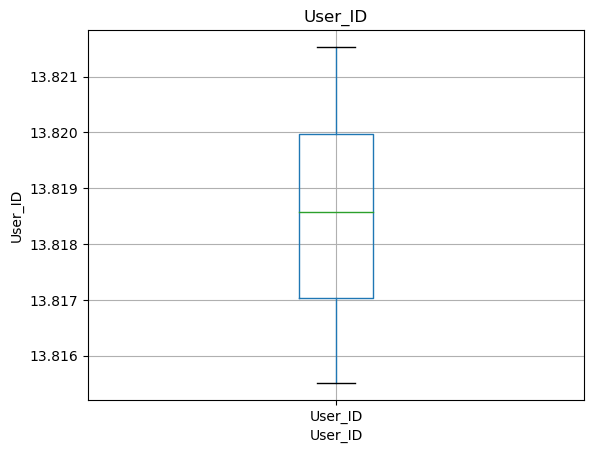

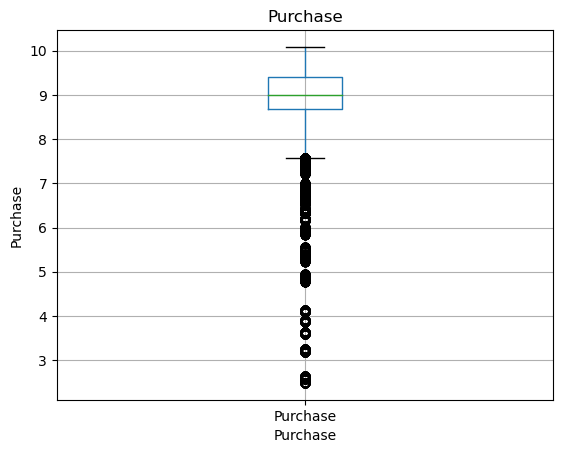

In [73]:
## Outliers
data=dataset.copy()


for feature in continuous_variables:
    
    if 0 in data[feature].unique():
        pass
    else:
        if data[feature].dtypes=='O':
            pass
        else:
            data[feature]=np.log(data[feature])
            data.boxplot(column=feature)
            plt.xlabel(feature)
            plt.ylabel(feature)
            plt.title(feature)
            plt.show()

<AxesSubplot:xlabel='Purchase', ylabel='Count'>

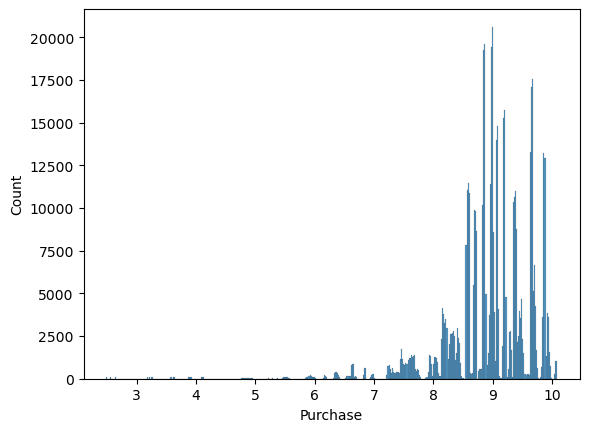

In [74]:
sns.histplot(data['Purchase'])

<AxesSubplot:xlabel='Purchase', ylabel='Count'>

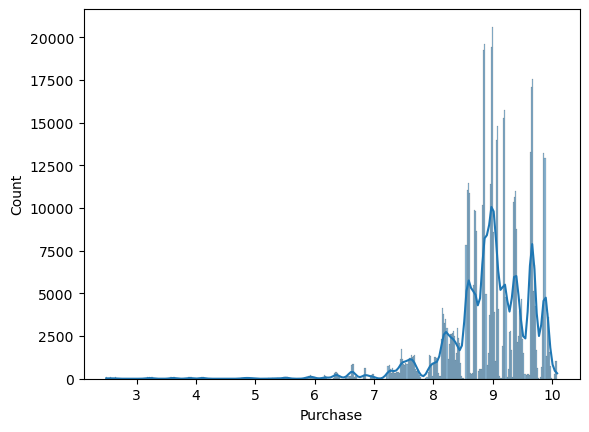

In [75]:
sns.histplot(data['Purchase'],kde=True)

## Categorical Variables

In [79]:
data=dataset.copy()
categorical_variables = [ feature for feature in data if data[feature].dtypes=='O' and feature not in datetime_variables]
categorical_variables

['Product_ID', 'Gender', 'City_Category']

In [80]:
data[categorical_variables]

,Product_ID,Gender,City_Category
0,P00069042,F,A
1,P00248942,F,A
2,P00087842,F,A
3,P00085442,F,A
4,P00285442,M,C
...,...,...,...
550063,P00372445,M,B
550064,P00375436,F,C
550065,P00375436,F,B
550066,P00375436,F,C


In [84]:
categorical_variables.remove('Product_ID')

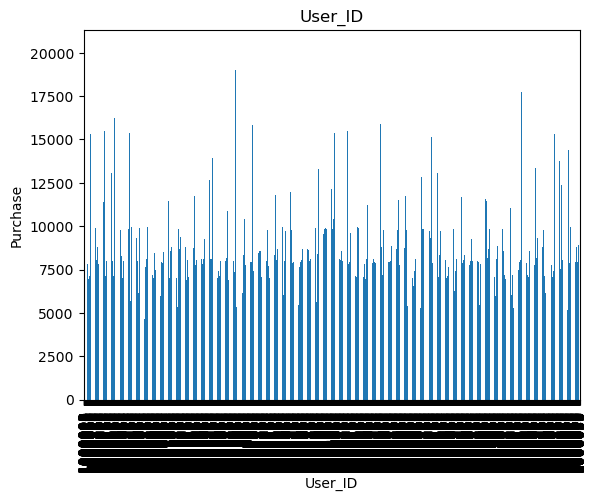

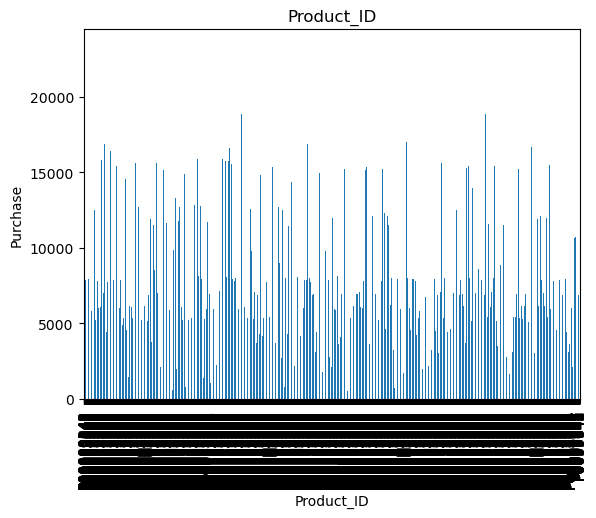

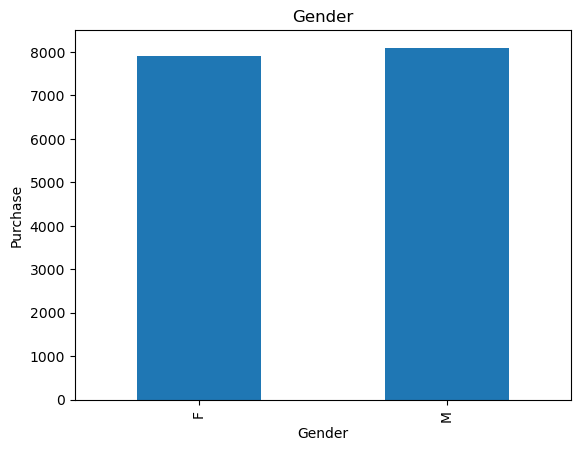

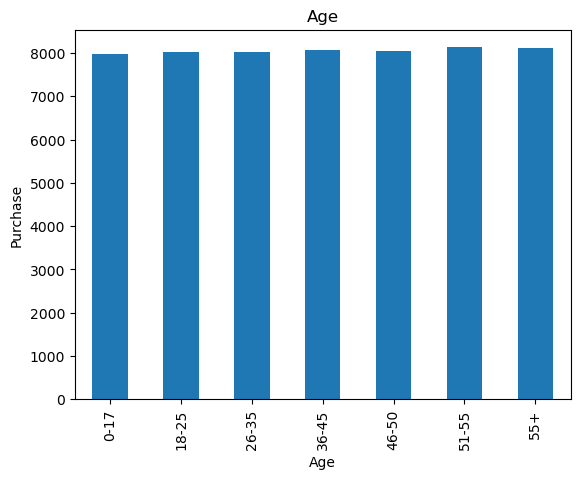

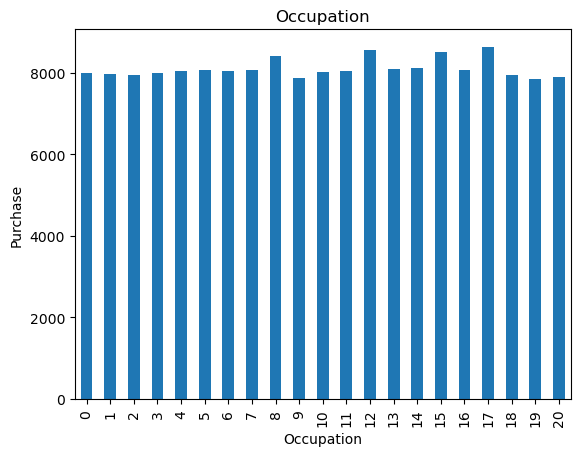

...

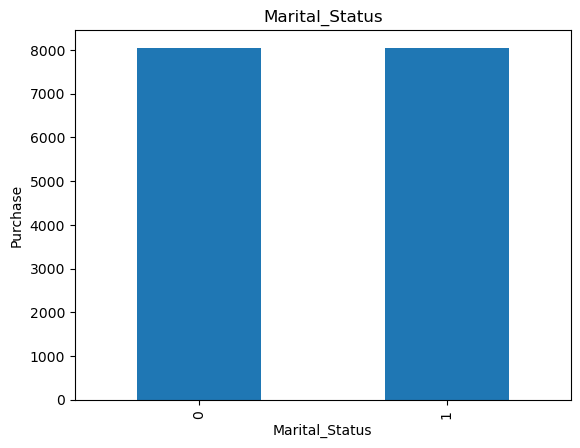

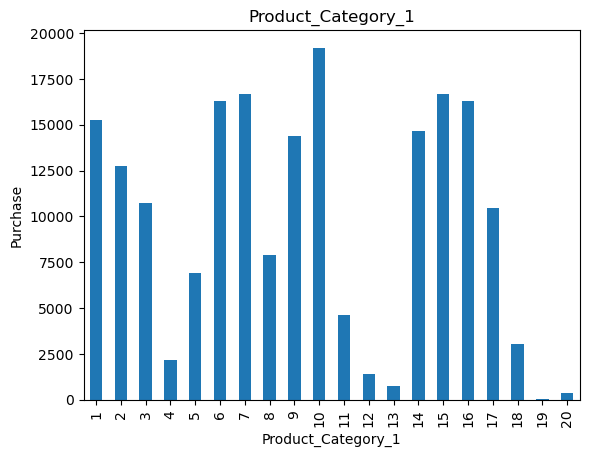

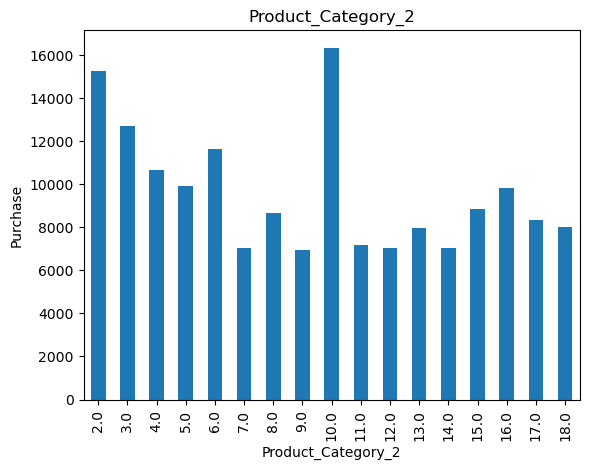

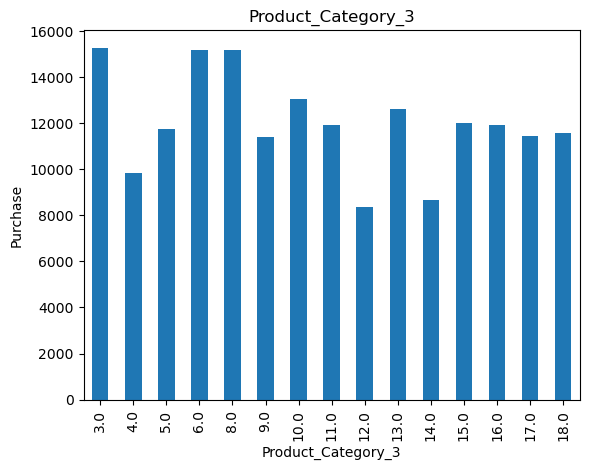

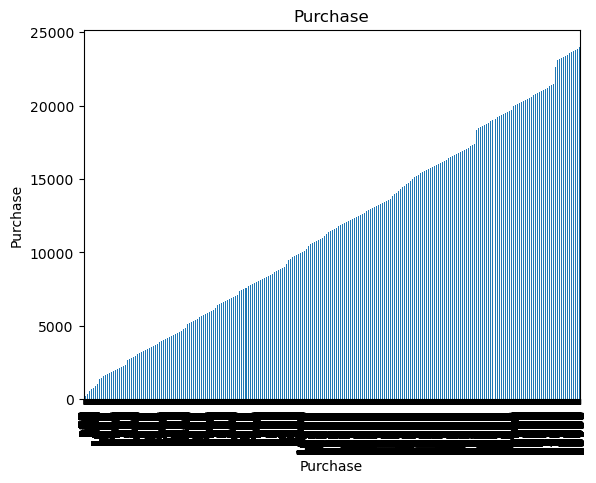

In [85]:
data=dataset.copy()
for feature in data:
    data.groupby(feature)['Purchase'].median().plot.bar()
    plt.xlabel(feature)
    plt.ylabel('Purchase')
    plt.title(feature)
    plt.show()